In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
from sklearn.model_selection import train_test_split,GridSearchCV
import statsmodels
import statsmodels.api as sm
from sklearn.preprocessing import StandardScaler,MinMaxScaler
from sklearn.metrics import classification_report,cohen_kappa_score,confusion_matrix,roc_curve,roc_auc_score,accuracy_score,f1_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn import tree
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import StackingClassifier

In [2]:
plt.rcParams['figure.figsize']=[15,8]

In [3]:
# Reading the dataset.
df=pd.read_csv(r"D:\College\DSE\Capstone Project\Dataset\UCI_Credit_Card.csv")
df.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,1,20000.0,2,2,1,24,2,2,-1,-1,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,2,120000.0,2,2,2,26,-1,2,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,3,90000.0,2,2,2,34,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,4,50000.0,2,2,1,37,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,5,50000.0,1,2,1,57,-1,0,-1,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


In [4]:
# Checking rows and columns in our data:-

df.shape

(30000, 25)

In [5]:
# Checking data types of our variables:-

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 25 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   ID                          30000 non-null  int64  
 1   LIMIT_BAL                   30000 non-null  float64
 2   SEX                         30000 non-null  int64  
 3   EDUCATION                   30000 non-null  int64  
 4   MARRIAGE                    30000 non-null  int64  
 5   AGE                         30000 non-null  int64  
 6   PAY_0                       30000 non-null  int64  
 7   PAY_2                       30000 non-null  int64  
 8   PAY_3                       30000 non-null  int64  
 9   PAY_4                       30000 non-null  int64  
 10  PAY_5                       30000 non-null  int64  
 11  PAY_6                       30000 non-null  int64  
 12  BILL_AMT1                   30000 non-null  float64
 13  BILL_AMT2                   300

In [6]:
# Pay_0 should ideally be named as Pay_1, so we will change the column name
df.rename(columns={'PAY_0':'PAY_1'}, inplace=True)
df.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,1,20000.0,2,2,1,24,2,2,-1,-1,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,2,120000.0,2,2,2,26,-1,2,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,3,90000.0,2,2,2,34,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,4,50000.0,2,2,1,37,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,5,50000.0,1,2,1,57,-1,0,-1,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


In [7]:
# Sex, Education, Marriage, Pay_1, Pay_2, Pay_3,Pay_4, Pay_5 are categorical columns, so, we will change their datatype
# Our target variable is also categorical (as this is a classification problem),so,we will change it to object as well

In [8]:
df['SEX'] = df['SEX'].astype(object)
df['EDUCATION'] = df['EDUCATION'].astype(object)
df['MARRIAGE'] = df['MARRIAGE'].astype(object)
df['PAY_1'] = df['PAY_1'].astype(object)
df['PAY_2'] = df['PAY_2'].astype(object)
df['PAY_3'] = df['PAY_3'].astype(object)
df['PAY_4'] = df['PAY_4'].astype(object)
df['PAY_5'] = df['PAY_5'].astype(object)
df['PAY_6'] = df['PAY_6'].astype(object)
df['default.payment.next.month'] = df['default.payment.next.month'].astype(object)

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 25 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   ID                          30000 non-null  int64  
 1   LIMIT_BAL                   30000 non-null  float64
 2   SEX                         30000 non-null  object 
 3   EDUCATION                   30000 non-null  object 
 4   MARRIAGE                    30000 non-null  object 
 5   AGE                         30000 non-null  int64  
 6   PAY_1                       30000 non-null  object 
 7   PAY_2                       30000 non-null  object 
 8   PAY_3                       30000 non-null  object 
 9   PAY_4                       30000 non-null  object 
 10  PAY_5                       30000 non-null  object 
 11  PAY_6                       30000 non-null  object 
 12  BILL_AMT1                   30000 non-null  float64
 13  BILL_AMT2                   300

In [10]:
df.describe()

,ID,LIMIT_BAL,AGE,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
count,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,3.000000e+04,30000.000000,30000.000000,30000.000000,30000.000000,3.000000e+04,30000.00000,30000.000000,30000.000000,30000.000000
mean,15000.500000,167484.322667,35.485500,51223.330900,49179.075167,4.701315e+04,43262.948967,40311.400967,38871.760400,5663.580500,5.921163e+03,5225.68150,4826.076867,4799.387633,5215.502567
std,8660.398374,129747.661567,9.217904,73635.860576,71173.768783,6.934939e+04,64332.856134,60797.155770,59554.107537,16563.280354,2.304087e+04,17606.96147,15666.159744,15278.305679,17777.465775
min,1.000000,10000.000000,21.000000,-165580.000000,-69777.000000,-1.572640e+05,-170000.000000,-81334.000000,-339603.000000,0.000000,0.000000e+00,0.00000,0.000000,0.000000,0.000000
25%,7500.750000,50000.000000,28.000000,3558.750000,2984.750000,2.666250e+03,2326.750000,1763.000000,1256.000000,1000.000000,8.330000e+02,390.00000,296.000000,252.500000,117.750000
50%,15000.500000,140000.000000,34.000000,22381.500000,21200.000000,2.008850e+04,19052.000000,18104.500000,17071.000000,2100.000000,2.009000e+03,1800.00000,1500.000000,1500.000000,1500.000000
75%,22500.250000,240000.000000,41.000000,67091.000000,64006.250000,6.016475e+04,54506.000000,50190.500000,49198.250000,5006.000000,5.000000e+03,4505.00000,4013.250000,4031.500000,4000.000000
max,30000.000000,1000000.000000,79.000000,964511.000000,983931.000000,1.664089e+06,891586.000000,927171.000000,961664.000000,873552.000000,1.684259e+06,896040.00000,621000.000000,426529.000000,528666.000000


1. The above suggests the presence of outliers in all the columns except age
2. The columns BILL_AMT1-BILL_AMT6 contain negative values, indicating that some customers have overpaid their previous bills. 

In [11]:
df.describe(include=object)

,SEX,EDUCATION,MARRIAGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,default.payment.next.month
count,30000,30000,30000,30000,30000,30000,30000,30000,30000,30000
unique,2,7,4,11,11,11,11,10,10,2
top,2,2,2,0,0,0,0,0,0,0
freq,18112,14030,15964,14737,15730,15764,16455,16947,16286,23364


In [ ]:
# Finding each category of the categorical variables:
cat_cols = df.select_dtypes(include=object)

In [13]:
for i in cat_cols:
    print(df[i].value_counts())

2    18112
1    11888
Name: SEX, dtype: int64
2    14030
1    10585
3     4917
5      280
4      123
6       51
0       14
Name: EDUCATION, dtype: int64
2    15964
1    13659
3      323
0       54
Name: MARRIAGE, dtype: int64
 0    14737
-1     5686
 1     3688
-2     2759
 2     2667
 3      322
 4       76
 5       26
 8       19
 6       11
 7        9
Name: PAY_1, dtype: int64
 0    15730
-1     6050
 2     3927
-2     3782
 3      326
 4       99
 1       28
 5       25
 7       20
 6       12
 8        1
Name: PAY_2, dtype: int64
 0    15764
-1     5938
-2     4085
 2     3819
 3      240
 4       76
 7       27
 6       23
 5       21
 1        4
 8        3
Name: PAY_3, dtype: int64
 0    16455
-1     5687
-2     4348
 2     3159
 3      180
 4       69
 7       58
 5       35
 6        5
 8        2
 1        2
Name: PAY_4, dtype: int64
 0    16947
-1     5539
-2     4546
 2     2626
 3      178
 4       84
 7       58
 5       17
 6        4
 8        1
Name: PAY_5, dtype: in

1. In EDUCATION column, a total of only 1.39% values are present under the 'unknown' categories (categories 0, 5 and 6).
2. In our target variable, 77.87% (or customers) are non defaulters and 22.12% (customers) are defaulters.
3. In the PAY columns, maximum customers are using revolving credit (category 0).

In [14]:
# Checking for null values in data.

df.isnull().sum()

# There are no missing values

ID                            0
LIMIT_BAL                     0
SEX                           0
EDUCATION                     0
MARRIAGE                      0
AGE                           0
PAY_1                         0
PAY_2                         0
PAY_3                         0
PAY_4                         0
PAY_5                         0
PAY_6                         0
BILL_AMT1                     0
BILL_AMT2                     0
BILL_AMT3                     0
BILL_AMT4                     0
BILL_AMT5                     0
BILL_AMT6                     0
PAY_AMT1                      0
PAY_AMT2                      0
PAY_AMT3                      0
PAY_AMT4                      0
PAY_AMT5                      0
PAY_AMT6                      0
default.payment.next.month    0
dtype: int64

In [15]:
# Checking for duplicates:

df_duplicate = df[df.duplicated(keep='last')]
df_duplicate

# We see that there are no duplicates

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month


In [16]:
# Id column is redundant, so we will drop it
df = df.drop(columns = 'ID',axis=1)
df.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,20000.0,2,2,1,24,2,2,-1,-1,-2,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,120000.0,2,2,2,26,-1,2,0,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,90000.0,2,2,2,34,0,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,50000.0,2,2,1,37,0,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,50000.0,1,2,1,57,-1,0,-1,0,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


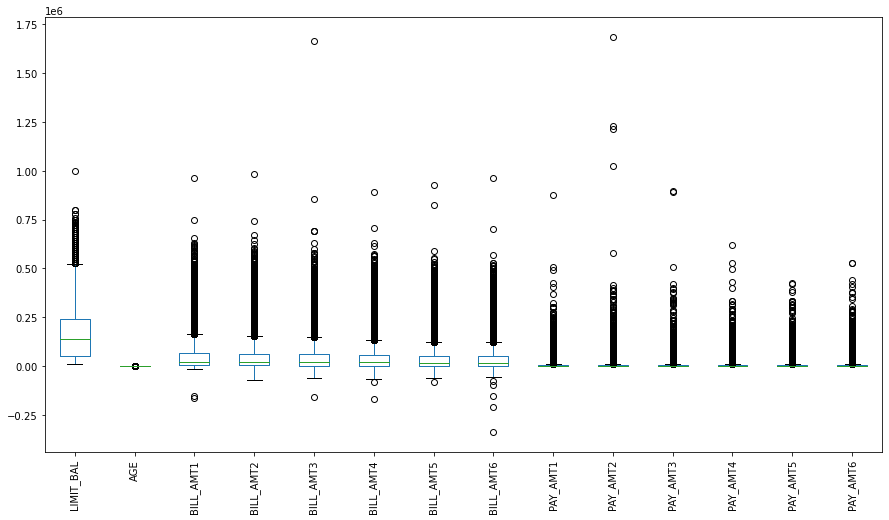

In [17]:
# Checking for outliers in data.

df.select_dtypes(np.number).plot(kind='box')
plt.xticks(rotation=90)
plt.show()

In [ ]:
We cannot apply the iqr method for treating outliers. A credit card dataset having many outliers is a normal occurance in real life scenarios. So, in this case we will have to examine each column separately and any unusual values will have to be treated as missing values.

In [18]:
q1 = df['LIMIT_BAL'].quantile(0.25)
q3 = df["LIMIT_BAL"].quantile(0.75)
iqr = q3-q1
ul = q3+1.5*iqr
ll = q1-1.5*iqr
df['LIMIT_BAL'][(df['LIMIT_BAL'] > ul)].sort_values(ascending = False)

2197     1000000.0
18006     800000.0
14919     800000.0
28715     780000.0
24320     780000.0
           ...    
27258     530000.0
20944     530000.0
3258      530000.0
27575     530000.0
5625      530000.0
Name: LIMIT_BAL, Length: 167, dtype: float64

In [19]:
df['LIMIT_BAL'][(df['LIMIT_BAL'] < ll)].sort_values(ascending = False)

Series([], Name: LIMIT_BAL, dtype: float64)

In [20]:
df['LIMIT_BAL'][~((df['LIMIT_BAL']>ul)|(df['LIMIT_BAL']<ll))].sort_values(ascending = False)

19790    520000.0
15075    520000.0
15353    520000.0
9027     520000.0
23445    520000.0
           ...   
4006      10000.0
22420     10000.0
28081     10000.0
16190     10000.0
22773     10000.0
Name: LIMIT_BAL, Length: 29833, dtype: float64

In [21]:
# Range of normal values: 10000-520000
# Range of outliers: 530000-1000000
# No inliers present

# Inference: we can take q3+1.5*iqr and q3+3*iqr as two upper limits for filtering outliers and build two models. We can go with the upper limit with which model will perform better.
# (When using q3+3*iqr as the upper limit, 1000000 will be the only outlier)

In [22]:
q1 = df['BILL_AMT1'].quantile(0.25)
q3 = df["BILL_AMT1"].quantile(0.75)
iqr = q3-q1
ul = q3+1.5*iqr
ll = q1-1.5*iqr
df['BILL_AMT1'][(df['BILL_AMT1'] > ul)].sort_values(ascending = False)

2197     964511.0
27557    746814.0
26547    653062.0
6912     630458.0
28142    626648.0
           ...   
11841    162526.0
5262     162518.0
7099     162500.0
6721     162452.0
24183    162439.0
Name: BILL_AMT1, Length: 2398, dtype: float64

In [23]:
df['BILL_AMT1'][(df['BILL_AMT1'] < ll)].sort_values(ascending = False)

23003   -154973.0
12330   -165580.0
Name: BILL_AMT1, dtype: float64

In [24]:
df['BILL_AMT1'][~((df['BILL_AMT1']>ul)|(df['BILL_AMT1']<ll))].sort_values(ascending = False)

16424    162296.0
8035     162241.0
14448    162118.0
22933    162110.0
1046     162105.0
           ...   
4635      -9802.0
27465    -10682.0
29779    -11545.0
351      -14386.0
8835     -15308.0
Name: BILL_AMT1, Length: 27600, dtype: float64

In [25]:
# Range of normal values: -15308 - 162296
# Range of outliers: 162439 - 964511
# Range of inliers: -165580 - -154973

# Inference: The inliers are too far from the lowest value, so removing them will be a better treatment.
# Outliers: We can take q3+3*iqr as the upper limit for all the BILL_AMT columns for a value to be considered as an outlier as it will give a better range of values to work with
# This strategy can be used for all the BILL_AMT columns as they all have a similar range for normal values and outliers.

In [26]:
q1 = df['BILL_AMT2'].quantile(0.25)
q3 = df["BILL_AMT2"].quantile(0.75)
iqr = q3-q1
ul = q3+1.5*iqr
ll = q1-1.5*iqr
df['BILL_AMT2'][(df['BILL_AMT2'] > ul)].sort_values(ascending = False)

2197     983931.0
19748    743970.0
26547    671563.0
6912     646770.0
26227    624475.0
           ...   
27476    155698.0
29588    155697.0
1462     155693.0
16221    155658.0
15463    155635.0
Name: BILL_AMT2, Length: 2395, dtype: float64

In [27]:
df['BILL_AMT2'][(df['BILL_AMT2'] < ll)].sort_values(ascending = False)

Series([], Name: BILL_AMT2, dtype: float64)

In [28]:
df['BILL_AMT2'][~((df['BILL_AMT2']>ul)|(df['BILL_AMT2']<ll))].sort_values(ascending = False)

22871    155508.0
3887     155438.0
9175     155421.0
15058    155392.0
4296     155371.0
           ...   
19366    -26214.0
4439     -30000.0
8835     -33350.0
25862    -67526.0
21729    -69777.0
Name: BILL_AMT2, Length: 27605, dtype: float64

In [29]:
# Range of normal values: -69777 - 155508
# Range of outliers: 155635 - 983931
# No inliers

In [30]:
q1 = df['BILL_AMT3'].quantile(0.25)
q3 = df["BILL_AMT3"].quantile(0.75)
iqr = q3-q1
ul = q3+1.5*iqr
ll = q1-1.5*iqr
df['BILL_AMT3'][(df['BILL_AMT3'] > ul)].sort_values(ascending = False)

5296     1664089.0
25731     855086.0
6912      693131.0
26593     689643.0
26547     689627.0
           ...    
1839      146534.0
8249      146529.0
8428      146509.0
6328      146487.0
20441     146464.0
Name: BILL_AMT3, Length: 2468, dtype: float64

In [31]:
df[df['BILL_AMT3']==1664089.0]


,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
5296,500000.0,2,1,1,33,-2,-2,-1,-1,-2,...,121757.0,97115.0,377217.0,4366.0,1684259.0,121831.0,97670.0,379267.0,26759.0,0


In [32]:
df['BILL_AMT3'][(df['BILL_AMT3'] < ll)].sort_values(ascending = False)

18115   -157264.0
Name: BILL_AMT3, dtype: float64

In [33]:
df['BILL_AMT3'][~((df['BILL_AMT3']>ul)|(df['BILL_AMT3']<ll))].sort_values(ascending = False)

6380     146410.0
8488     146396.0
6225     146277.0
24724    146245.0
22511    146193.0
           ...   
27271    -24702.0
21235    -25443.0
8347     -34041.0
29491    -46127.0
18876    -61506.0
Name: BILL_AMT3, Length: 27531, dtype: float64

In [34]:
# Range of normal values: -61506 - 146410
# Range of outliers: 146464 - 1664089
# Range of inliers: - 157264

In [35]:
q1 = df['BILL_AMT4'].quantile(0.25)
q3 = df["BILL_AMT4"].quantile(0.75)
iqr = q3-q1
ul = q3+1.5*iqr
ll = q1-1.5*iqr
df['BILL_AMT4'][(df['BILL_AMT4'] > ul)].sort_values(ascending = False)

2197     891586.0
26547    706864.0
40       628699.0
24118    616836.0
20892    572805.0
           ...   
22631    132866.0
25683    132852.0
26170    132809.0
12019    132806.0
6431     132792.0
Name: BILL_AMT4, Length: 2620, dtype: float64

In [36]:
df['BILL_AMT4'][(df['BILL_AMT4'] < ll)].sort_values(ascending = False)

8355    -81334.0
3183   -170000.0
Name: BILL_AMT4, dtype: float64

In [37]:
df['BILL_AMT4'][~((df['BILL_AMT4']>ul)|(df['BILL_AMT4']<ll))].sort_values(ascending = False)

6159     132754.0
17074    132731.0
27439    132703.0
22320    132683.0
20602    132677.0
           ...   
27327    -27490.0
8347     -34503.0
21235    -46627.0
29491    -50616.0
24856    -65167.0
Name: BILL_AMT4, Length: 27378, dtype: float64

In [38]:
# Range of normal values: -65167 - 132754
# Range of outliers: 132792 - 891586
# Range of inliers: -170000.0 - -81334.0

In [39]:
q1 = df['BILL_AMT5'].quantile(0.25)
q3 = df["BILL_AMT5"].quantile(0.75)
iqr = q3-q1
ul = q3+1.5*iqr
ll = q1-1.5*iqr
df['BILL_AMT5'][(df['BILL_AMT5'] > ul)].sort_values(ascending = False)

2197     927171.0
20892    823540.0
28405    587067.0
8229     551702.0
13782    547880.0
           ...   
27580    122963.0
4152     122955.0
16283    122948.0
29748    122948.0
17119    122914.0
Name: BILL_AMT5, Length: 2724, dtype: float64

In [40]:
df['BILL_AMT5'][(df['BILL_AMT5'] < ll)].sort_values(ascending = False)

23326   -81334.0
Name: BILL_AMT5, dtype: float64

In [41]:
df['BILL_AMT5'][~((df['BILL_AMT5']>ul)|(df['BILL_AMT5']<ll))].sort_values(ascending = False)

26282    122830.0
14448    122755.0
27079    122740.0
4221     122664.0
1326     122657.0
           ...   
17970    -36156.0
14548    -37594.0
21235    -46627.0
29491    -53007.0
26670    -61372.0
Name: BILL_AMT5, Length: 27275, dtype: float64

In [42]:
# Range of normal values: -61372 - 122830
# Range of outliers: 122914 - 927171
# Range of inliers: -81334

In [43]:
q1 = df['BILL_AMT6'].quantile(0.25)
q3 = df["BILL_AMT6"].quantile(0.75)
iqr = q3-q1
ul = q3+1.5*iqr
ll = q1-1.5*iqr
df['BILL_AMT6'][(df['BILL_AMT6'] > ul)].sort_values(ascending = False)

2197     961664.0
1508     699944.0
8229     568638.0
1992     527711.0
5035     527566.0
           ...   
25553    121191.0
8026     121179.0
22789    121178.0
24221    121162.0
18866    121118.0
Name: BILL_AMT6, Length: 2688, dtype: float64

In [44]:
df['BILL_AMT6'][(df['BILL_AMT6'] < ll)].sort_values(ascending = False)

28919    -73895.0
29491    -94625.0
12828   -150953.0
26097   -209051.0
290     -339603.0
Name: BILL_AMT6, dtype: float64

In [45]:
df['BILL_AMT6'][~((df['BILL_AMT6']>ul)|(df['BILL_AMT6']<ll))].sort_values(ascending = False)

6931     121062.0
13112    121028.0
17136    121027.0
10297    120940.0
1706     120937.0
           ...   
5548     -45734.0
21235    -46627.0
3525     -51183.0
12388    -51443.0
27080    -57060.0
Name: BILL_AMT6, Length: 27307, dtype: float64

In [46]:
# Range of normal values: -57060 - 121062
# Range of outliers: 121118 - 961664
# Range of inliers: -339603 - -73895

In [47]:
q1 = df['PAY_AMT1'].quantile(0.25)
q3 = df["PAY_AMT1"].quantile(0.75)
iqr = q3-q1
ul = q3+1.5*iqr
ll = q1-1.5*iqr
df['PAY_AMT1'][(df['PAY_AMT1'] > ul)].sort_values(ascending = False)

28716    873552.0
12330    505000.0
28003    493358.0
29820    423903.0
8500     405016.0
           ...   
28293     11021.0
20791     11021.0
14726     11019.0
10787     11019.0
4360      11016.0
Name: PAY_AMT1, Length: 2745, dtype: float64

In [48]:
df['PAY_AMT1'][(df['PAY_AMT1'] < ll)].sort_values(ascending = False)

Series([], Name: PAY_AMT1, dtype: float64)

In [49]:
df['PAY_AMT1'][~((df['PAY_AMT1']>ul)|(df['PAY_AMT1']<ll))].sort_values(ascending = False)

9055     11013.0
11685    11012.0
6779     11011.0
3038     11009.0
28832    11007.0
          ...   
12906        0.0
12912        0.0
12913        0.0
12914        0.0
0            0.0
Name: PAY_AMT1, Length: 27255, dtype: float64

In [50]:
q1 = df['PAY_AMT1'].quantile(0.25)
q3 = df["PAY_AMT1"].quantile(0.75)
iqr = q3-q1
ul = q3+3*iqr
ll = q1-3*iqr
df['PAY_AMT1'][(df['PAY_AMT1'] > ul)].sort_values(ascending = False)

28716    873552.0
12330    505000.0
28003    493358.0
29820    423903.0
8500     405016.0
           ...   
22718     17094.0
5625      17045.0
12328     17035.0
15552     17029.0
28473     17029.0
Name: PAY_AMT1, Length: 1629, dtype: float64

In [51]:
df['PAY_AMT1'][(df['PAY_AMT1'] > ul)].sort_values(ascending = False).quantile(0.95)

150000.0

In [52]:
# Range of normal values: 0 - 11013
# Range of outliers: 11016 - 873552
# No inliers

# Inference: When we take q3+3*iqr as the upper limit, the lower value for the outliers does not show a very significant shift from that when q3+1.5*iqr is the upper limit
# It indicates there might be some extreme values, so we can give a suitable cutoff for deciding outliers
# As we can see from above that 95% of the values of the columns are below 150000. So, we can take this as our cutoff for outliers.

In [53]:
q1 = df['PAY_AMT2'].quantile(0.25)
q3 = df["PAY_AMT2"].quantile(0.75)
iqr = q3-q1
ul = q3+1.5*iqr
ll = q1-1.5*iqr
df['PAY_AMT2'][(df['PAY_AMT2'] > ul)].sort_values(ascending = False)

5296     1684259.0
28003    1227082.0
28716    1215471.0
25731    1024516.0
14513     580464.0
           ...    
6769       11279.0
1598       11263.0
19851      11261.0
19187      11254.0
1199       11253.0
Name: PAY_AMT2, Length: 2714, dtype: float64

In [54]:
df['PAY_AMT2'][(df['PAY_AMT2'] < ll)].sort_values(ascending = False)

Series([], Name: PAY_AMT2, dtype: float64)

In [55]:
df['PAY_AMT2'][~((df['PAY_AMT2']>ul)|(df['PAY_AMT2']<ll))].sort_values(ascending = False)

18361    11249.0
28499    11247.0
4405     11244.0
19902    11242.0
8049     11237.0
          ...   
4868         0.0
10287        0.0
18484        0.0
18487        0.0
25910        0.0
Name: PAY_AMT2, Length: 27286, dtype: float64

In [56]:
q1 = df['PAY_AMT2'].quantile(0.25)
q3 = df["PAY_AMT2"].quantile(0.75)
iqr = q3-q1
ul = q3+3*iqr
ll = q1-3*iqr
df['PAY_AMT2'][(df['PAY_AMT2'] > ul)].sort_values(ascending = False)

5296     1684259.0
28003    1227082.0
28716    1215471.0
25731    1024516.0
14513     580464.0
           ...    
8776       17563.0
1834       17560.0
6684       17552.0
18287      17546.0
23799      17512.0
Name: PAY_AMT2, Length: 1638, dtype: float64

In [57]:
df['PAY_AMT2'][(df['PAY_AMT2'] > ul)].sort_values(ascending = False).quantile(0.95)

166311.34999999992

In [58]:
# Range of normal values: 0 - 11249
# Range of outliers: 11253 - 1684259
# No inliers

# Inference: We see above that there are some extreme values on the upper whisker.
# We can draw similar inferences for this column as the previous pay column (95% values lie below 166050 - which is not far from the 0.95 quantile for the previous column (150000))
# Hence, same strategy can be used for all the pay columns.

In [59]:
q1 = df['PAY_AMT3'].quantile(0.25)
q3 = df["PAY_AMT3"].quantile(0.75)
iqr = q3-q1
ul = q3+1.5*iqr
ll = q1-1.5*iqr
df['PAY_AMT3'][(df['PAY_AMT3'] > ul)].sort_values(ascending = False)

2197     896040.0
28716    889043.0
27440    508229.0
7297     417588.0
28743    400972.0
           ...   
23578     10700.0
28357     10700.0
13522     10696.0
9556      10694.0
19986     10692.0
Name: PAY_AMT3, Length: 2598, dtype: float64

In [60]:
df['PAY_AMT3'][(df['PAY_AMT3'] < ll)].sort_values(ascending = False)

Series([], Name: PAY_AMT3, dtype: float64)

In [61]:
df['PAY_AMT3'][~((df['PAY_AMT3']>ul)|(df['PAY_AMT3']<ll))].sort_values(ascending = False)

14673    10673.0
26144    10668.0
1058     10662.0
21569    10661.0
19591    10658.0
          ...   
12900        0.0
12899        0.0
12894        0.0
12884        0.0
0            0.0
Name: PAY_AMT3, Length: 27402, dtype: float64

In [62]:
# Range of normal values: 0 - 10673
# Range of outliers: 10692- 896040
# No inliers

In [63]:
q1 = df['PAY_AMT4'].quantile(0.25)
q3 = df["PAY_AMT4"].quantile(0.75)
iqr = q3-q1
ul = q3+1.5*iqr
ll = q1-1.5*iqr
df['PAY_AMT4'][(df['PAY_AMT4'] > ul)].sort_values(ascending = False)

28716    621000.0
24686    528897.0
3183     497000.0
14553    432130.0
11557    400046.0
           ...   
23075      9600.0
7093       9600.0
18432      9600.0
10417      9594.0
5239       9590.0
Name: PAY_AMT4, Length: 2994, dtype: float64

In [64]:
df['PAY_AMT4'][(df['PAY_AMT4'] < ll)].sort_values(ascending = False)

Series([], Name: PAY_AMT4, dtype: float64)

In [65]:
df['PAY_AMT4'][~((df['PAY_AMT4']>ul)|(df['PAY_AMT4']<ll))].sort_values(ascending = False)

19972    9584.0
1952     9579.0
8694     9579.0
23218    9577.0
1937     9576.0
          ...  
7608        0.0
20563       0.0
20562       0.0
20559       0.0
0           0.0
Name: PAY_AMT4, Length: 27006, dtype: float64

In [66]:
# Range of normal values: 0 - 9584
# Range of outliers: 9590 - 621000
# No inliers

In [67]:
q1 = df['PAY_AMT5'].quantile(0.25)
q3 = df["PAY_AMT5"].quantile(0.75)
iqr = q3-q1
ul = q3+1.5*iqr
ll = q1-1.5*iqr
df['PAY_AMT5'][(df['PAY_AMT5'] > ul)].sort_values(ascending = False)

28037    426529.0
13186    417990.0
10995    388071.0
5296     379267.0
1261     332000.0
           ...   
3923       9744.0
12179      9733.0
25151      9722.0
23831      9718.0
1518       9701.0
Name: PAY_AMT5, Length: 2945, dtype: float64

In [68]:
df['PAY_AMT5'][(df['PAY_AMT5'] < ll)].sort_values(ascending = False)

Series([], Name: PAY_AMT5, dtype: float64)

In [69]:
df['PAY_AMT5'][~((df['PAY_AMT5']>ul)|(df['PAY_AMT5']<ll))].sort_values(ascending = False)

11156    9700.0
15628    9699.0
22321    9675.0
7837     9672.0
29150    9662.0
          ...  
20425       0.0
7646        0.0
7649        0.0
7650        0.0
0           0.0
Name: PAY_AMT5, Length: 27055, dtype: float64

In [70]:
# Range of normal values: 0 - 9700
# Range of outliers: 9701 - 426529
# No inliers

In [71]:
q1 = df['PAY_AMT6'].quantile(0.25)
q3 = df["PAY_AMT6"].quantile(0.75)
iqr = q3-q1
ul = q3+1.5*iqr
ll = q1-1.5*iqr
df['PAY_AMT6'][(df['PAY_AMT6'] > ul)].sort_values(ascending = False)

506      528666.0
14511    527143.0
28629    443001.0
22850    422000.0
4891     403500.0
           ...   
24283      9855.0
16665      9844.0
4606       9844.0
2333       9840.0
5605       9832.0
Name: PAY_AMT6, Length: 2958, dtype: float64

In [72]:
df['PAY_AMT6'][(df['PAY_AMT6'] < ll)].sort_values(ascending = False)

Series([], Name: PAY_AMT6, dtype: float64)

In [73]:
df['PAY_AMT6'][~((df['PAY_AMT6']>ul)|(df['PAY_AMT6']<ll))].sort_values(ascending = False)

13015    9817.0
2452     9816.0
17922    9800.0
24583    9800.0
25570    9800.0
          ...  
13492       0.0
13485       0.0
13484       0.0
13479       0.0
0           0.0
Name: PAY_AMT6, Length: 27042, dtype: float64

In [74]:
# Range of normal values: 0 - 9817
# Range of outliers: 9832 - 528666
# No inliers

In [75]:
q1 = df['AGE'].quantile(0.25)
q3 = df["AGE"].quantile(0.75)
iqr = q3-q1
ul = q3+1.5*iqr
ll = q1-1.5*iqr
df['AGE'][(df['AGE'] > ul)].sort_values(ascending = False)

18245    79
246      75
25136    75
25141    75
29175    74
         ..
7177     61
18176    61
17779    61
17758    61
6530     61
Name: AGE, Length: 272, dtype: int64

In [76]:
df['AGE'][(df['AGE'] < ll)].sort_values(ascending = False)

Series([], Name: AGE, dtype: int64)

In [77]:
df['AGE'][~((df['AGE']>ul)|(df['AGE']<ll))].sort_values(ascending = False)

25108    60
2675     60
14133    60
20329    60
17732    60
         ..
18342    21
18341    21
16988    21
2212     21
21720    21
Name: AGE, Length: 29728, dtype: int64

In [78]:
# Range of normal values: 21 - 60
# Range of outliers: 61 - 79
# No inliers

# The outlier values in age column are normal for a real life scenario, so we should not drop these outliers.

## Univariate Analysis 

#### Numerical Variables:-

In [79]:
num_cols=df.select_dtypes(include=np.number).columns
num_cols

Index(['LIMIT_BAL', 'AGE', 'BILL_AMT1', 'BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4',
       'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1', 'PAY_AMT2', 'PAY_AMT3',
       'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6'],
      dtype='object')

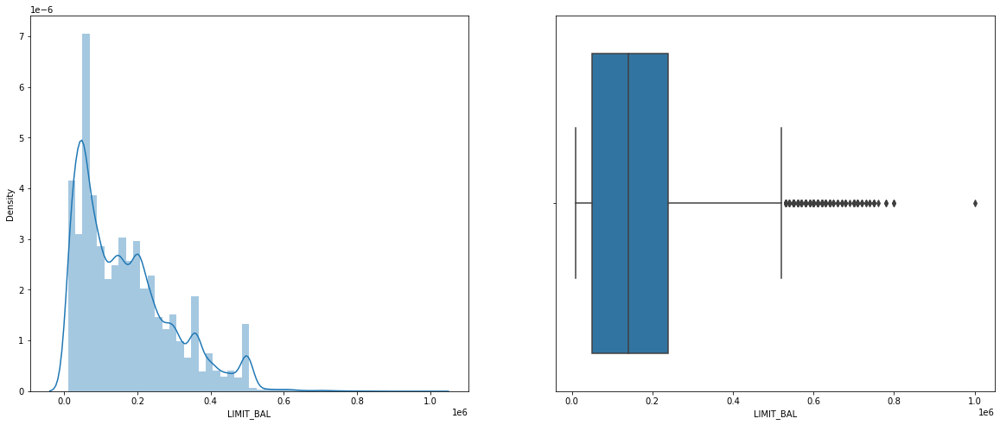

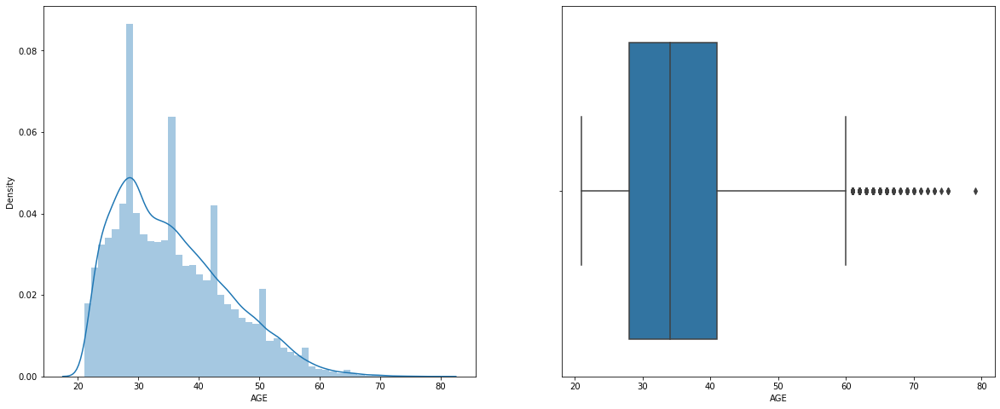

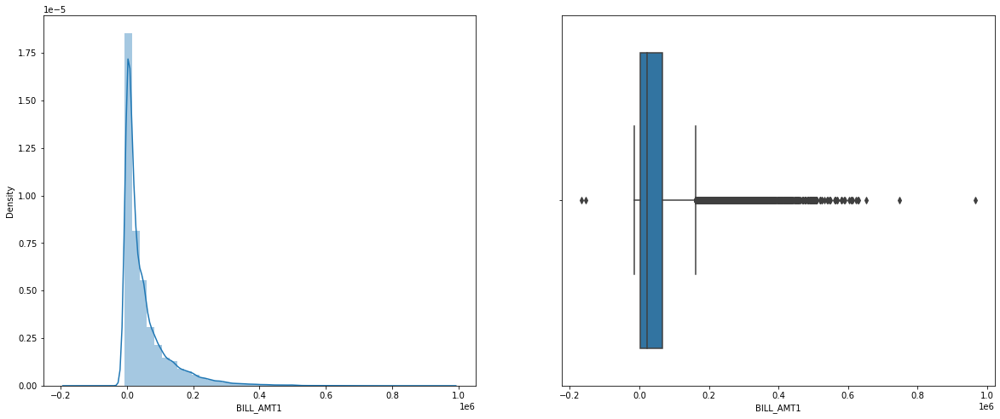

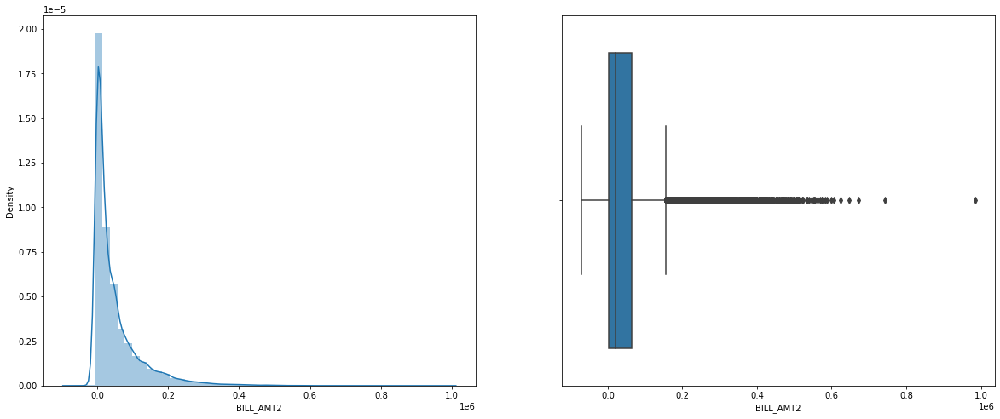

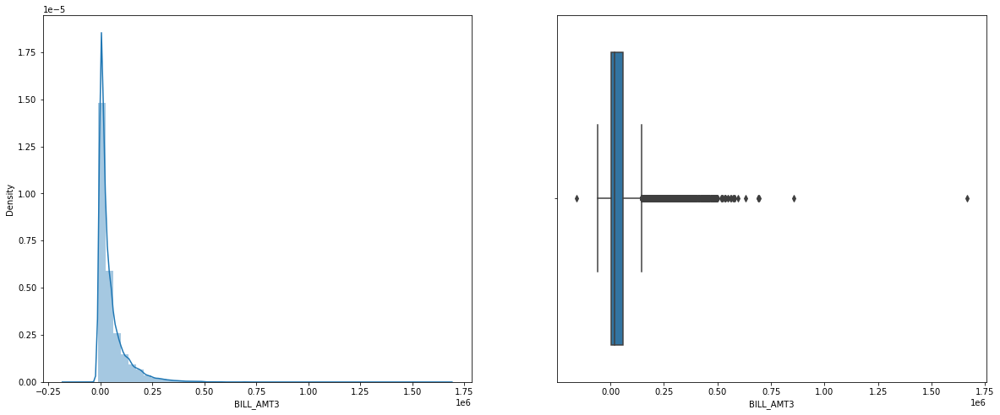

...

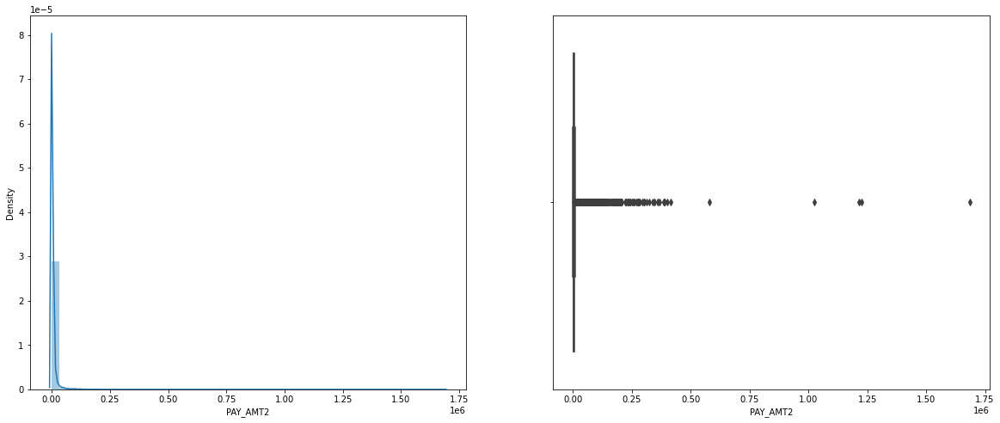

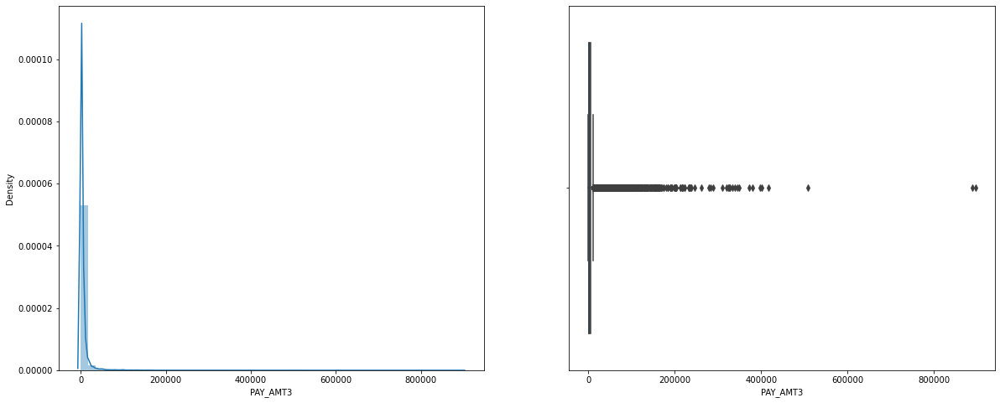

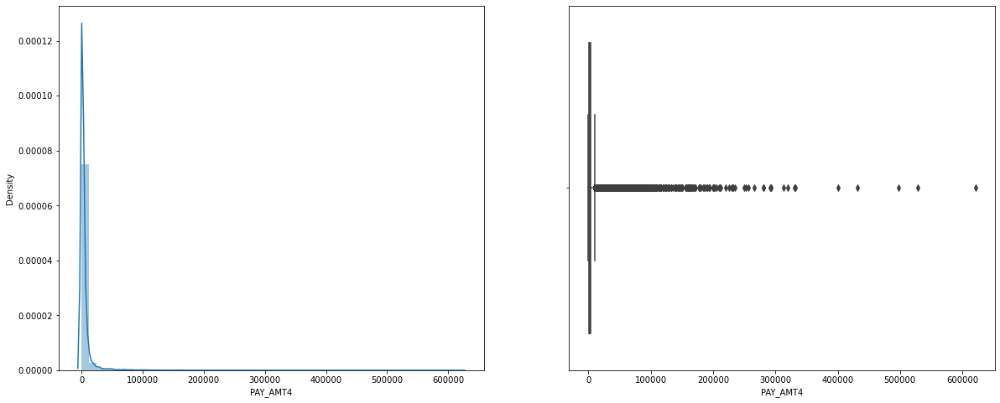

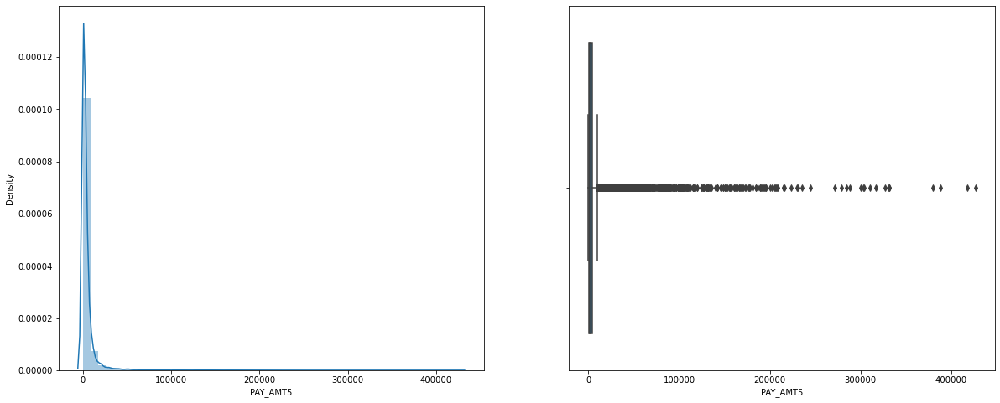

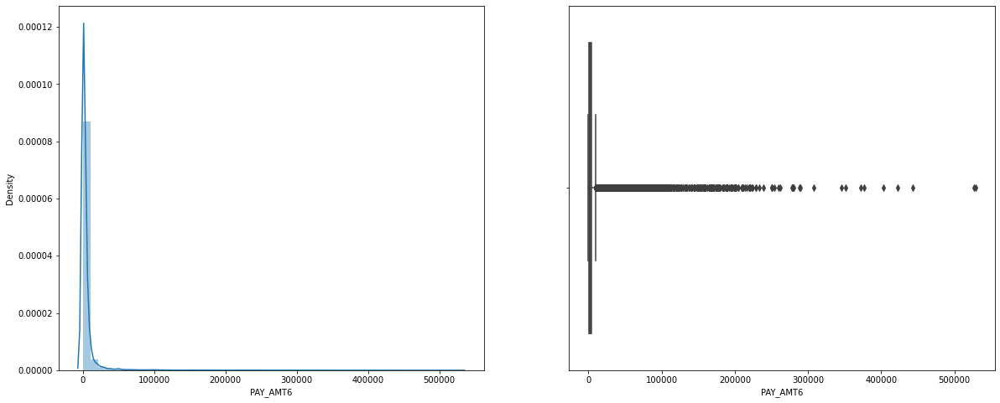

In [80]:
for i in num_cols:
    plt.figure(figsize=[20,8])
    plt.subplot(1,2,1)
    sns.distplot(df[i])
    plt.subplot(1,2,2)
    sns.boxplot(df[i])
    plt.show()

1. LIMIT_BAL column is right skewed and the boxplot shows the presence of outliers.
2. AGE column shows slight skewness on the right side. Fewer outliers are present when compared to other columns.
3. BILL_AMTX columns are highly right skewed. Most of the observations are concentrated around 0. Boxplots show the presence of numerous outliers.
4. The PAT_AMTX columns show the highest skewness amongst all the columns. Most of the values are 0 in this columns. This results in right skewness and the boxplots show the presence of outliers.

#### Categorical Variables:-

In [81]:
cat_cols=df.select_dtypes(include = object).columns
cat_cols

Index(['SEX', 'EDUCATION', 'MARRIAGE', 'PAY_1', 'PAY_2', 'PAY_3', 'PAY_4',
       'PAY_5', 'PAY_6', 'default.payment.next.month'],
      dtype='object')

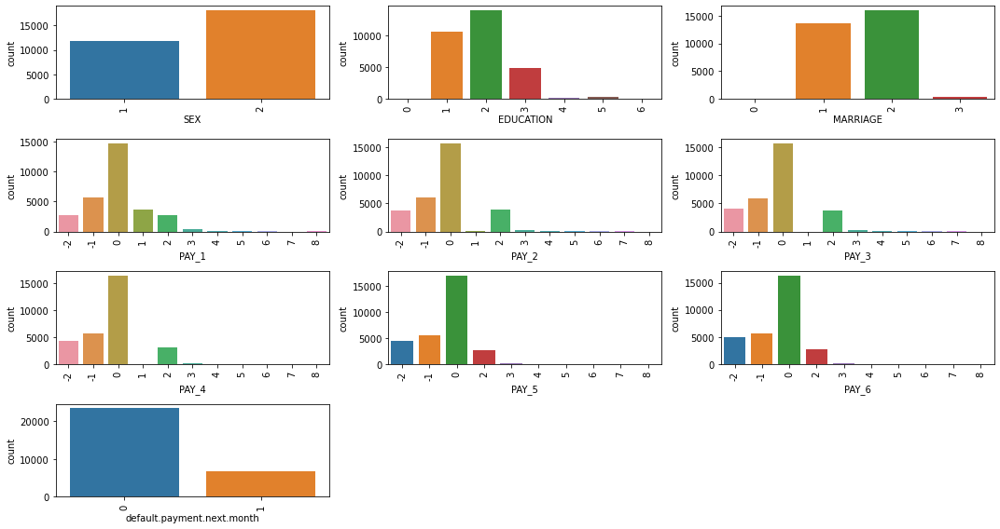

In [82]:
rows=4
columns=3
iterator=1

for i in cat_cols:
    plt.subplot(rows,columns,iterator)
    sns.countplot(df[i])
    plt.xticks(rotation=90)
    iterator+=1
plt.tight_layout()
plt.show()

1. The PAY_X columns have maximum records under category 0, which refers to the use of  revovling credit. Most observations are present in the -2, -1 and 0 categories, indicating that most customers are either inactive (-2), have paid their bill duly (-1) or make use of revolving credit (0). Hence, delayed payments are less frequent.
2. There are less male customers (1) than female customers (2).
3. Most of the customers have university level of education (2) followed by graduate level (1) and highschool level (3). The others (4) and unknown (5,6,0) categories have the least number of customers.
4. Most customers are single (2) followed by married (1).
5. The target variable have more non-defaulters than defaulters.

### Bivariate Analysis

#### Numerical columns vs Target:-

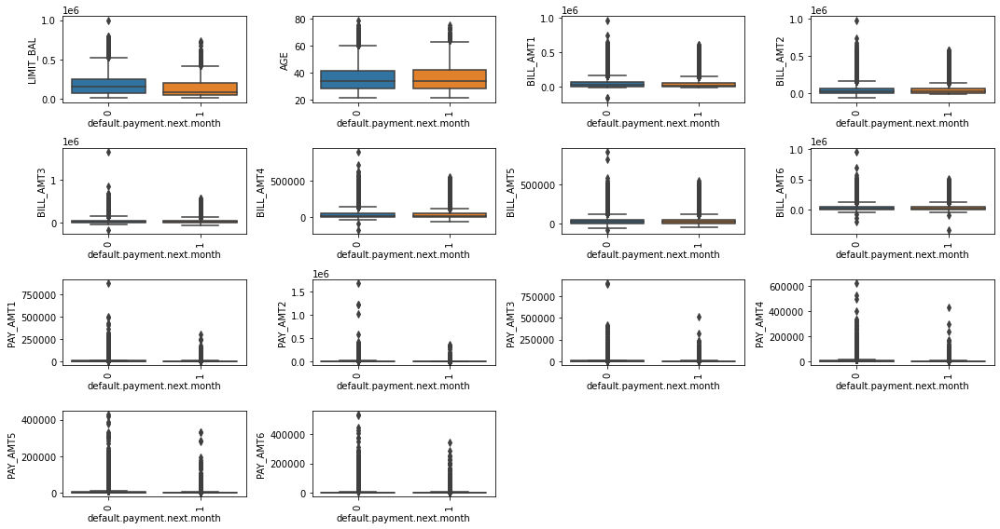

In [83]:
rows=4
columns=4
iterator=1

for i in num_cols:
    plt.subplot(rows,columns,iterator)
    sns.boxplot(df['default.payment.next.month'],df[i])
    plt.xticks(rotation=90)
    iterator+=1
plt.tight_layout()
plt.show()

1. The LIMIT_BAL and AGE columns do not show much variance in either categories, so we can infer that the target is not significantly influenced by these two columns.
2. The BILL_AMTX columns have slightly higher values for the non-defaulter category.
3. The PAY_AMTX columns have higher values for non-defaulter categories than defaulter categories which is logical.

#### Categorical columns vs the target:-

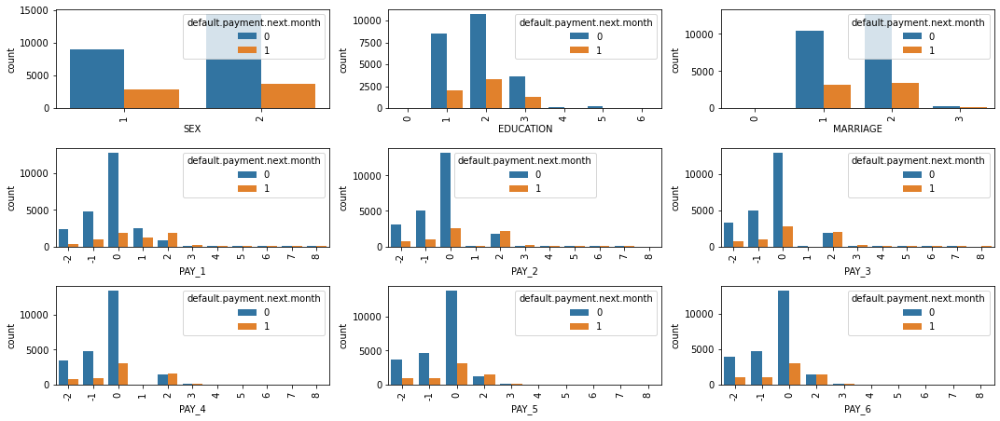

In [84]:
rows=4
columns=3
iterator=1

for i in cat_cols:
    if i != 'default.payment.next.month':
        plt.subplot(rows,columns,iterator)
        sns.countplot(df[i], hue = df['default.payment.next.month'])
        plt.xticks(rotation=90)
        iterator+=1
    else:
        continue
plt.tight_layout()
plt.show()

1. In the PAY_X columns, most of the non defaulters fall in the -2, -1 or 0 categories in the PAY columns, indicating that they are either inactive customers(category -2) or pay their bills on time (-1)  or use revolving credit (0). Hence, they usually do not have payment delays.
2. The defaulters are almost equally distributed between both the genders. However, there are more female non-defaulters than male.
3. Most of the people with higher educational qualification (university and graduate levels) are non-defaulters. However, most defaulters gave a university level education.
4. The defaulters are almost equally distributed among the married and single categories.

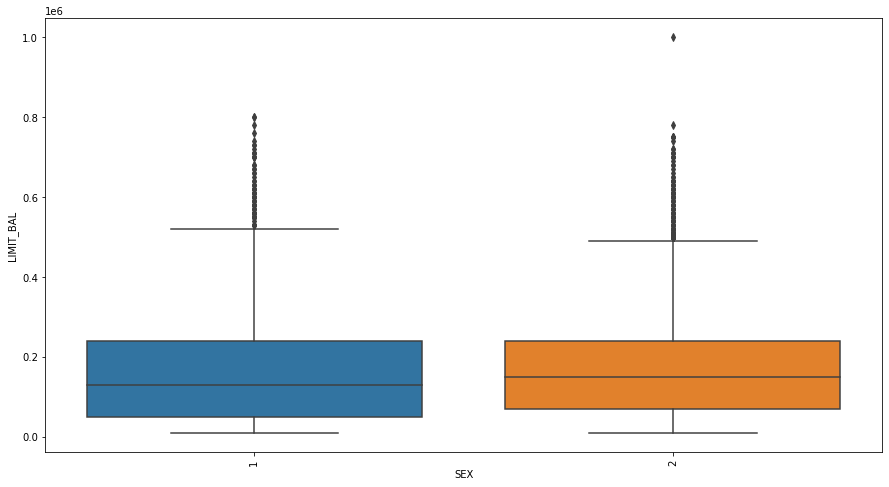

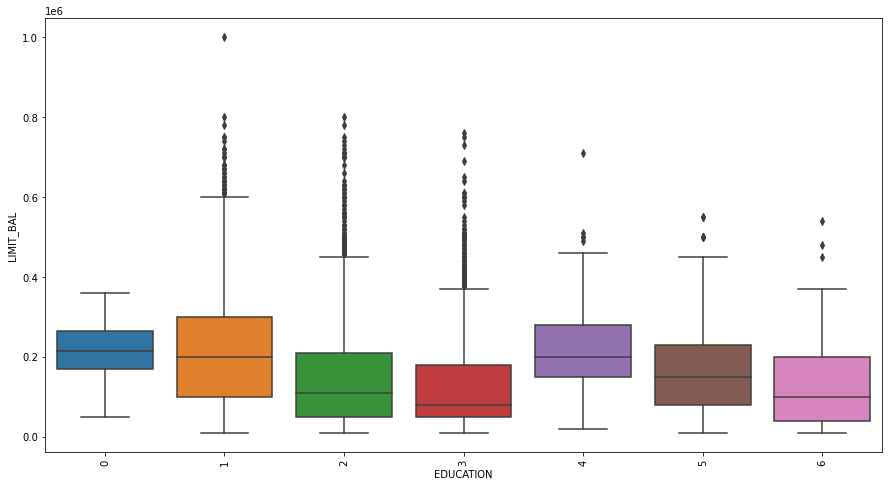

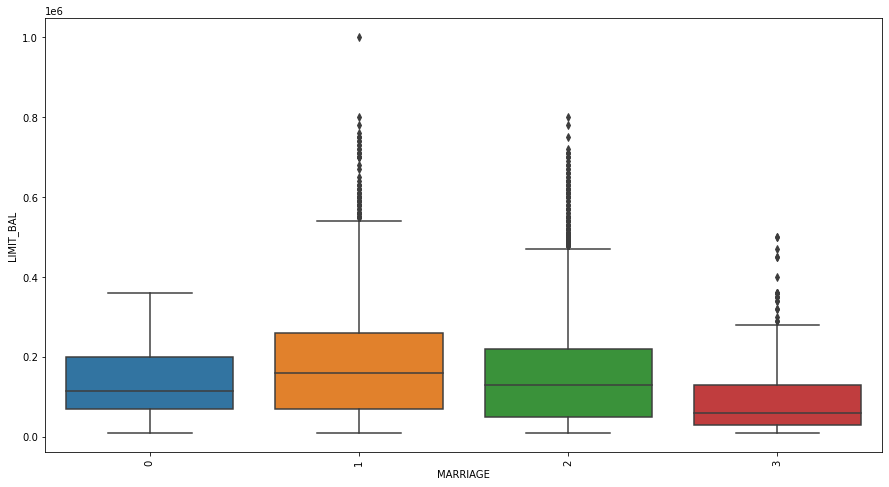

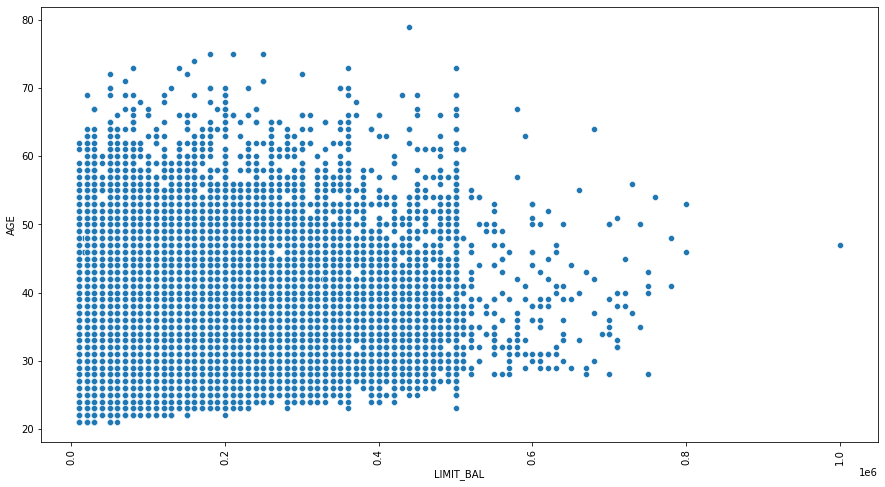

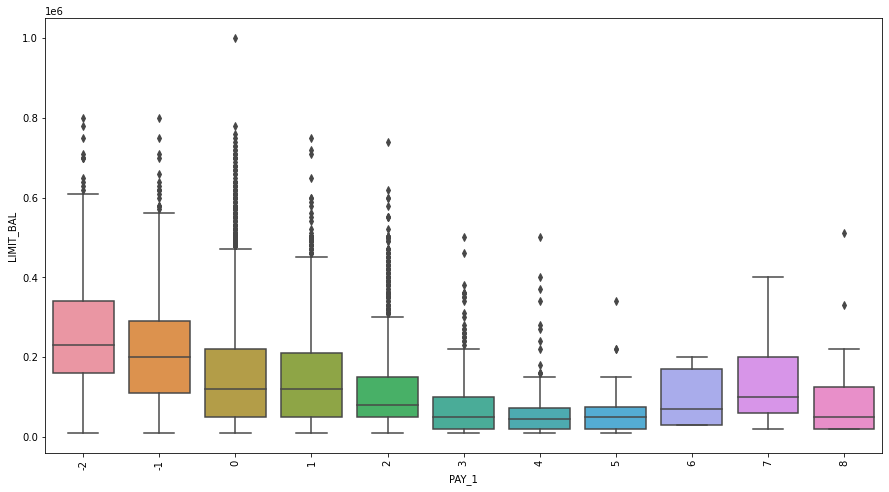

...

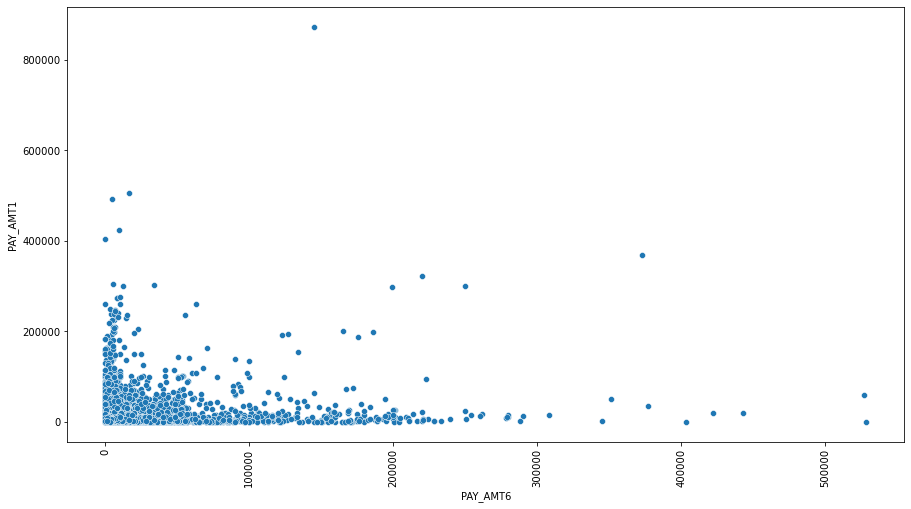

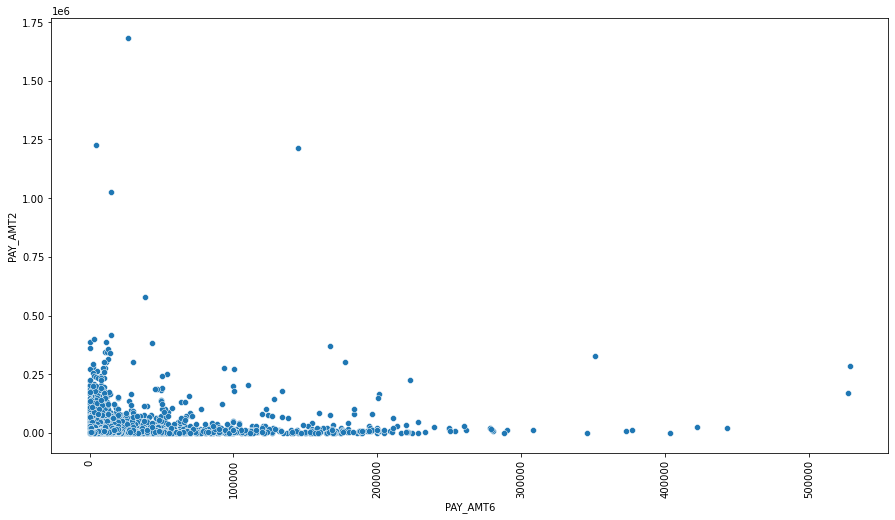

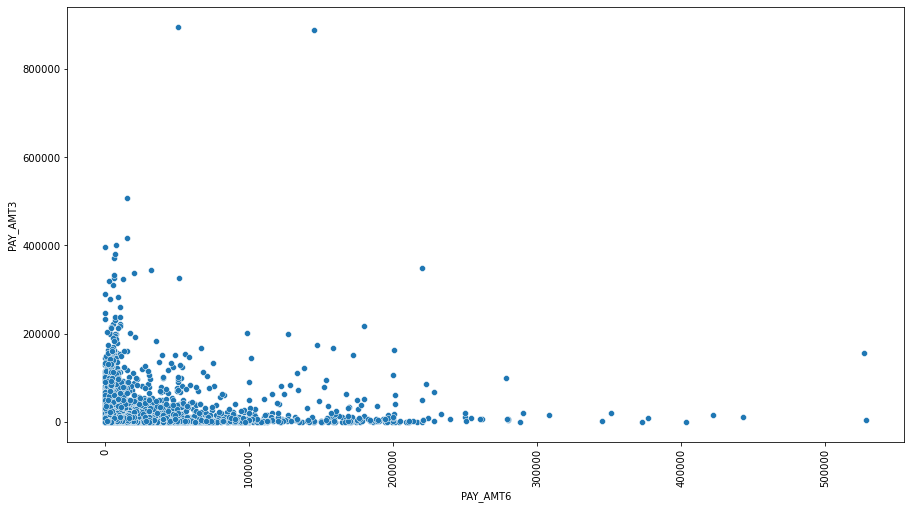

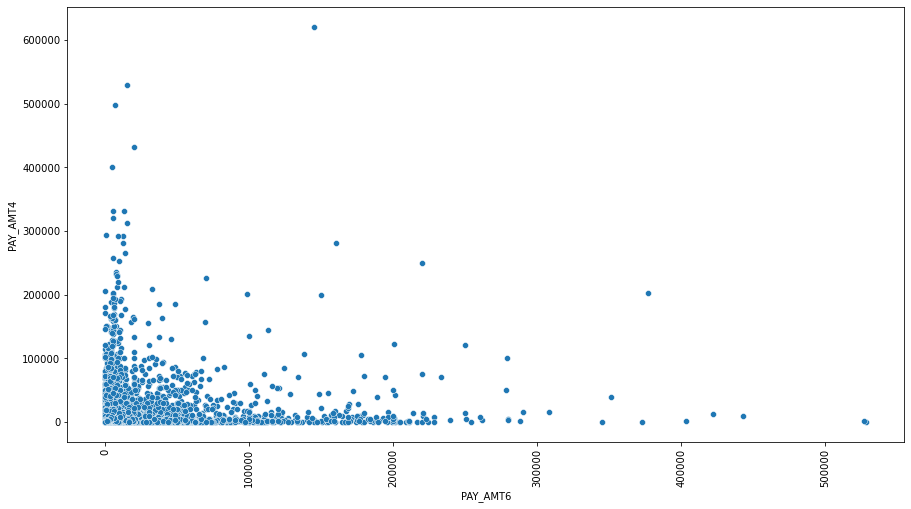

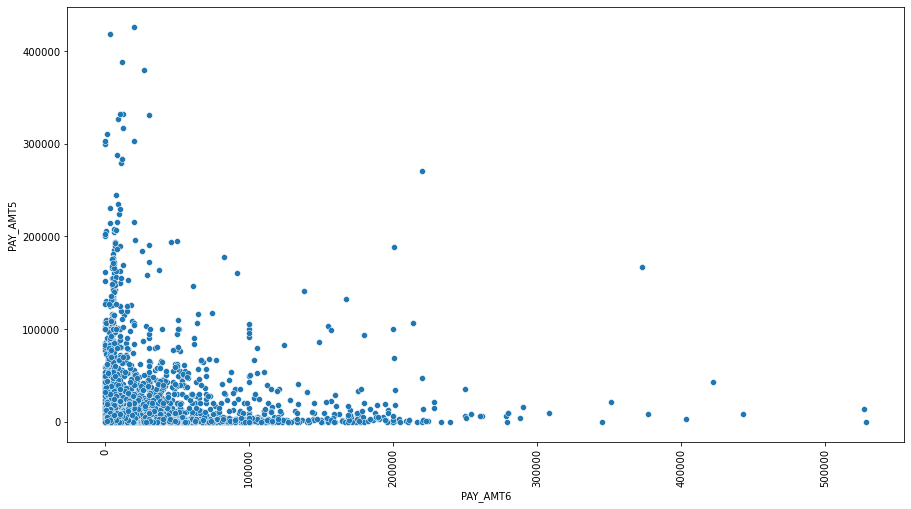

In [85]:
for i in num_cols:
    for j in df.drop([i,'default.payment.next.month'],axis=1).columns:
        if j in num_cols:
            sns.scatterplot(df[i], df[j])
            plt.xticks(rotation=90)
        else:
            sns.boxplot(df[j], df[i])
            plt.xticks(rotation=90)
        plt.show()
        

##### Inferences:

1. In the plots between LIMIT_BAL and PAY_X columns, we see that the limit balance slightly decreases as the payment delay increases.
2. In the plots between BILL_AMTX and LIMIT_BAL, although there is not a proper linear relationship, we see that the limit balance is higher when the bill amount is higher.
3. In the plots between AGE and MARRIAGE, we see that customers who are younger are usually single and older customers belong to married or others categries.
4. In the plots between BILL_AMTX and PAY_X columns, we see that the bill amount is highest for customers using revolving credit (category 0 under PAY_X)
5. In the plots between the different BILL_AMTX columns, we see a slight linear relationship. This implies that there is some consistency in the bill amounts for customers over the 6 months.
6. In the plots between PAY_AMTX and PAY_X, we see that the pay amount is higher in the categories -1 and 0. Hence, payment delays result in lower pay amounts.
7. In plots between PAY_AMTX and EDUCATION, we see that the payment amount is slightly higher in graduate, university and high school levels.

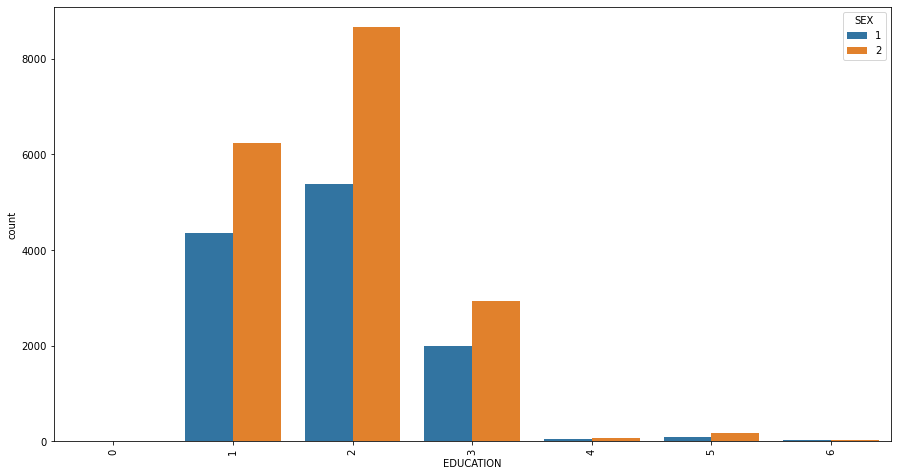

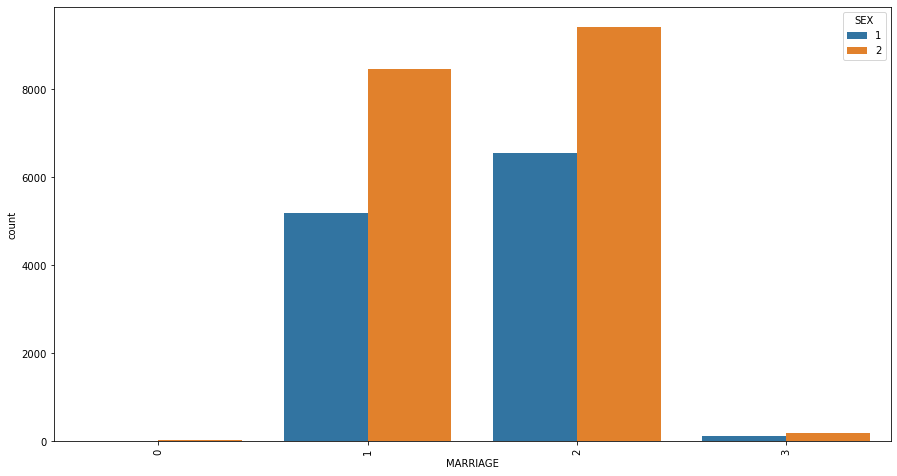

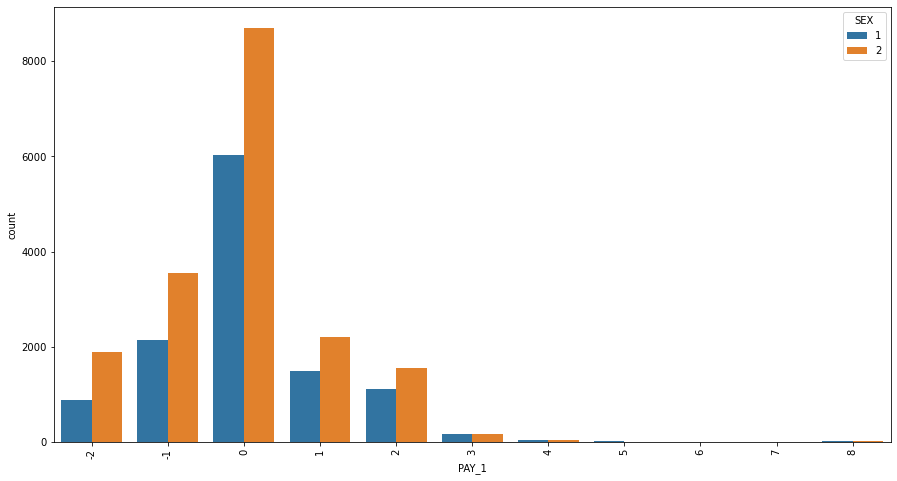

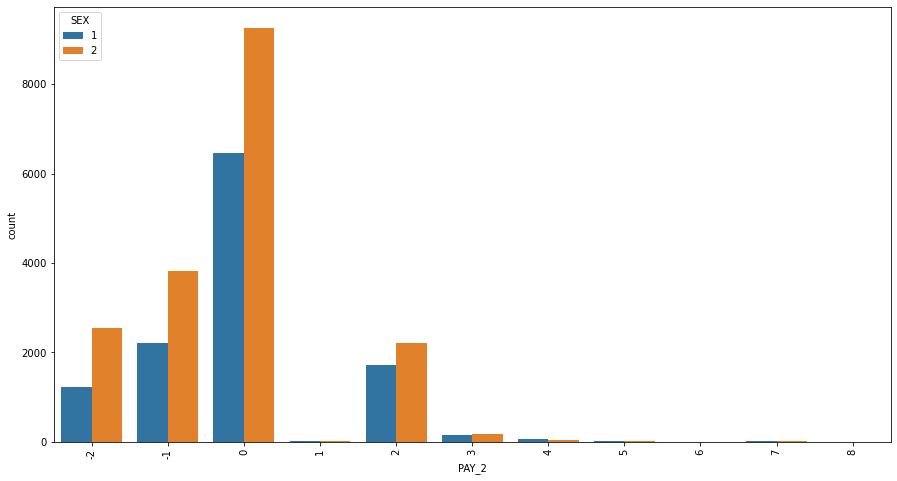

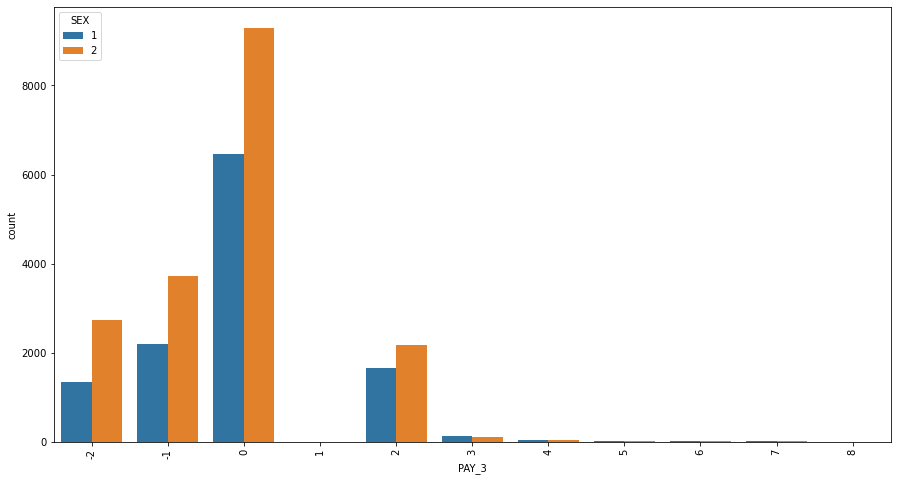

...

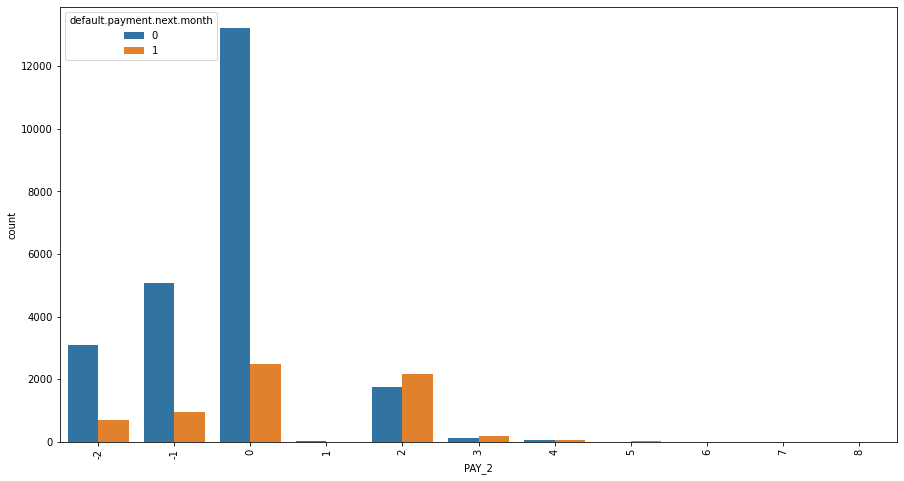

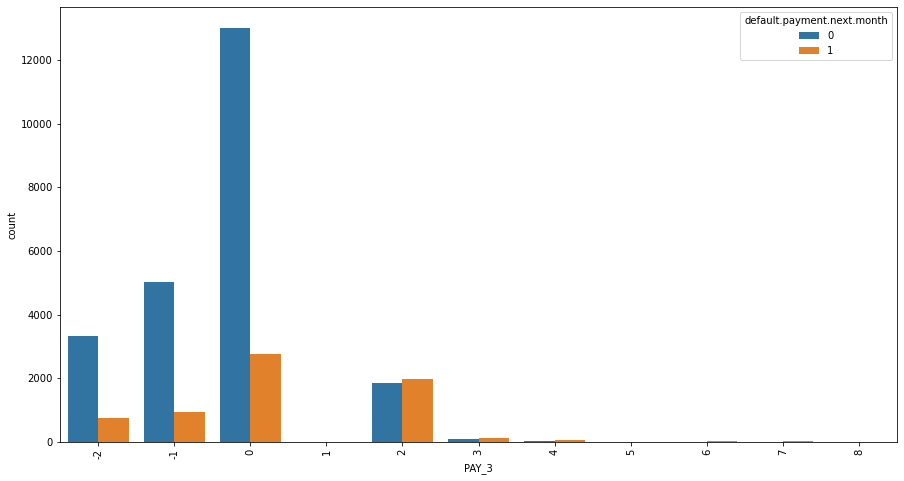

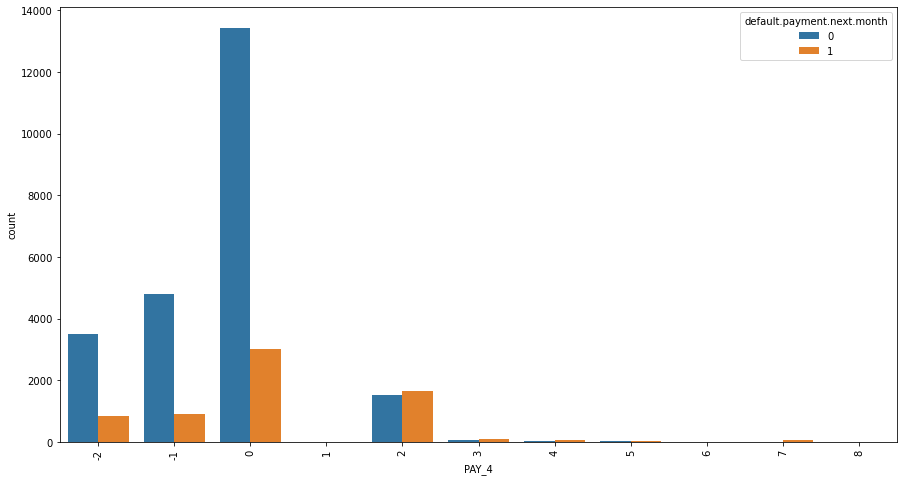

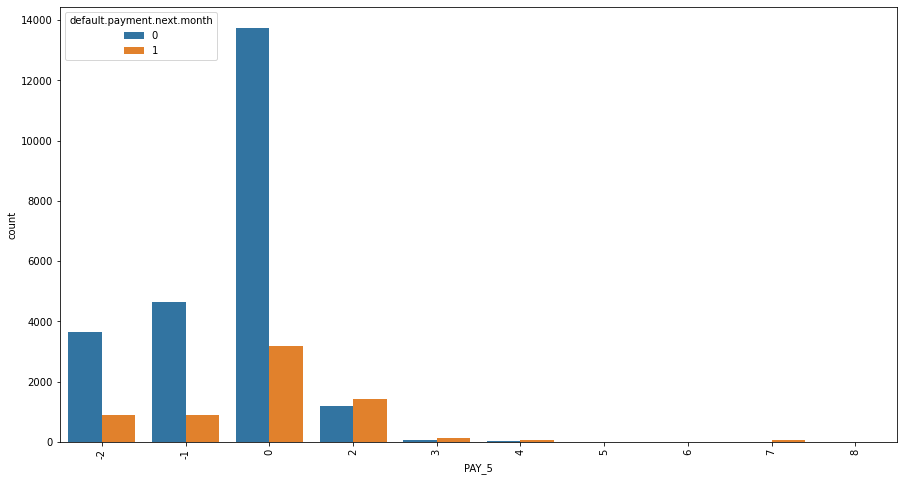

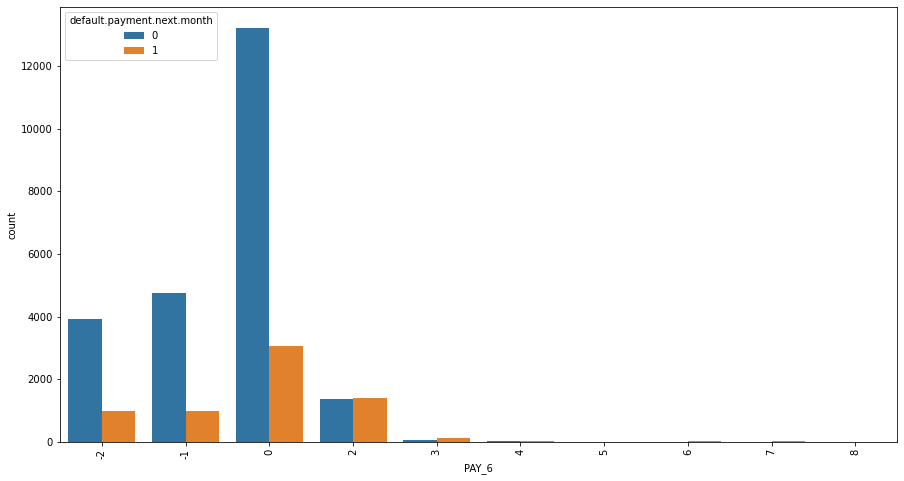

In [86]:
for i in cat_cols:
    for j in df.drop([i,'default.payment.next.month'],axis=1).columns:
        if j in cat_cols:
            sns.countplot(df[j], hue = df[i])
            plt.xticks(rotation=90)
        else:
            continue
        plt.show()

##### Inferences

1. In the plots for PAY_X columns with sex as hue, we see that females are slightly less likely to delay the payments than males
2. In the plots for PAY_X columns with education as hue, we see that graduates are most likely to pay their bills on time and customers with university level education are the largest users of revolving credit
3. In the plots for PAY_X columns with marriage as hue, we see that single people are the largest users of revolving credit.

### Multivariate Analysis

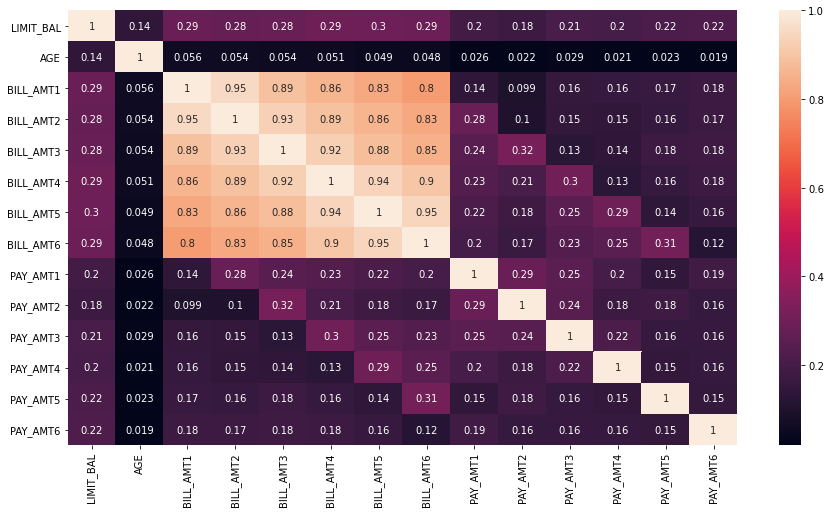

In [87]:
sns.heatmap(df.corr(),annot=True)
plt.show()

1. BILL_AMTX columns are showing high correlation amongst themselves.
2. The other columns are not showing high correlation with other columns of the dataset.

##### LIMIT_BAL vs PAY_X columns with target as hue

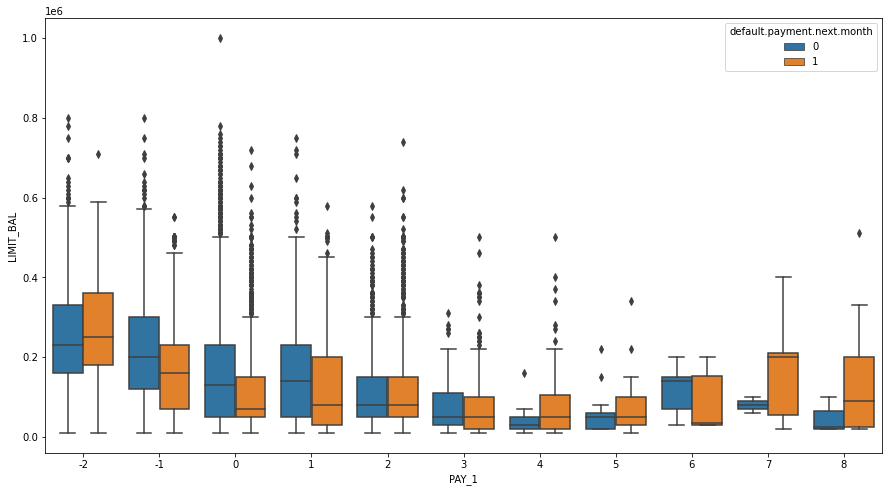

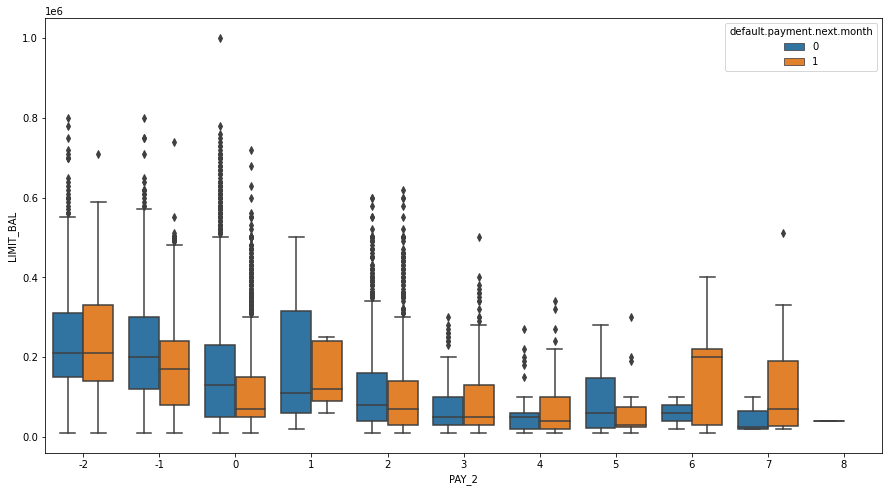

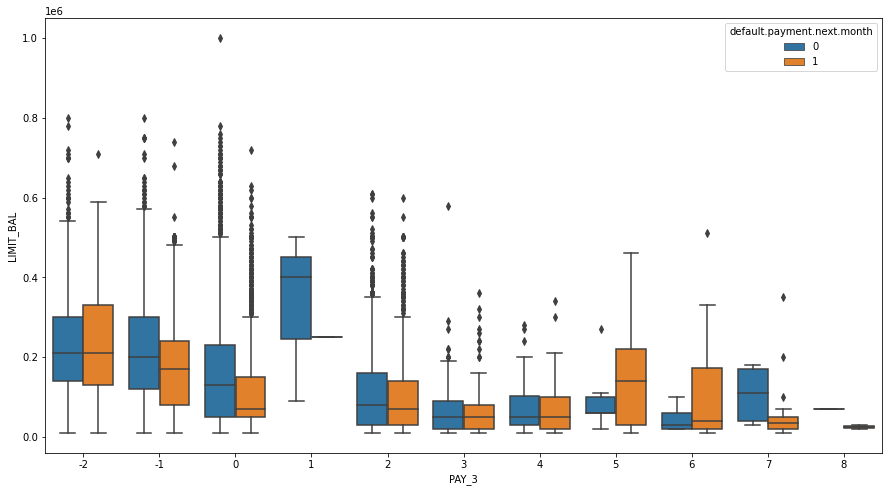

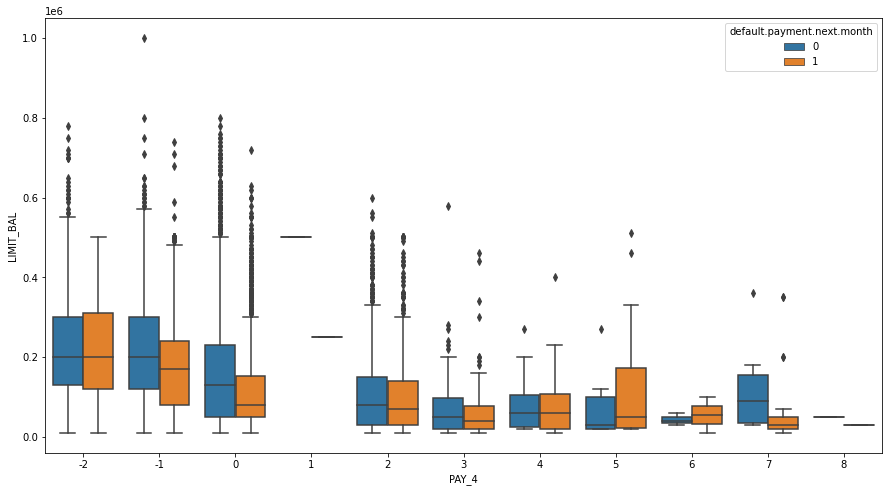

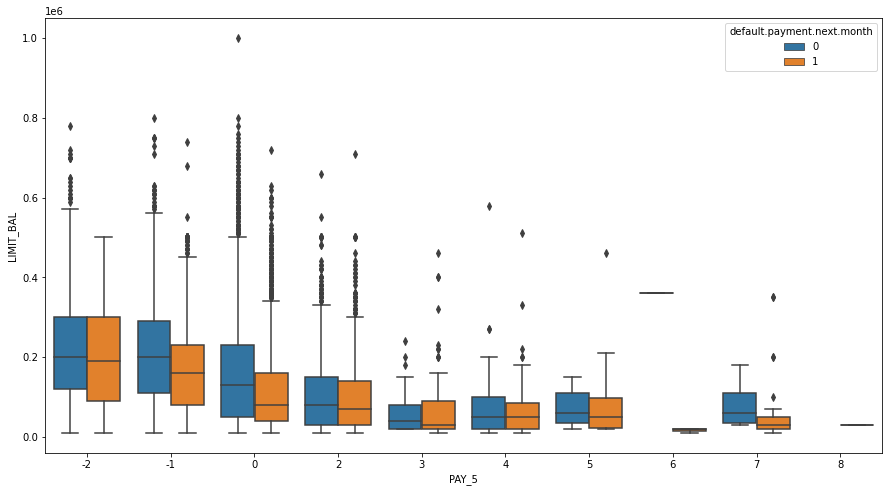

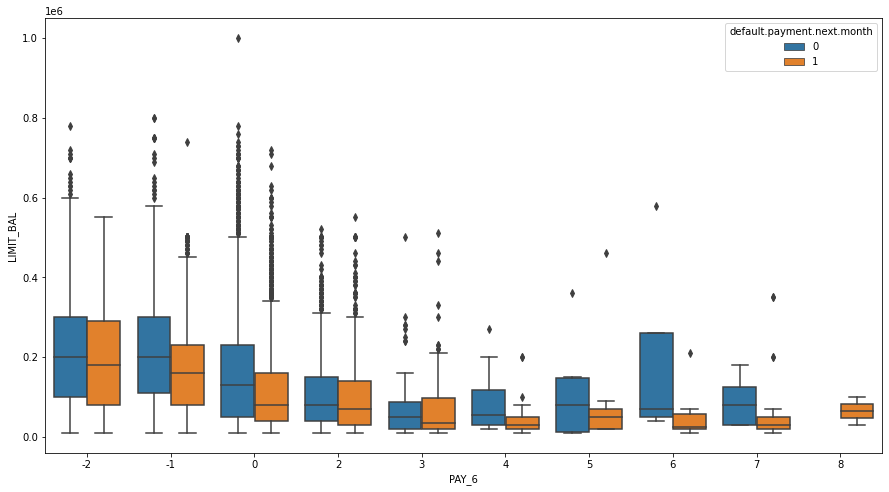

In [88]:
cols = ['PAY_1','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6']
for i in cols:
    sns.boxplot(df[i],df['LIMIT_BAL'],hue=df['default.payment.next.month'])
    plt.show()

From the above plot, we can see that the limit balance slightly decreases for defaulters and as payment delay increases

##### LIMIT_BAL vs BILL_AMTX columns with target as hue

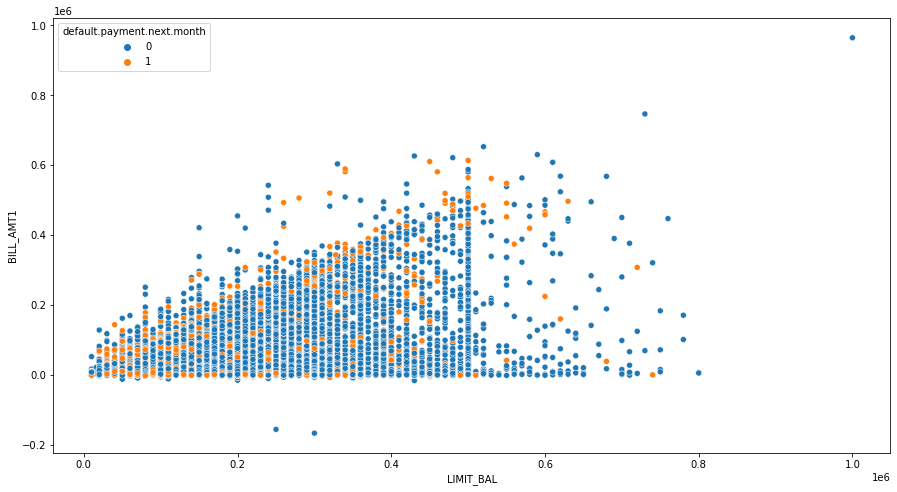

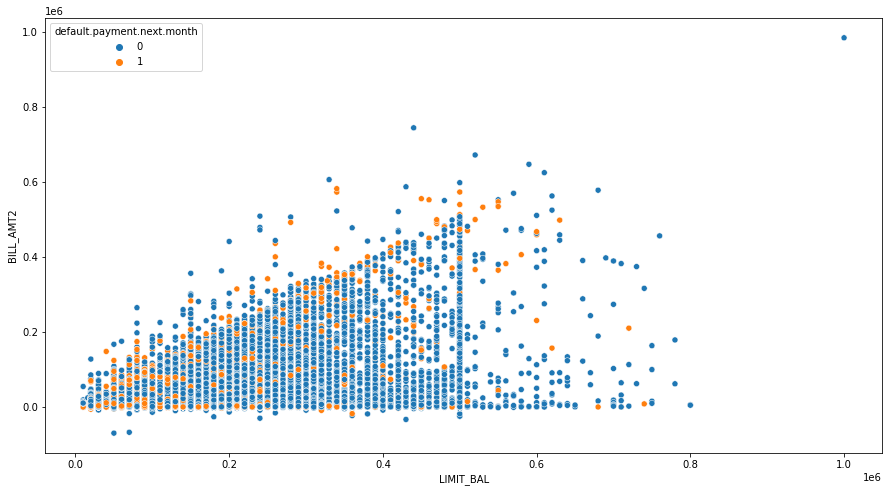

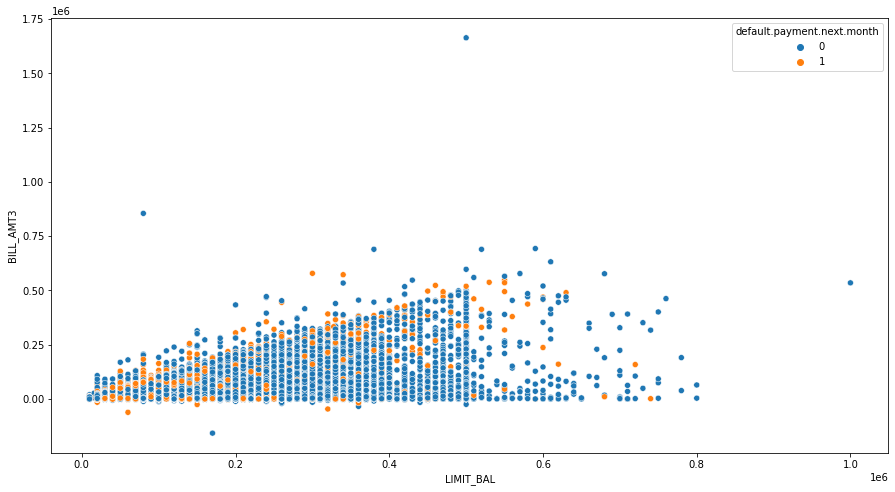

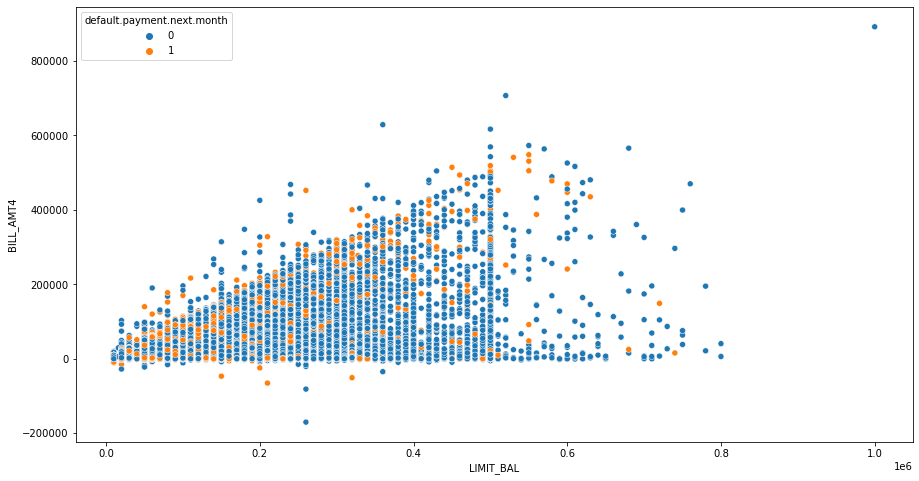

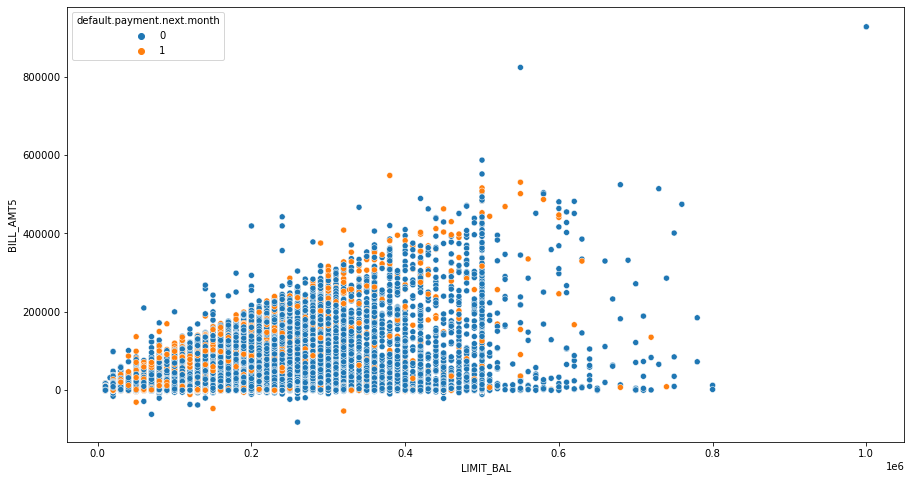

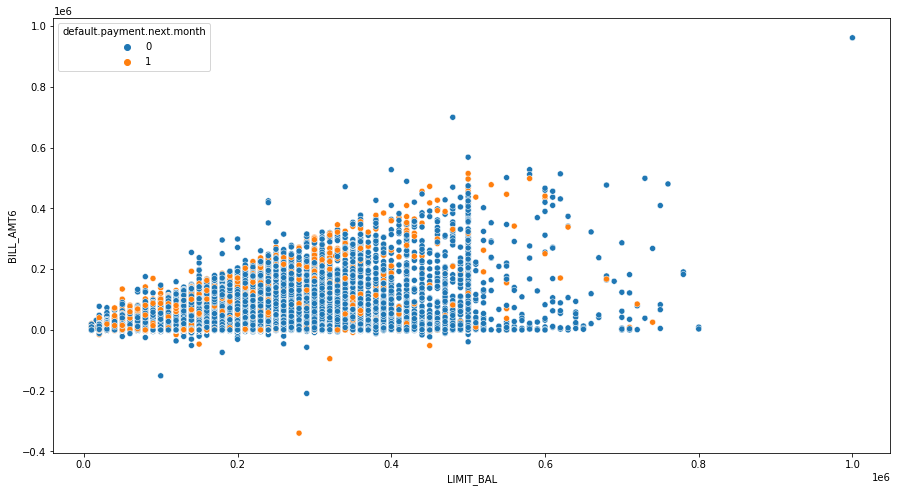

In [89]:
cols = ['BILL_AMT1','BILL_AMT2','BILL_AMT3','BILL_AMT4','BILL_AMT5','BILL_AMT6']
for i in cols:
    sns.scatterplot(df['LIMIT_BAL'],df[i],hue=df['default.payment.next.month'])
    plt.show()

There is not much separation between the defaulters and non-defaulters in the above plots, hence no significant inferences can be made.

##### PAY_X vs BILL_AMTX columns with target as hue

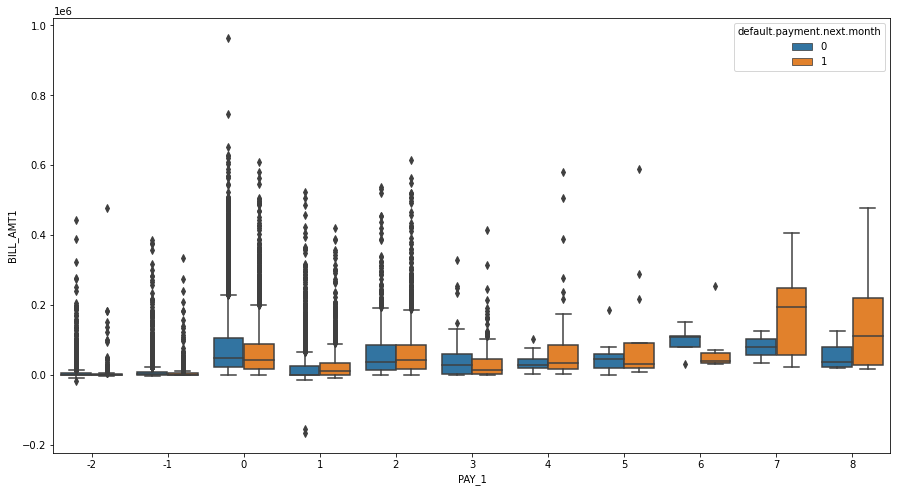

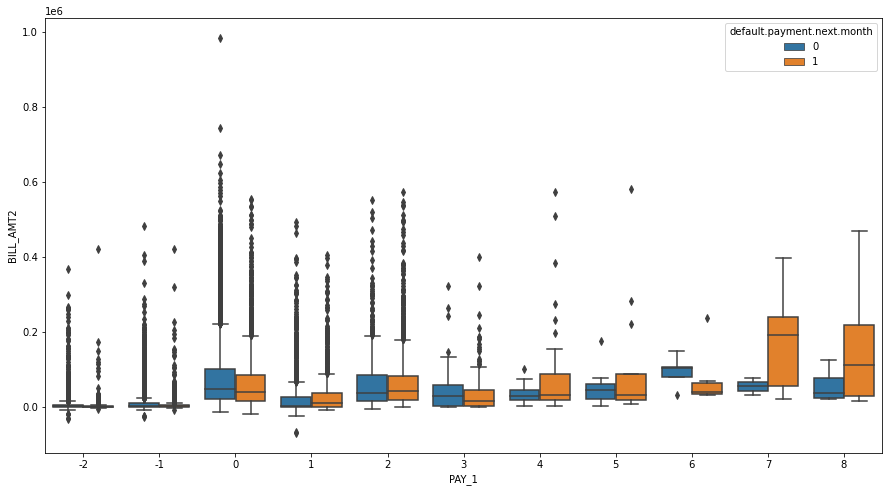

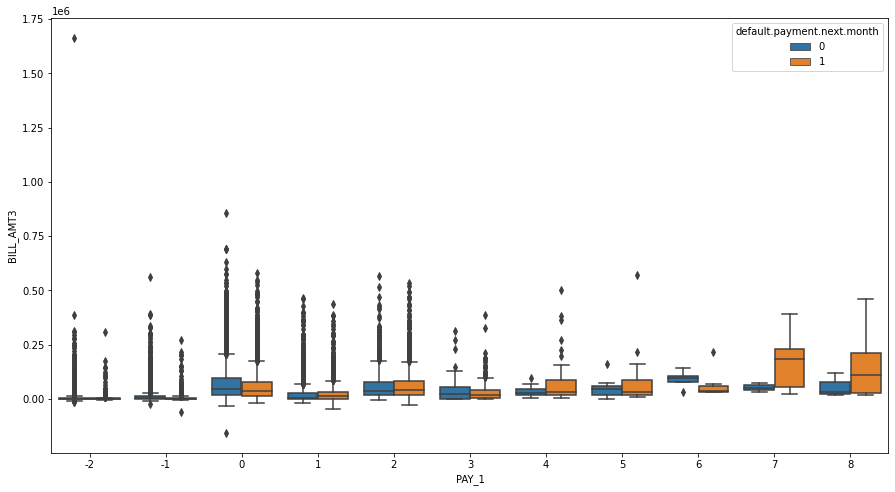

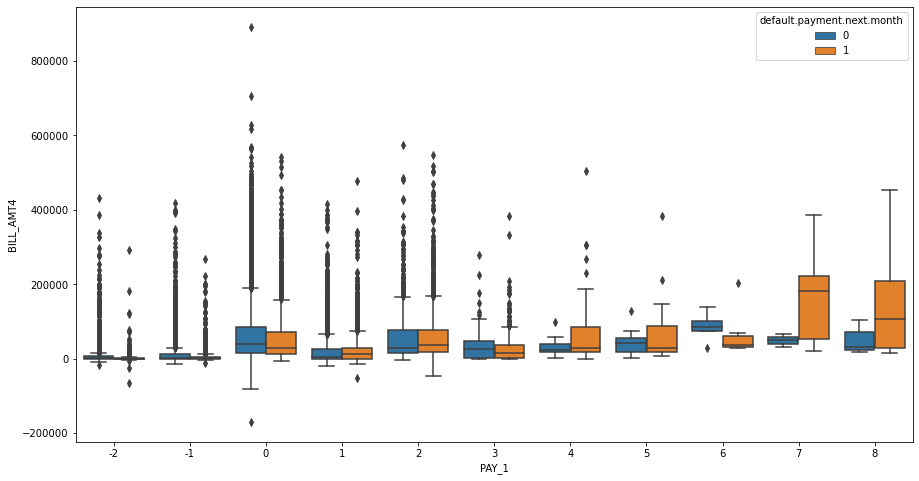

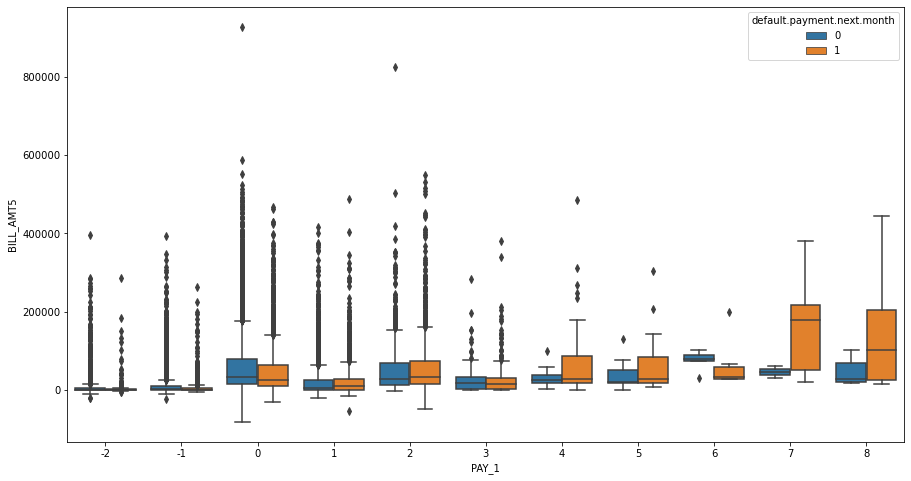

...

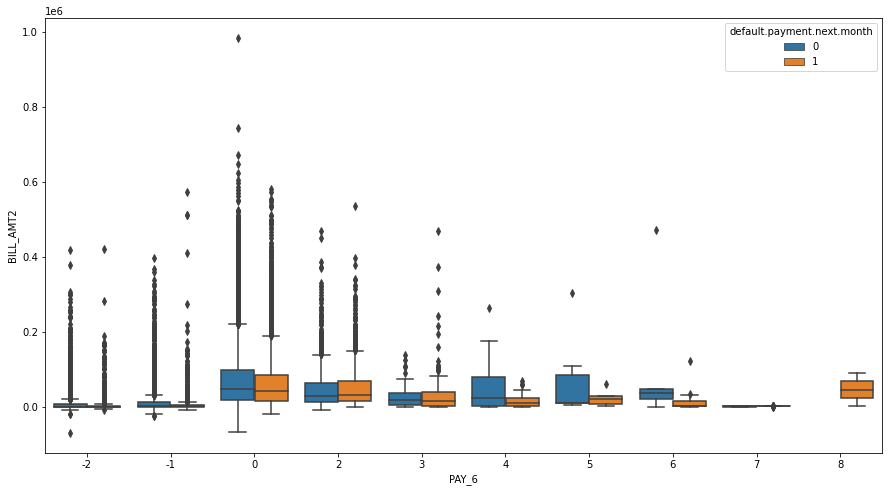

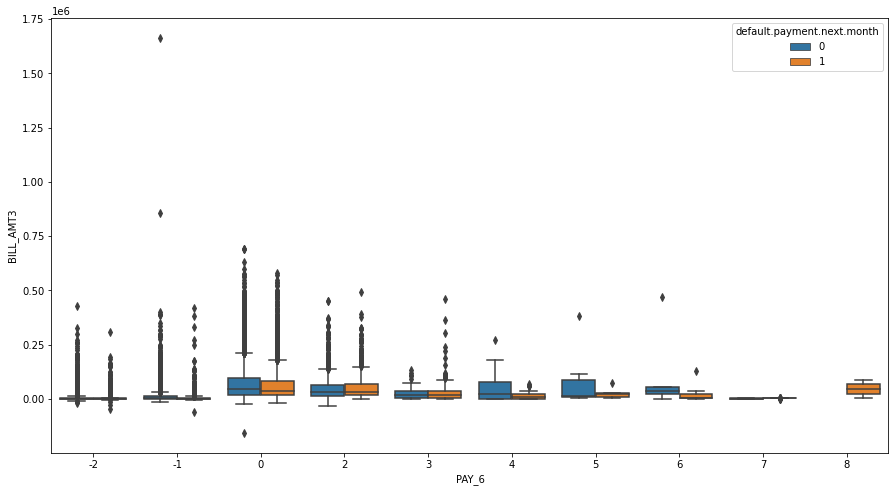

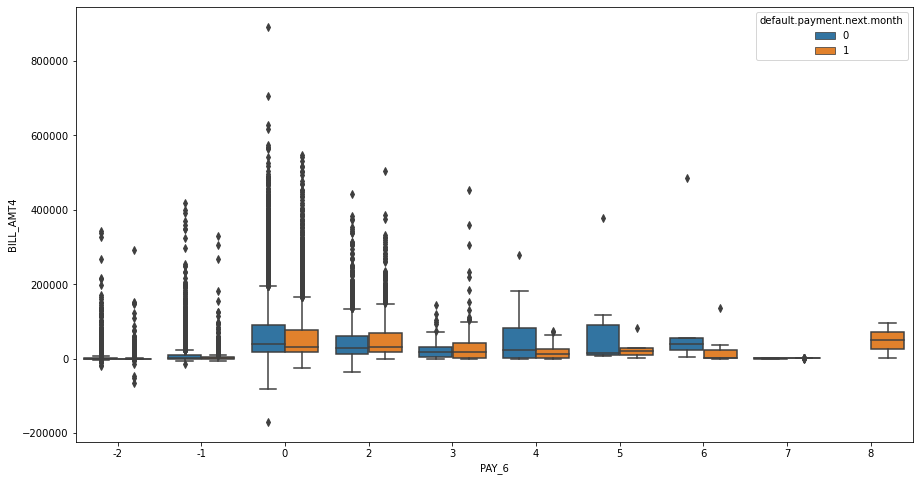

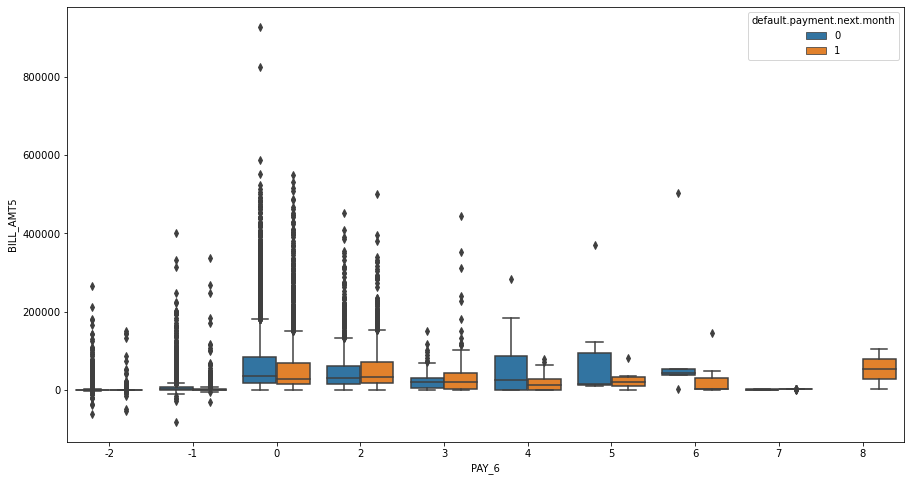

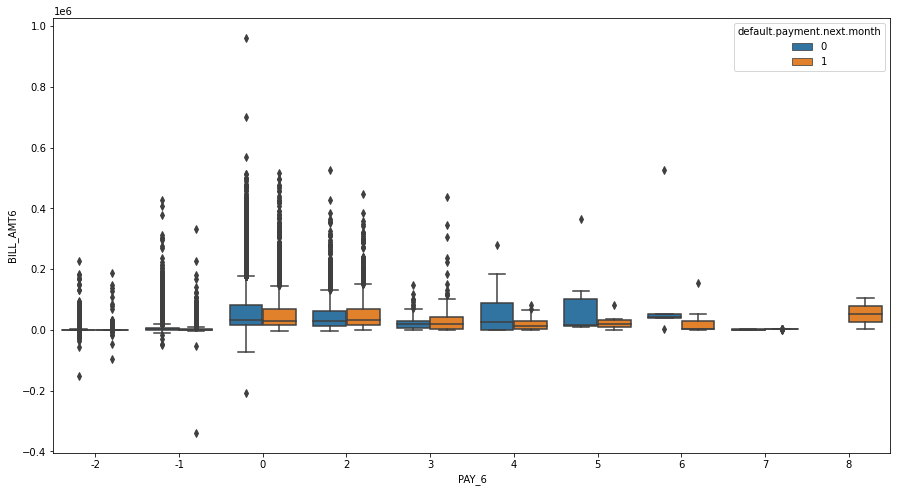

In [90]:
cols_pay = ['PAY_1','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6']
cols_bill = ['BILL_AMT1','BILL_AMT2','BILL_AMT3','BILL_AMT4','BILL_AMT5','BILL_AMT6']
for i in cols_pay:
    for j in cols_bill:
        sns.boxplot(df[i],df[j],hue=df['default.payment.next.month'])
        plt.show()

The bill amount is increasing for defaulters as the payment delay increases.

##### BILL_AMTX vs BILL_AMTX columns with target as hue

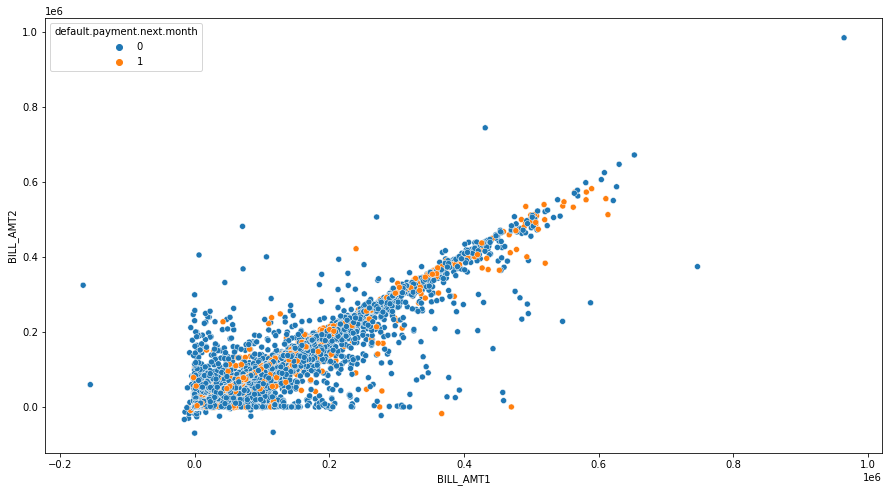

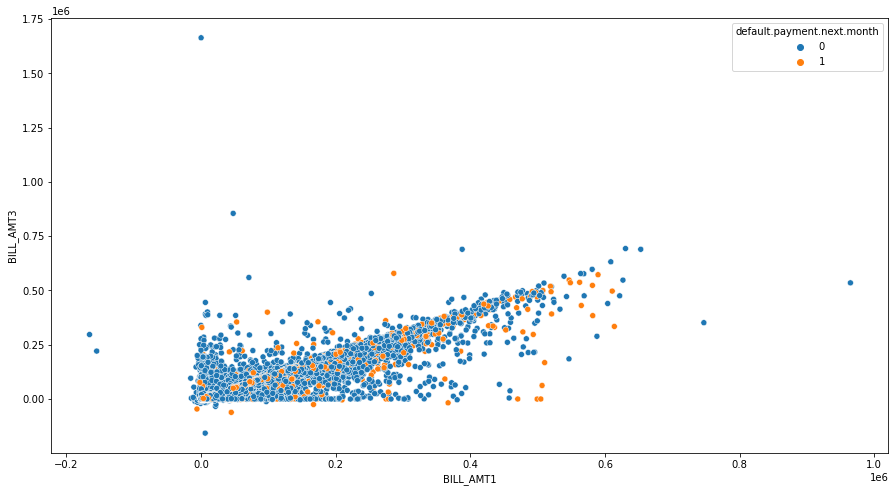

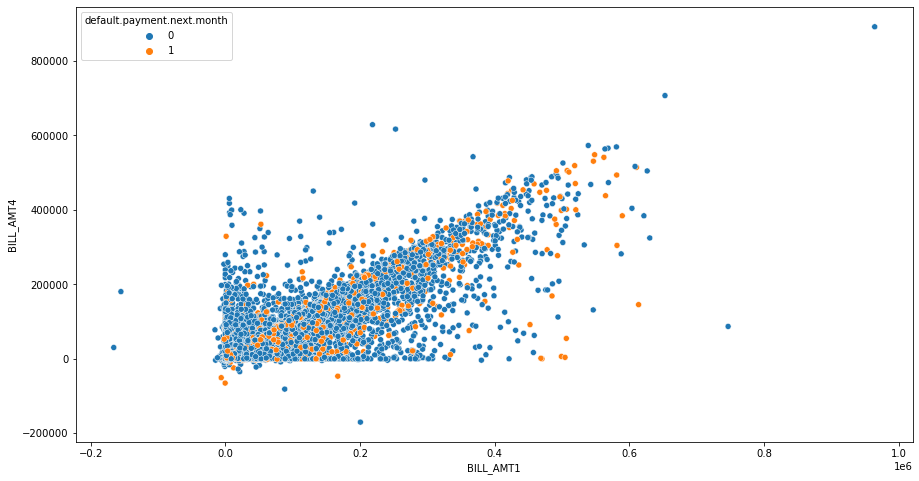

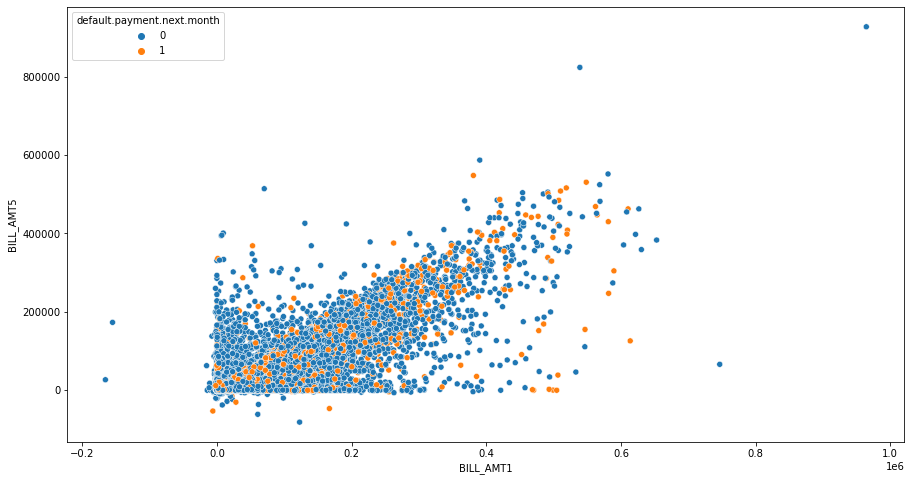

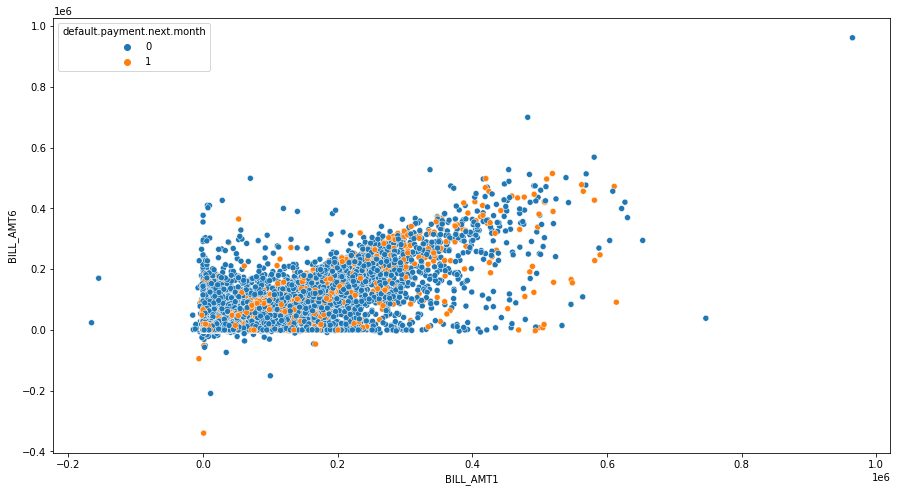

...

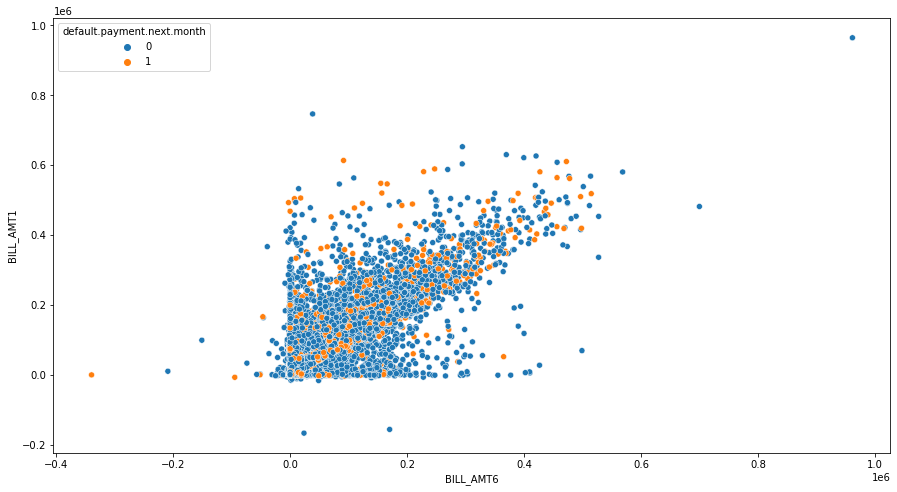

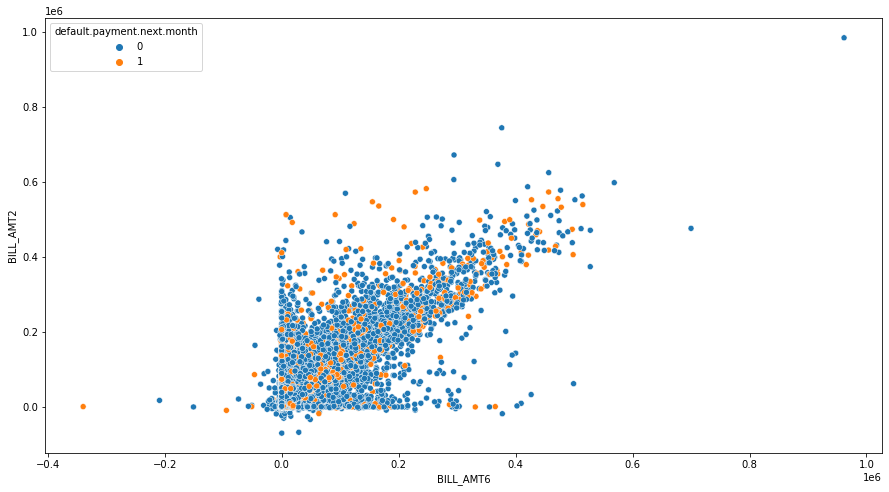

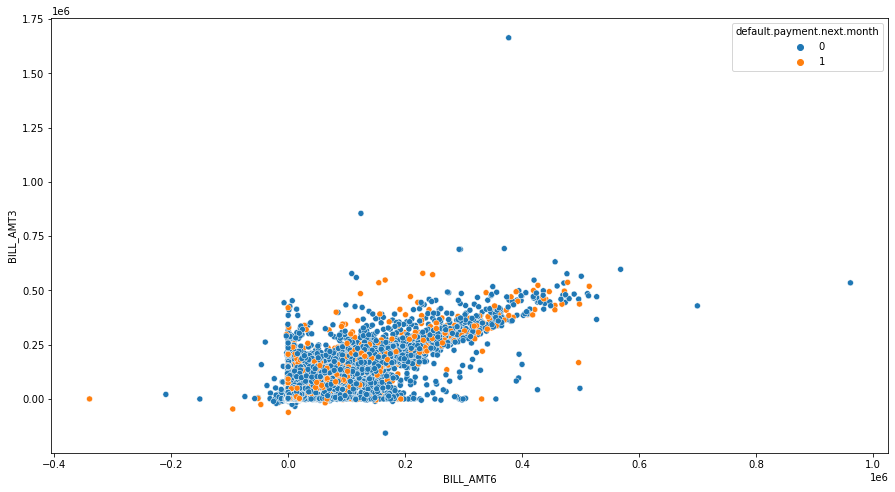

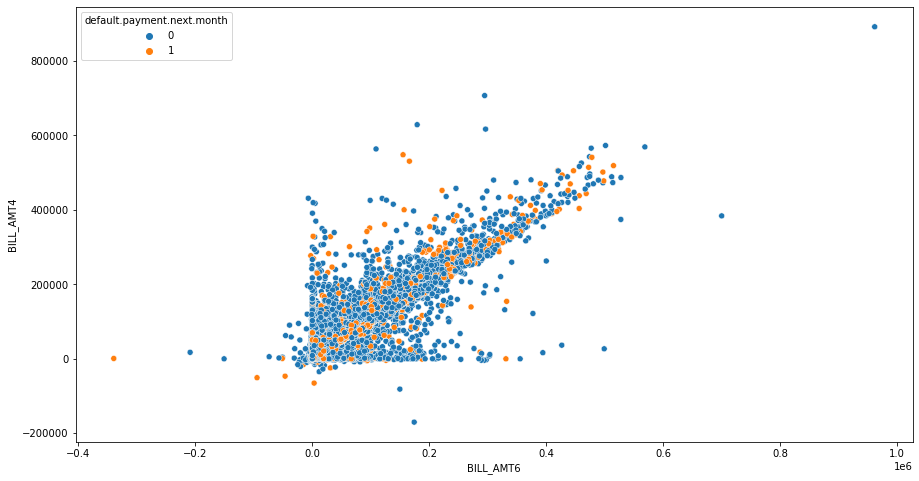

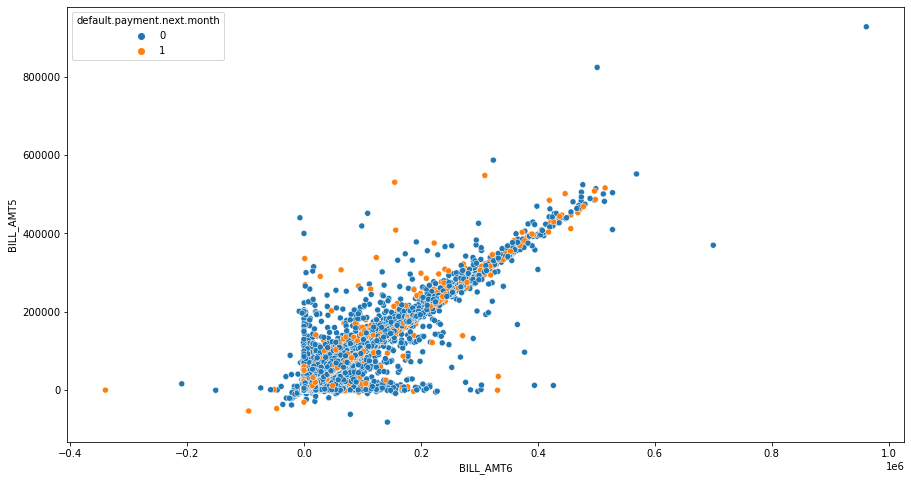

In [91]:
cols = ['BILL_AMT1','BILL_AMT2','BILL_AMT3','BILL_AMT4','BILL_AMT5','BILL_AMT6']
cols1 = ['BILL_AMT1','BILL_AMT2','BILL_AMT3','BILL_AMT4','BILL_AMT5','BILL_AMT6']
for i in cols:
    for j in cols1:
        if j!=i:
            sns.scatterplot(df[i],df[j],hue=df['default.payment.next.month'])
            plt.show()
        else:
            continue

There is no separartion between the two categories of our target, so no significant inference can be made.

##### PAY_X vs PAY_AMTX columns with target as hue

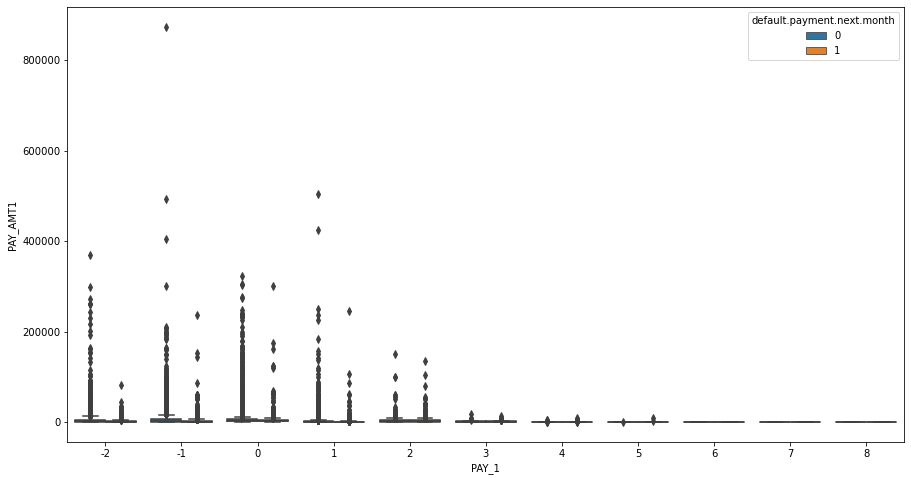

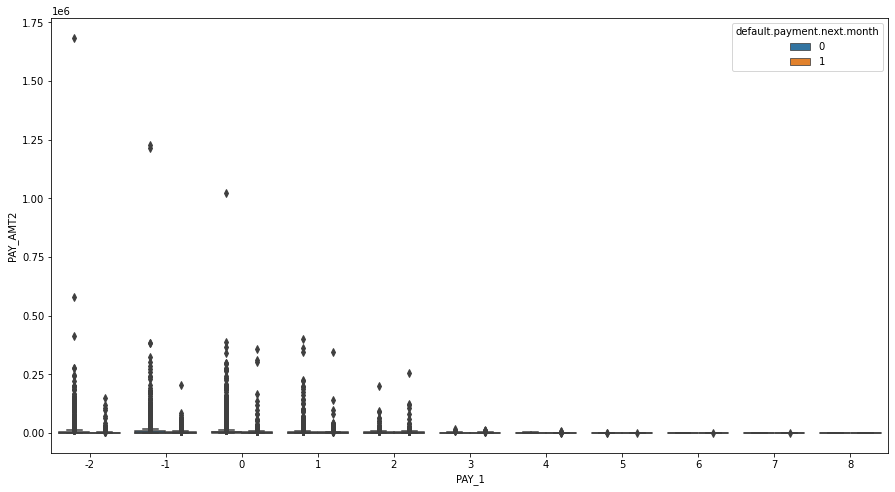

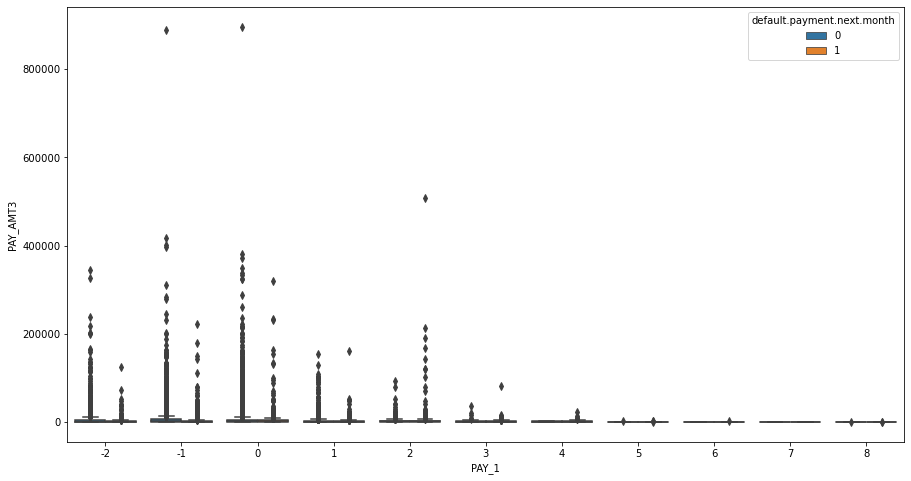

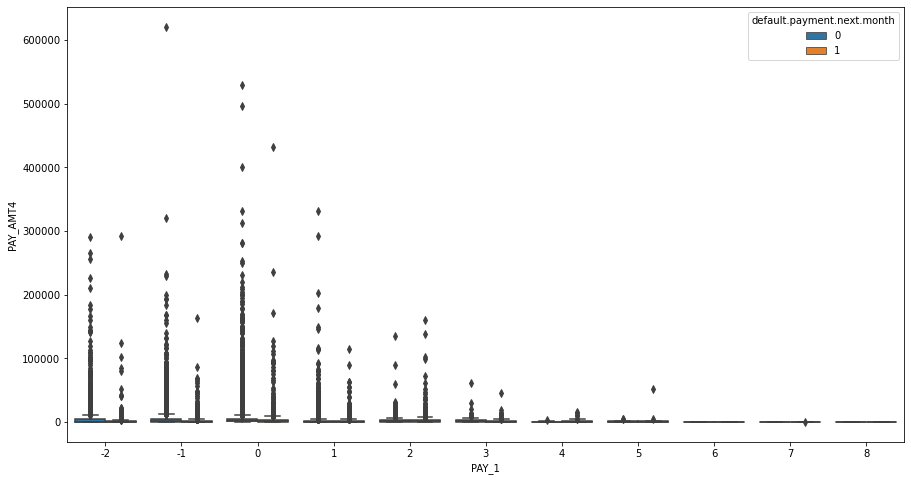

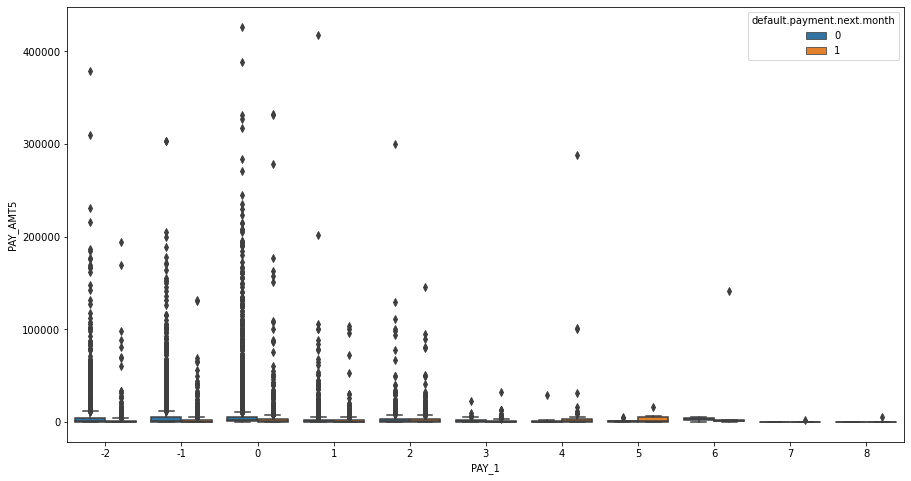

...

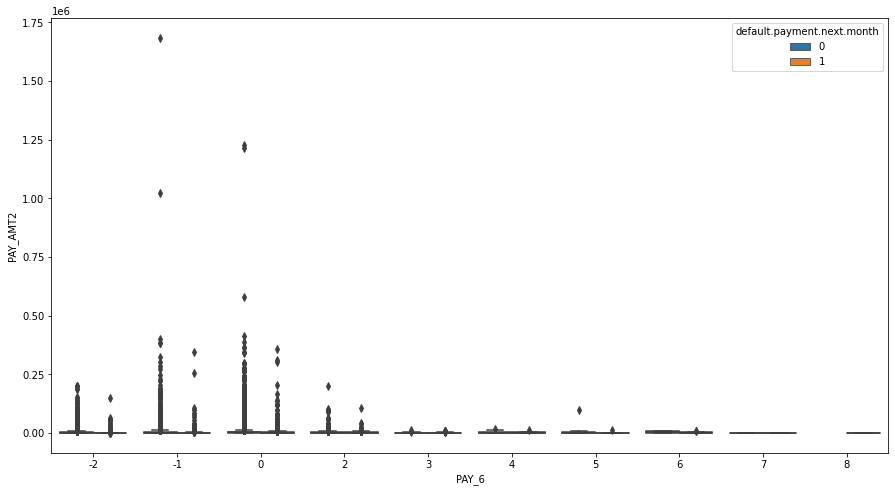

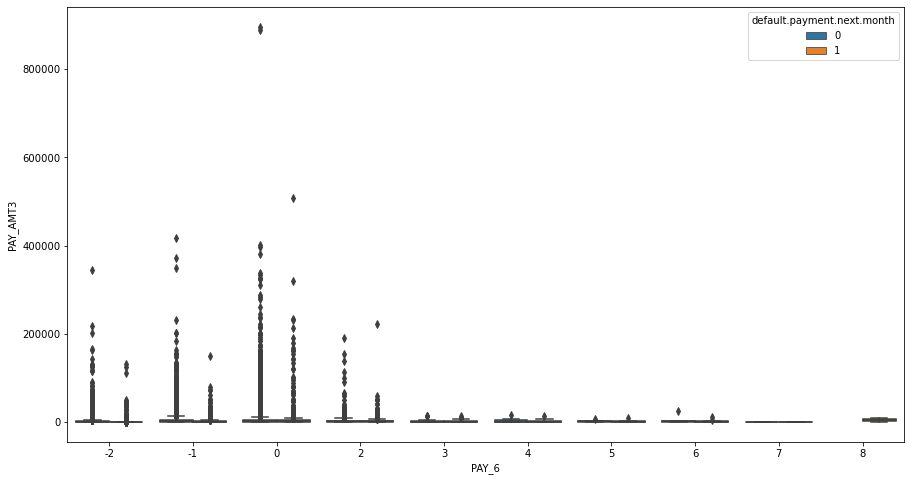

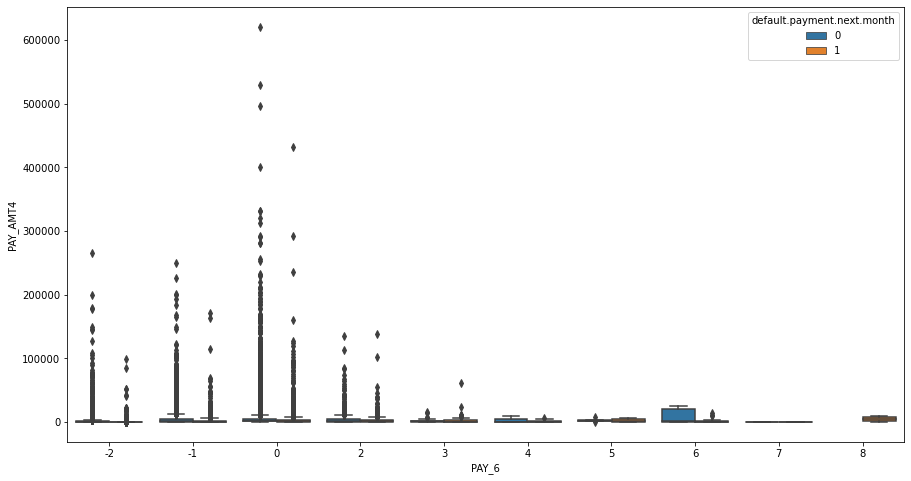

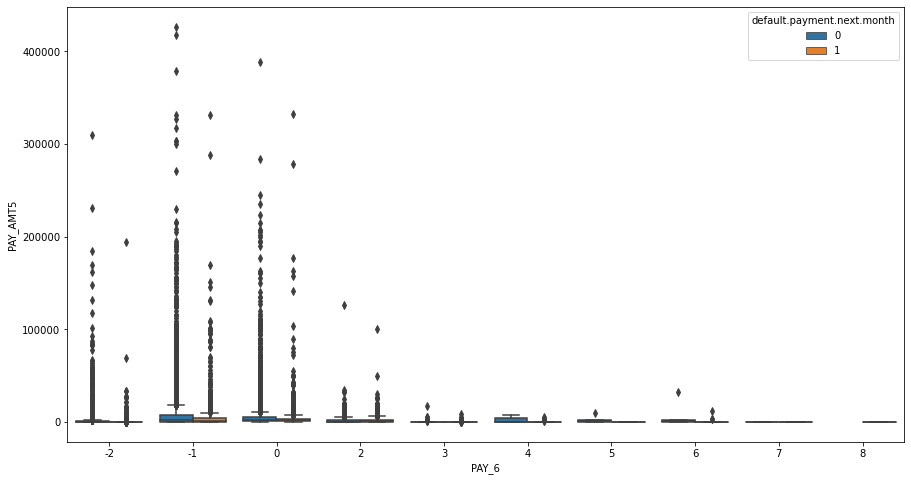

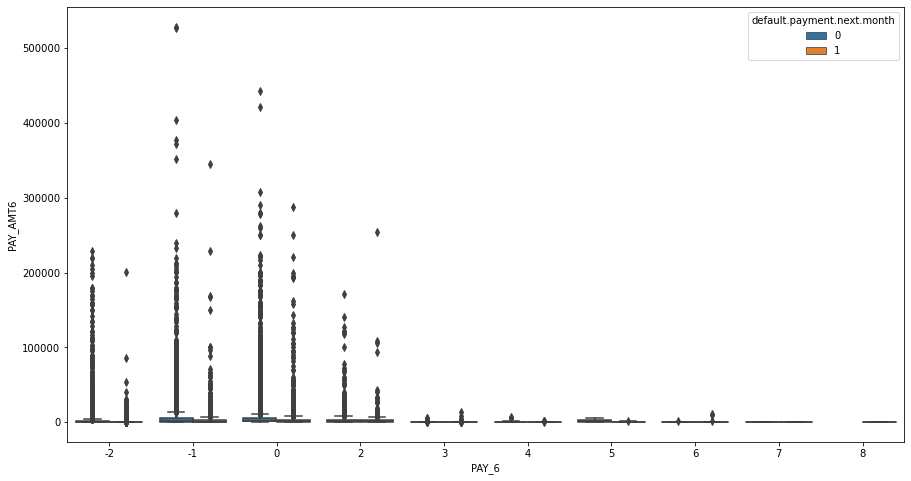

In [92]:
cols_pay = ['PAY_1','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6']
cols_payamt = ['PAY_AMT1','PAY_AMT2','PAY_AMT3','PAY_AMT4','PAY_AMT5','PAY_AMT6']
for i in cols_pay:
    for j in cols_payamt:
        sns.boxplot(df[i],df[j],hue=df['default.payment.next.month'])
        plt.show()

In these plots, we can see that the payment amount in the -2 , -1 and 0 categories of PAY_X columns is higher for non-defaulters.

##### EDUCATION vs PAY_AMTX columns with target as hue

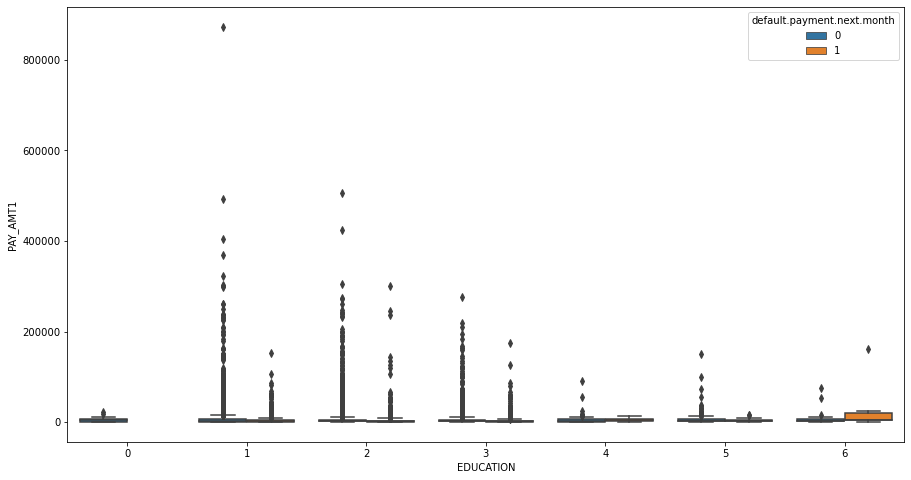

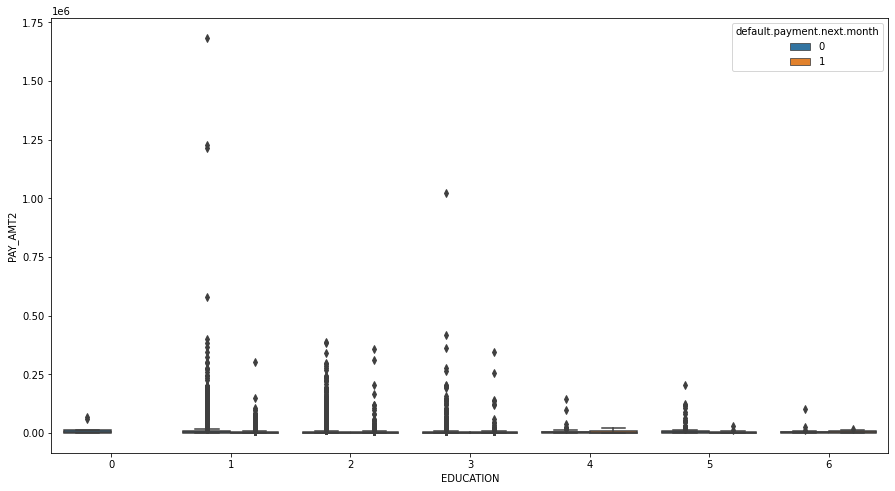

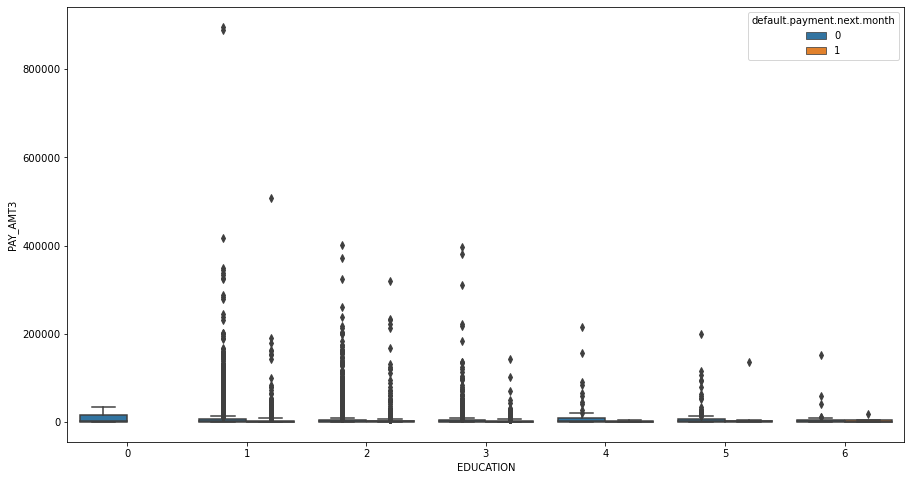

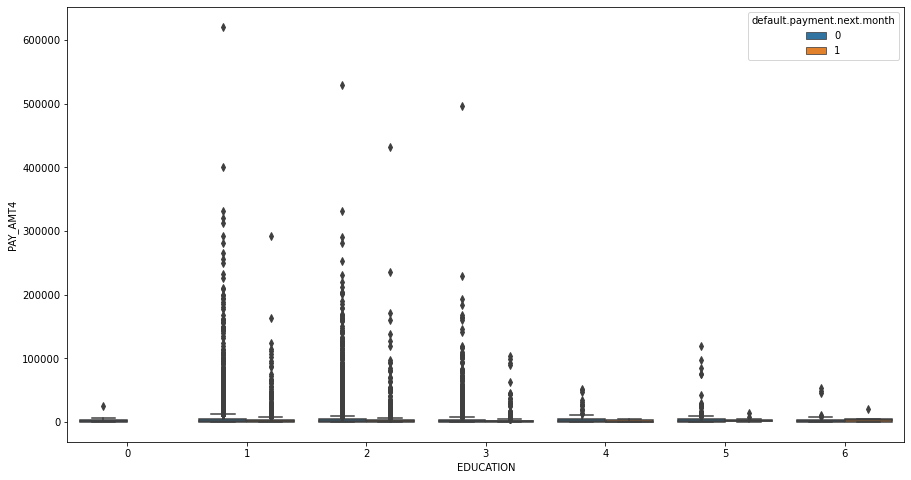

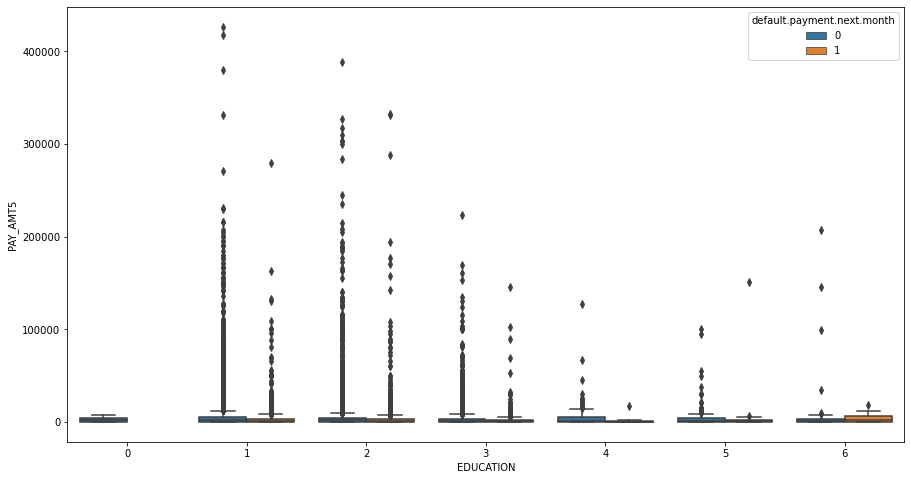

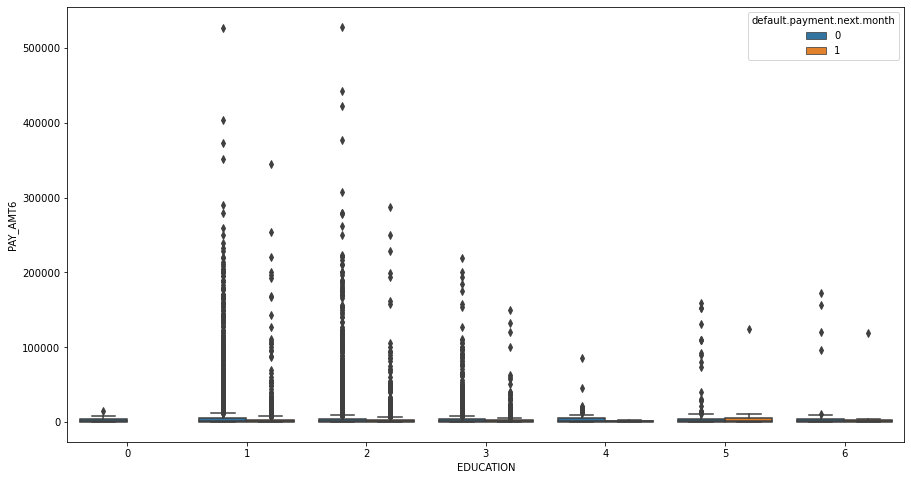

In [93]:
cols_payamt = ['PAY_AMT1','PAY_AMT2','PAY_AMT3','PAY_AMT4','PAY_AMT5','PAY_AMT6']
for i in cols_payamt:
    sns.boxplot(df['EDUCATION'],df[i],hue=df['default.payment.next.month'])
    plt.show()

Most of the non-defaulters with an education level of graduate and university have higher payment amounts.

##### LIMIT_BAL vs PAY_X with SEX as hue

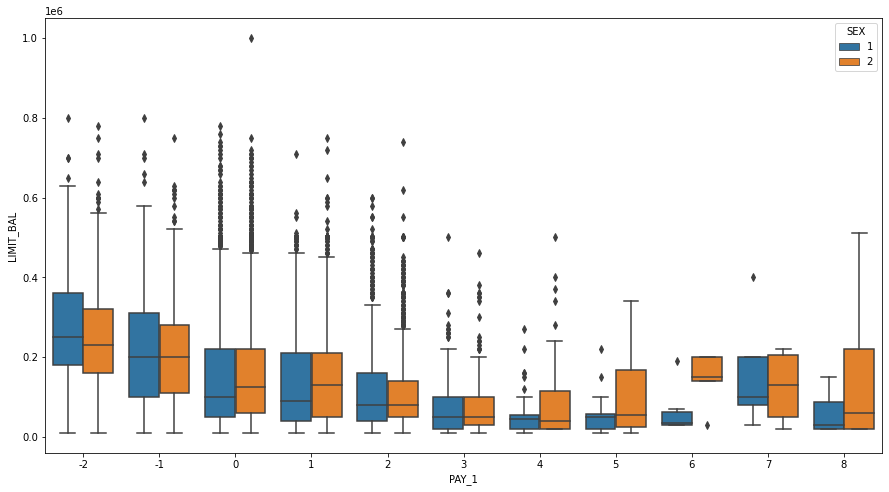

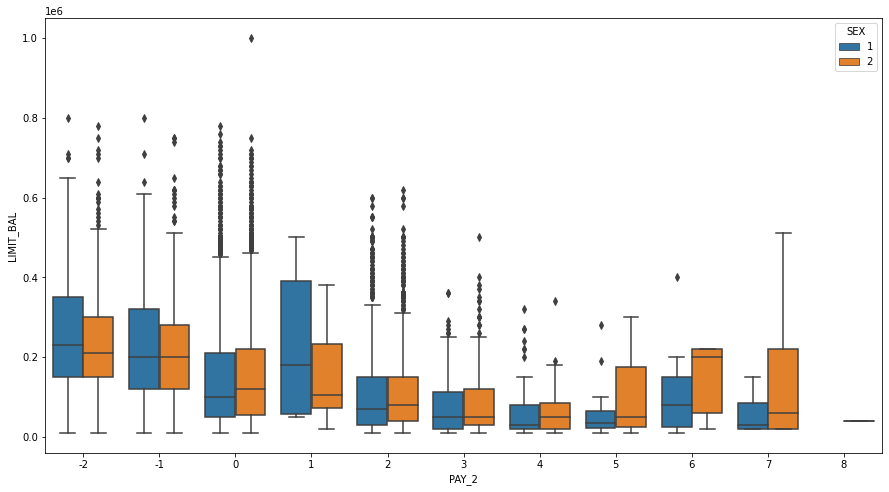

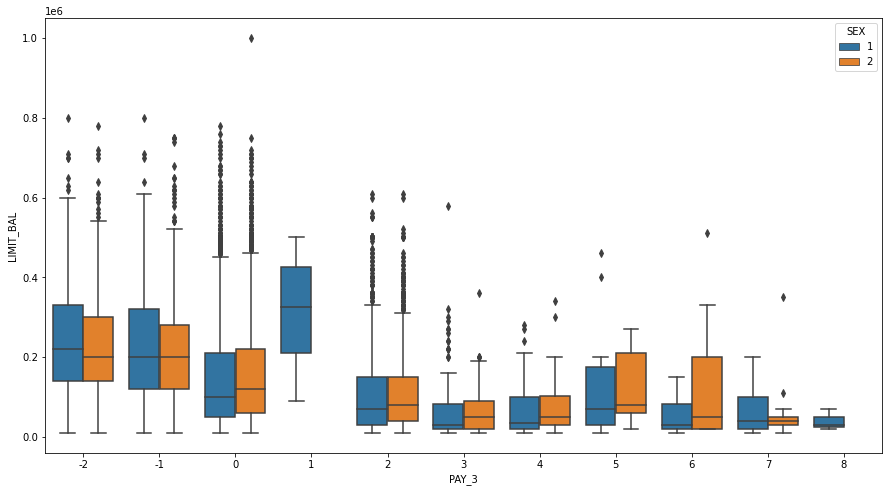

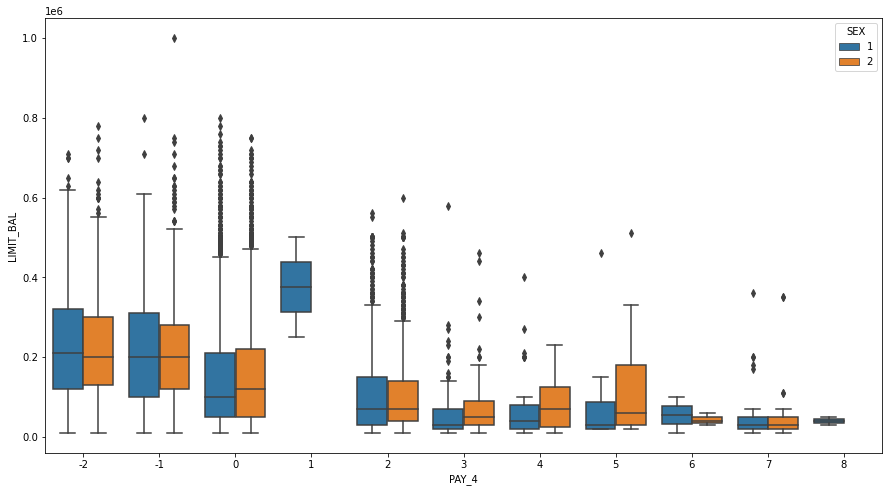

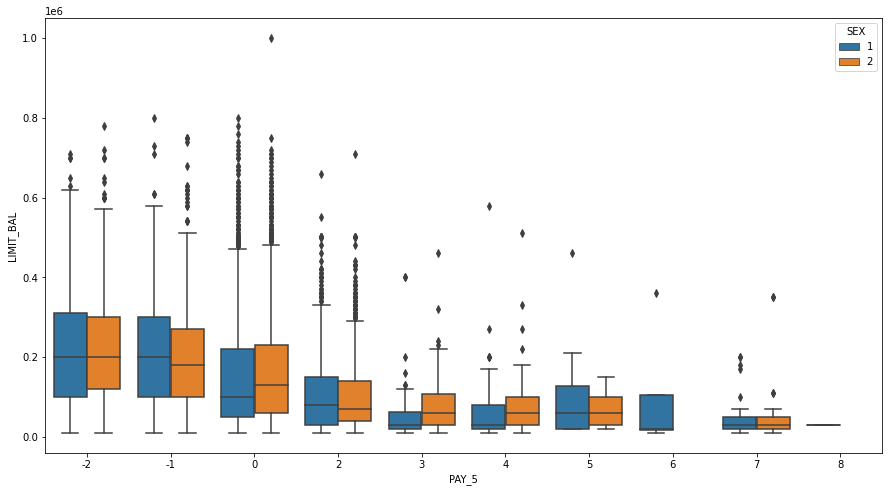

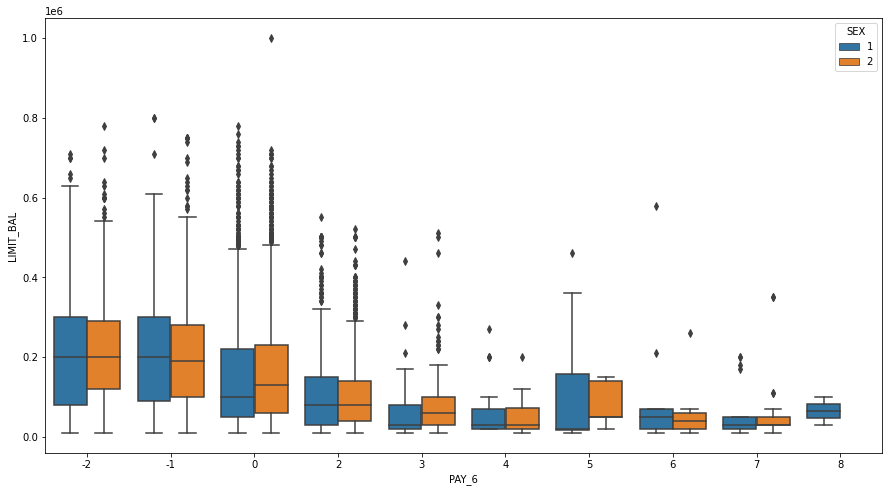

In [94]:
cols_pay = ['PAY_1','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6']
for i in cols_pay:
    sns.boxplot(df[i],df['LIMIT_BAL'],hue=df['SEX'])
    plt.show()

The limit balance reduces more for males with delay in payment as compared to the females.

##### LIMIT_BAL vs PAY_X with EDUCATION as hue

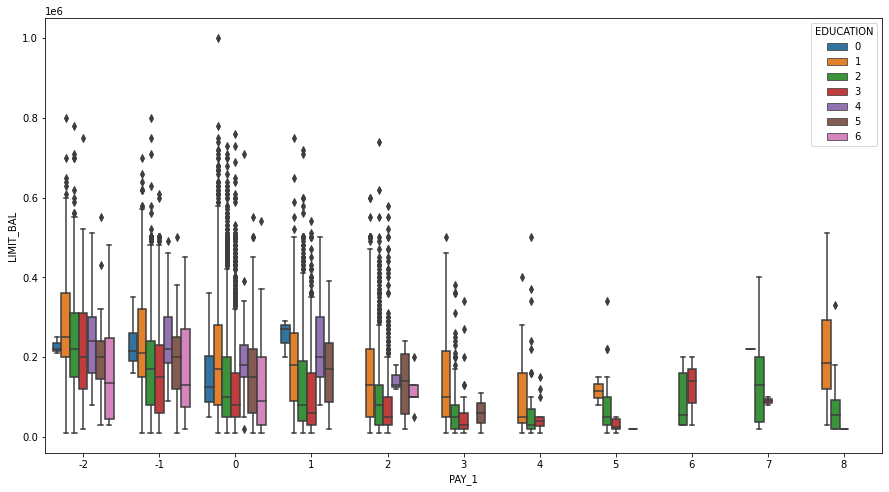

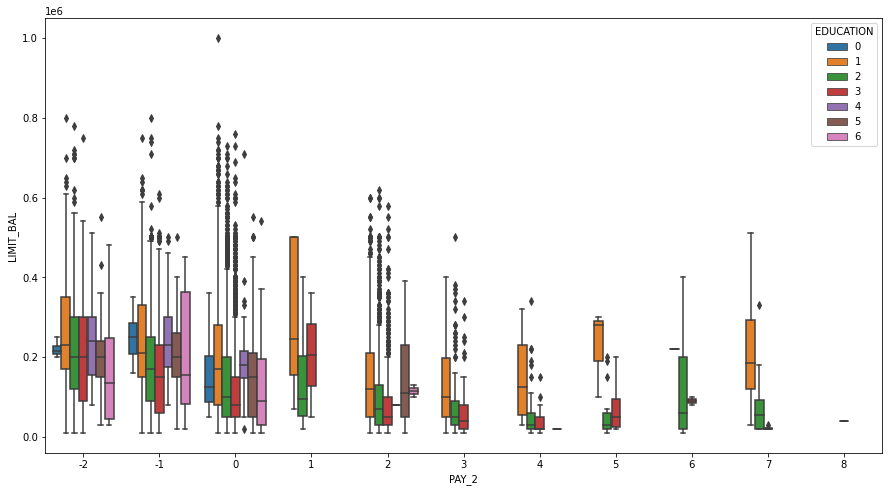

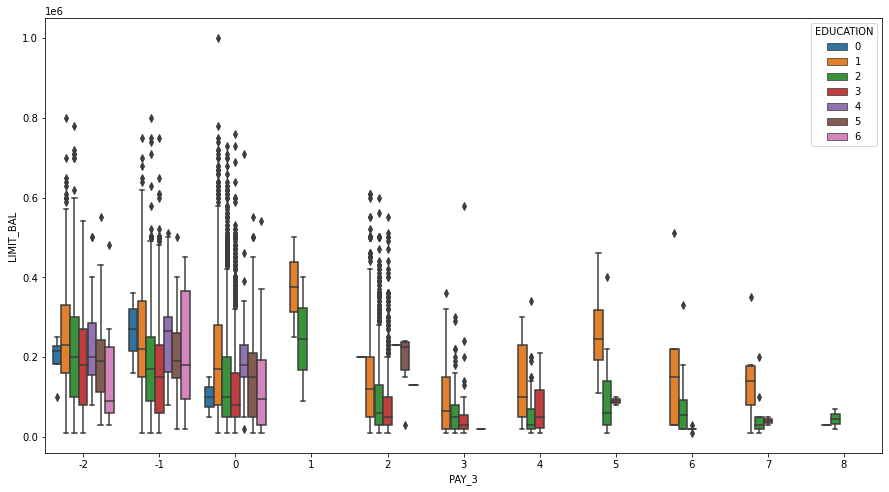

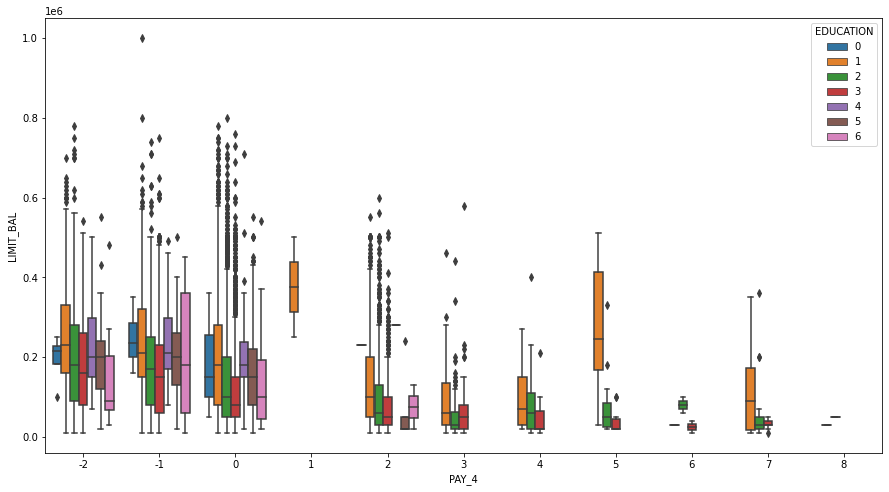

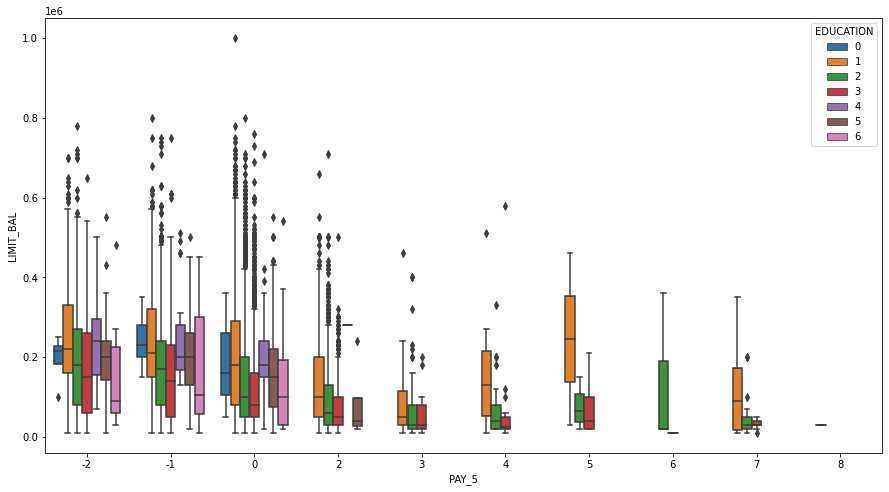

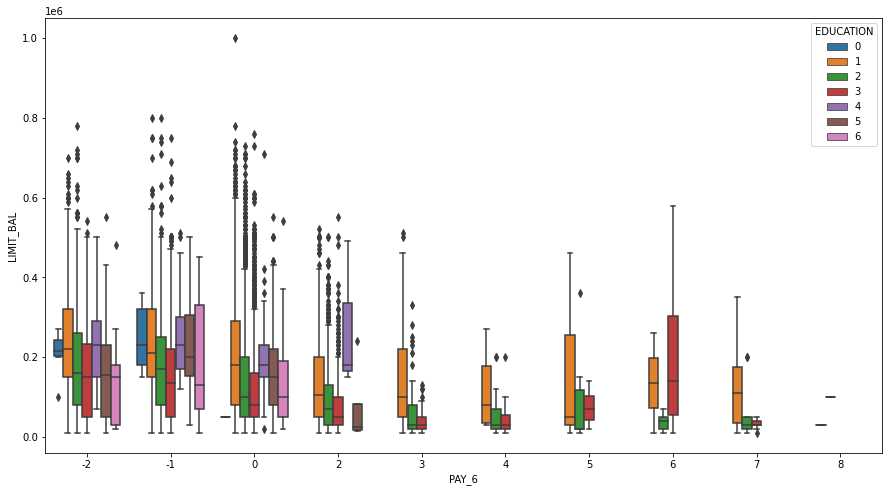

In [95]:
cols_pay = ['PAY_1','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6']
for i in cols_pay:
    sns.boxplot(df[i],df['LIMIT_BAL'],hue=df['EDUCATION'])
    plt.show()

The limit balance for graduates is higher while that for other educational qualifications reduces as the payment delay increases.

##### LIMIT_BAL vs PAY_X with MARRIAGE as hue

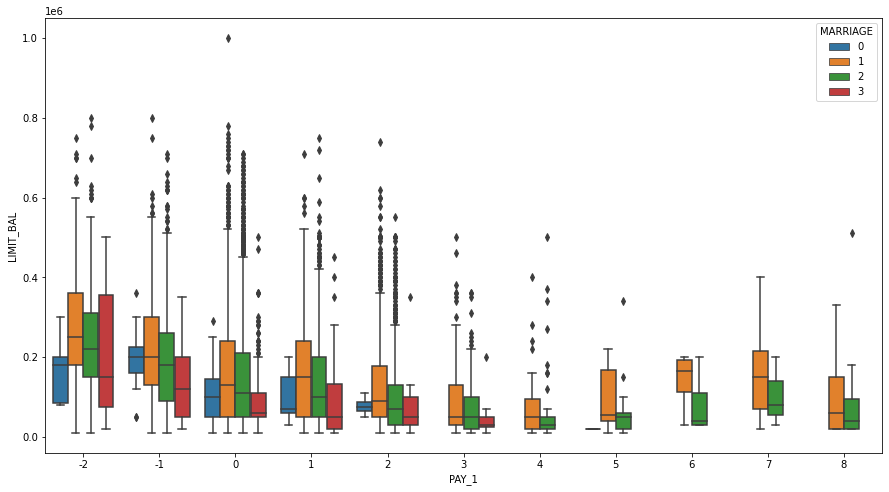

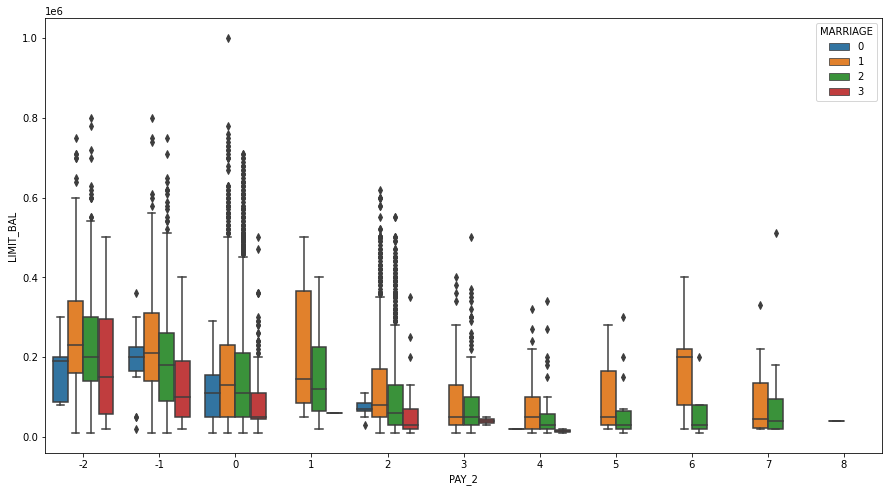

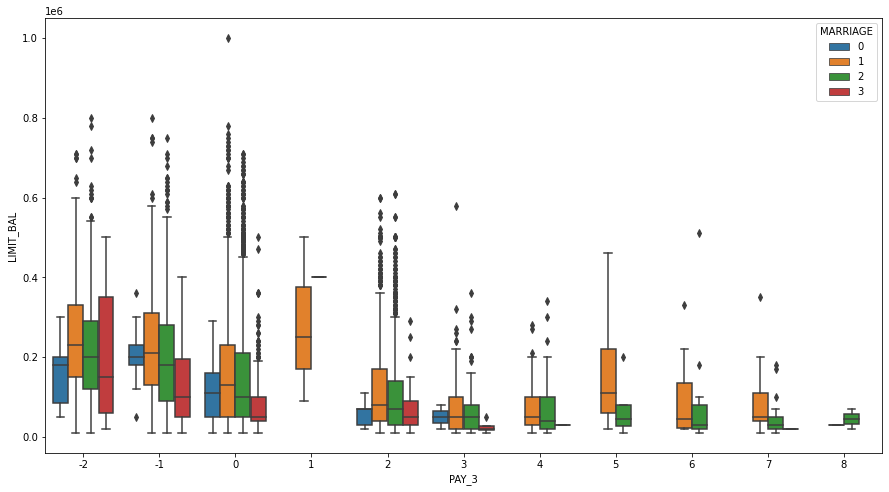

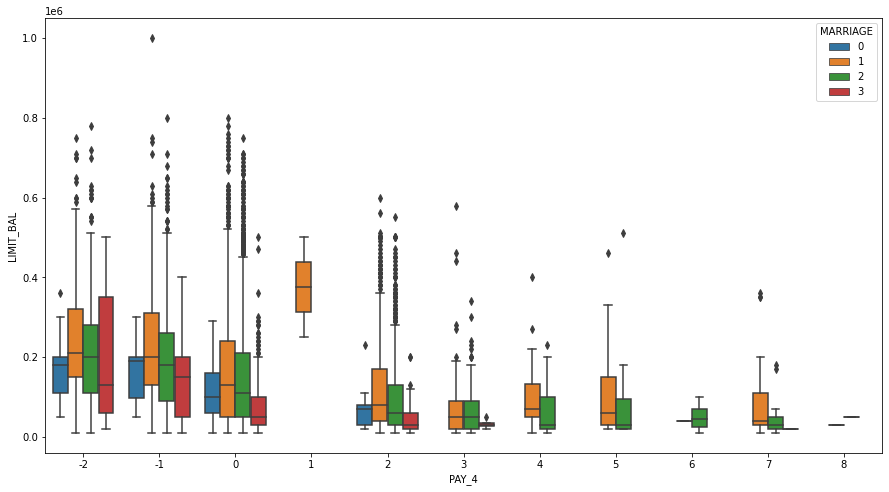

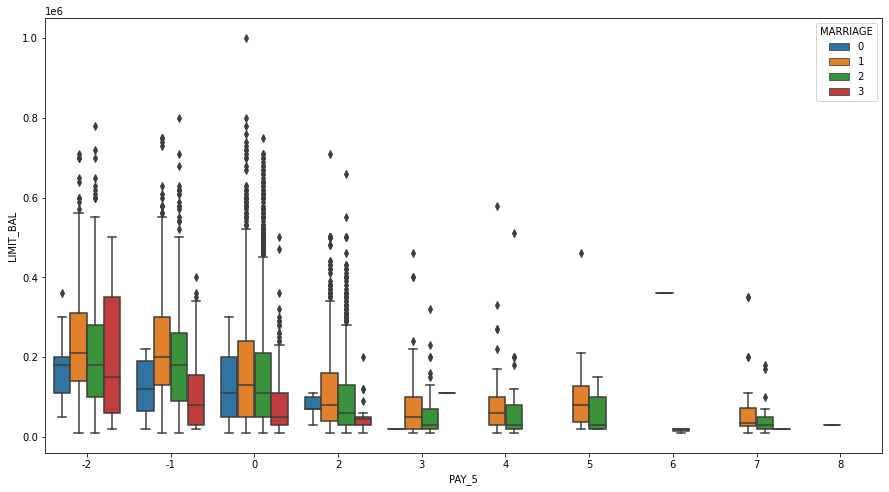

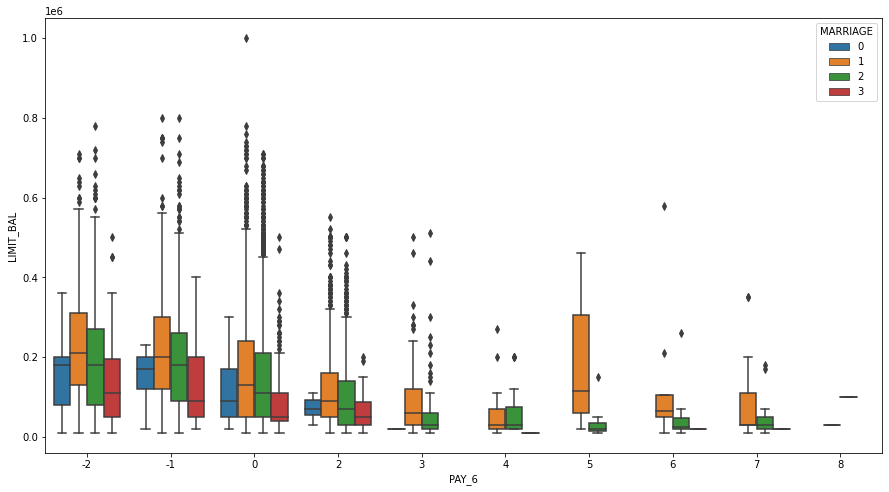

In [96]:
cols_pay = ['PAY_1','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6']
for i in cols_pay:
    sns.boxplot(df[i],df['LIMIT_BAL'],hue=df['MARRIAGE'])
    plt.show()

The limit balance for married customers is higher while that for other categories reduces as the payment delay increases.

### Transformation

In [97]:
from sklearn.preprocessing import PowerTransformer

In [98]:
pt = PowerTransformer(method = 'yeo-johnson')
for i in num_cols:
    df[i+'_trans'] = pt.fit_transform(df[[i]])
df.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT3_trans,BILL_AMT4_trans,BILL_AMT5_trans,BILL_AMT6_trans,PAY_AMT1_trans,PAY_AMT2_trans,PAY_AMT3_trans,PAY_AMT4_trans,PAY_AMT5_trans,PAY_AMT6_trans
0,20000.0,2,2,1,24,2,2,-1,-1,-2,...,-0.703133,-0.708335,-0.705134,-0.656065,-1.724472,-0.347889,-1.629996,-1.578070,-1.556978,-1.515825
1,120000.0,2,2,2,26,-1,2,0,0,0,...,-0.655283,-0.624273,-0.604623,-0.580055,-1.724472,-0.202757,-0.080144,0.009080,-1.556978,0.332020
2,90000.0,2,2,2,34,0,0,0,0,0,...,-0.445706,-0.405640,-0.358103,-0.343748,-0.064485,-0.031718,-0.080144,0.009080,0.018806,0.741487
3,50000.0,2,2,1,37,0,0,0,0,0,...,0.119568,-0.161996,-0.098021,-0.097838,0.063555,0.102920,-0.006222,0.046787,0.044891,0.059121
4,50000.0,1,2,1,57,-1,0,-1,0,0,...,-0.082447,-0.287765,-0.277290,-0.279323,0.063555,1.948535,1.066641,1.057406,-0.121440,-0.080835


In [99]:
num_cols1 =df.select_dtypes(include=np.number).columns
num_cols1

Index(['LIMIT_BAL', 'AGE', 'BILL_AMT1', 'BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4',
       'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1', 'PAY_AMT2', 'PAY_AMT3',
       'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6', 'LIMIT_BAL_trans', 'AGE_trans',
       'BILL_AMT1_trans', 'BILL_AMT2_trans', 'BILL_AMT3_trans',
       'BILL_AMT4_trans', 'BILL_AMT5_trans', 'BILL_AMT6_trans',
       'PAY_AMT1_trans', 'PAY_AMT2_trans', 'PAY_AMT3_trans', 'PAY_AMT4_trans',
       'PAY_AMT5_trans', 'PAY_AMT6_trans'],
      dtype='object')

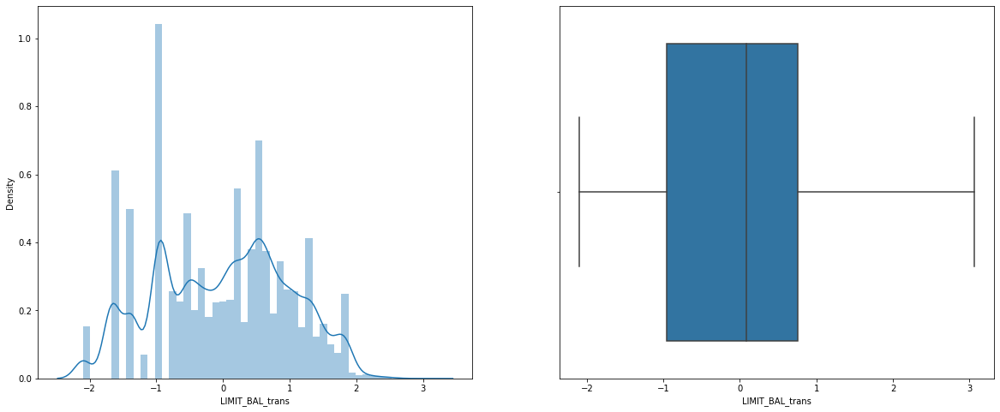

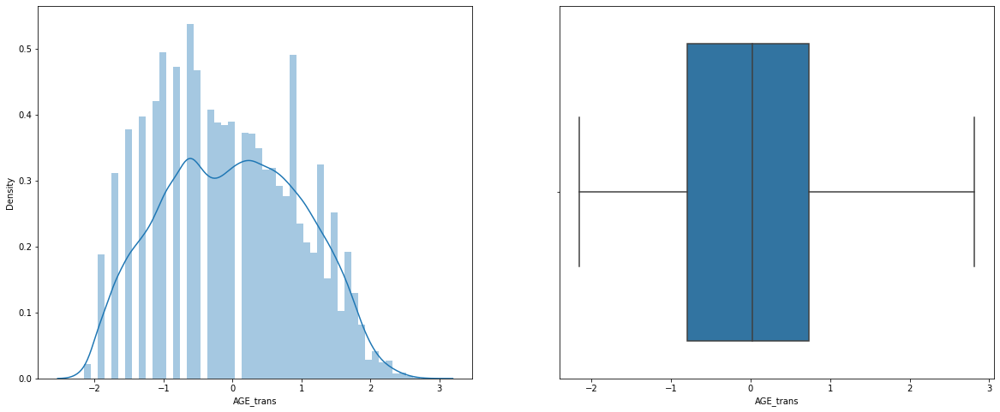

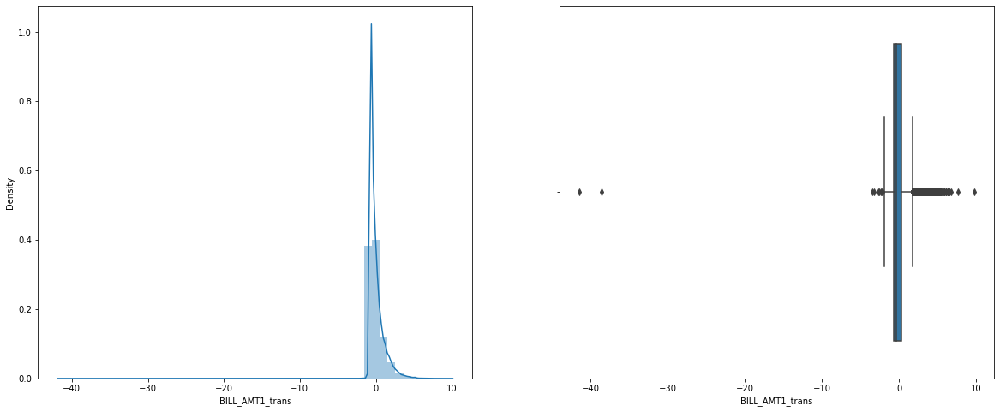

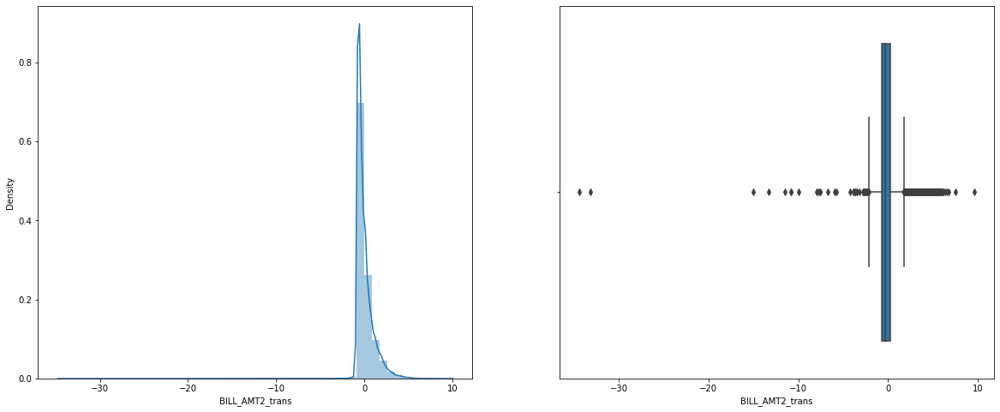

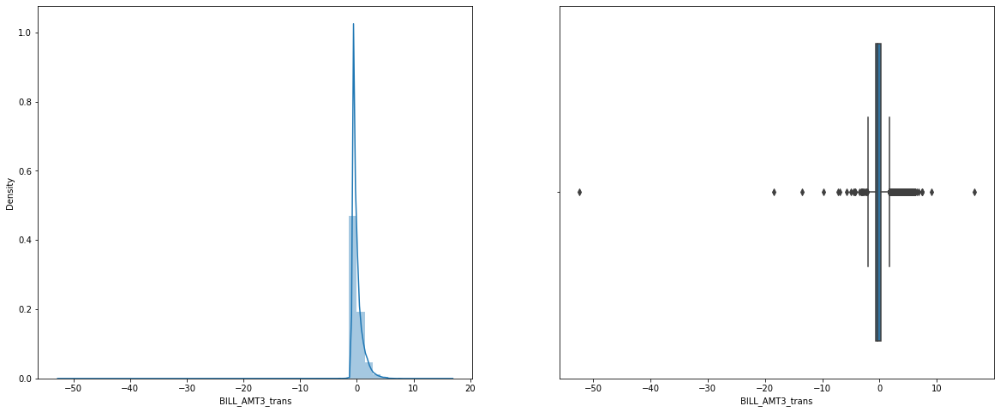

...

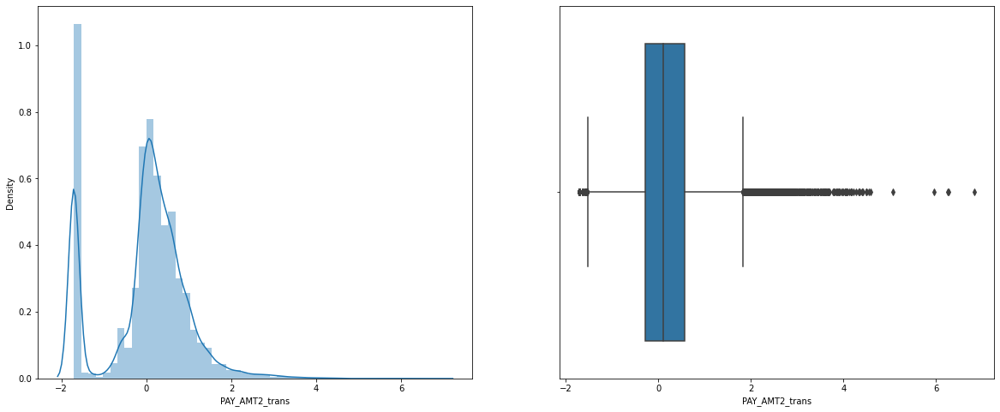

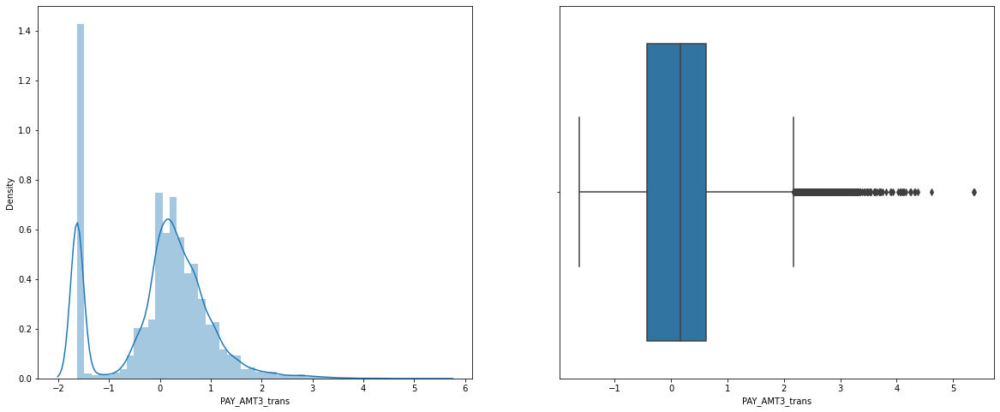

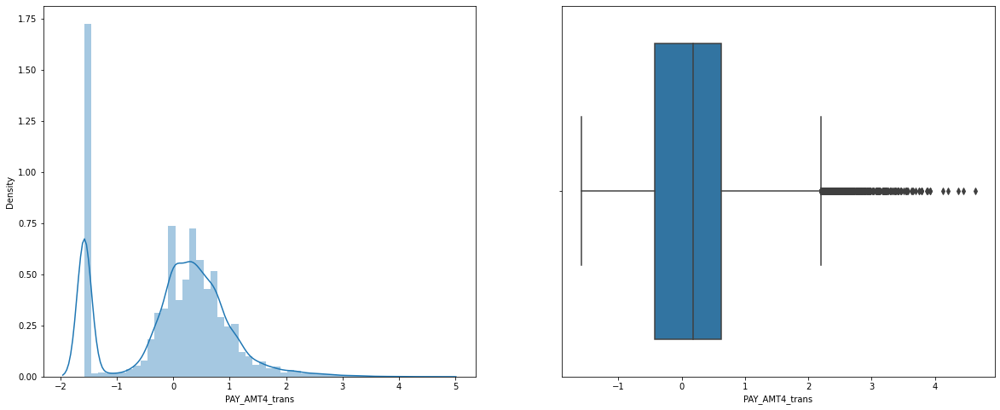

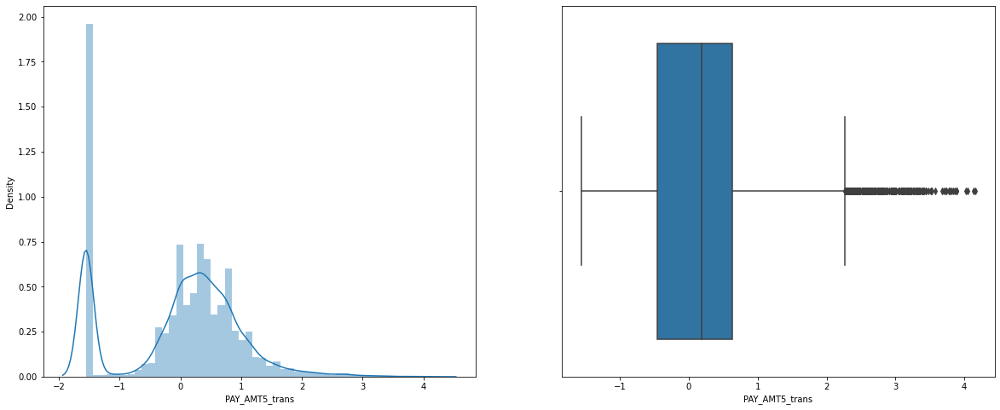

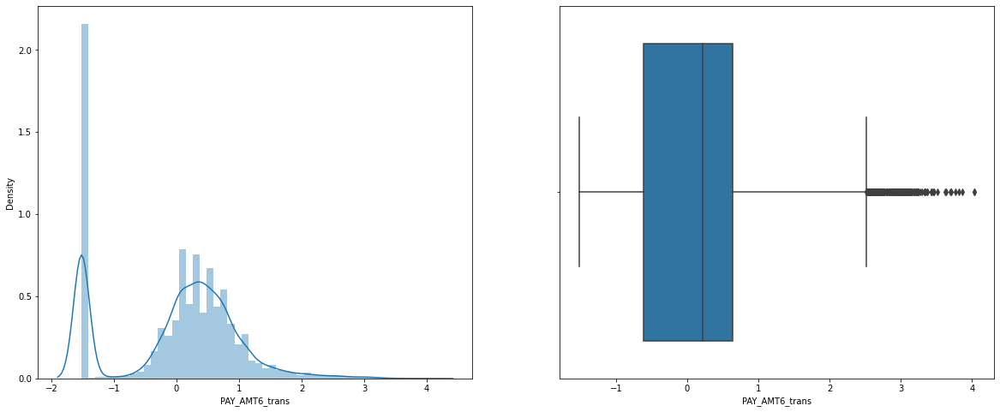

In [100]:
cols_trans = ['LIMIT_BAL_trans', 'AGE_trans',
       'BILL_AMT1_trans', 'BILL_AMT2_trans', 'BILL_AMT3_trans',
       'BILL_AMT4_trans', 'BILL_AMT5_trans', 'BILL_AMT6_trans',
       'PAY_AMT1_trans', 'PAY_AMT2_trans', 'PAY_AMT3_trans', 'PAY_AMT4_trans',
       'PAY_AMT5_trans', 'PAY_AMT6_trans']
for i in cols_trans:
    plt.figure(figsize=[20,8])
    plt.subplot(1,2,1)
    sns.distplot(df[i])
    plt.subplot(1,2,2)
    sns.boxplot(df[i])
    plt.show()

The transformation has improved the distibution of LIMIT_BAL, AGE and PAY_AMTX columns. However, the BILL_AMTX columns have not shown any significant improvements. So we will have to treat the outliers in a different manner. 

For improving the distribution, we will try different transformation - box-cox. But we need positive numbers. BILL_AMTX has negative values. To change the values, we will add the lowest negative value to each value to make all values positive.

In [101]:
cols = ["BILL_AMT1","BILL_AMT2","BILL_AMT3","BILL_AMT4","BILL_AMT5","BILL_AMT6"]
for i in cols:
    print('For column {} the mininum is {}'.format(i,df[i].min()))

For column BILL_AMT1 the mininum is -165580.0
For column BILL_AMT2 the mininum is -69777.0
For column BILL_AMT3 the mininum is -157264.0
For column BILL_AMT4 the mininum is -170000.0
For column BILL_AMT5 the mininum is -81334.0
For column BILL_AMT6 the mininum is -339603.0


We will add 165581 to BILL_AMT1, 69778 to BILL_AMT2, 157265 to BILL_AMT3, 170001 to BILL_AMT4, 81335 to BILL_AMT5, 339604 to BILL_AMT6

In [102]:
df['BILL_AMT1_pos'] = df['BILL_AMT1'] + 165581
df['BILL_AMT2_pos'] = df['BILL_AMT2'] + 69778
df['BILL_AMT3_pos'] = df['BILL_AMT3'] + 157265
df['BILL_AMT4_pos'] = df['BILL_AMT4'] + 170001
df['BILL_AMT5_pos'] = df['BILL_AMT5'] + 81335
df['BILL_AMT6_pos'] = df['BILL_AMT6'] + 339604

In [103]:
cols_pos = ["BILL_AMT1_pos","BILL_AMT2_pos","BILL_AMT3_pos","BILL_AMT4_pos","BILL_AMT5_pos","BILL_AMT6_pos"]
pt = PowerTransformer(method = 'box-cox')
for i in cols_pos:
    df[i+'_trans'] = pt.fit_transform(df[[i]])
df.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT3_pos,BILL_AMT4_pos,BILL_AMT5_pos,BILL_AMT6_pos,BILL_AMT1_pos_trans,BILL_AMT2_pos_trans,BILL_AMT3_pos_trans,BILL_AMT4_pos_trans,BILL_AMT5_pos_trans,BILL_AMT6_pos_trans
0,20000.0,2,2,1,24,2,2,-1,-1,-2,...,157954.0,170001.0,81335.0,339604.0,-0.744143,-0.830856,-0.797506,-0.787915,-0.852631,-0.701935
1,120000.0,2,2,2,26,-1,2,0,0,0,...,159947.0,173273.0,84790.0,342865.0,-0.770307,-0.874276,-0.751855,-0.711527,-0.741081,-0.635499
2,90000.0,2,2,2,34,0,0,0,0,0,...,170824.0,184332.0,96283.0,355153.0,-0.242513,-0.514044,-0.511889,-0.462964,-0.400862,-0.389629
3,50000.0,2,2,1,37,0,0,0,0,0,...,206556.0,198315.0,110294.0,369151.0,0.073326,0.253922,0.184992,-0.167920,-0.038284,-0.117727
4,50000.0,1,2,1,57,-1,0,-1,0,0,...,193100.0,190941.0,100481.0,358735.0,-0.645801,-0.752125,-0.062864,-0.320996,-0.286850,-0.319243


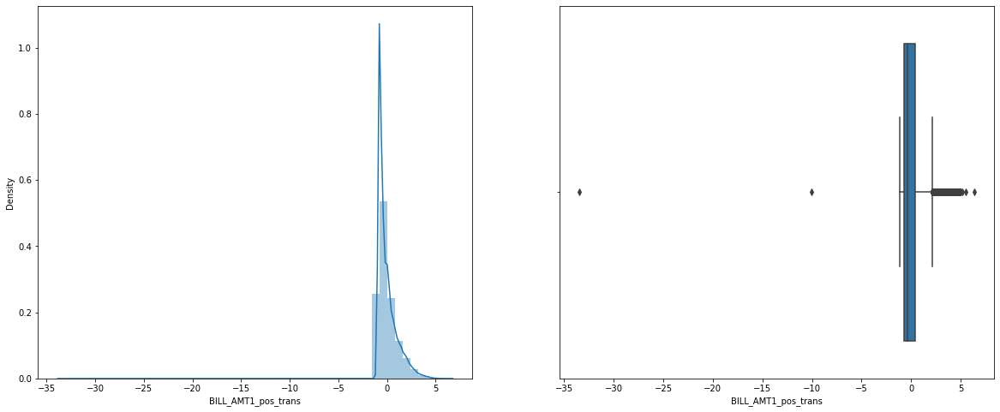

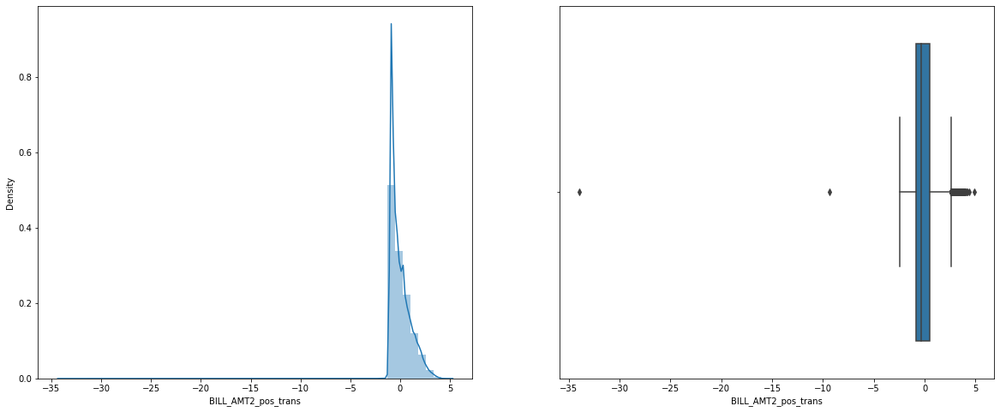

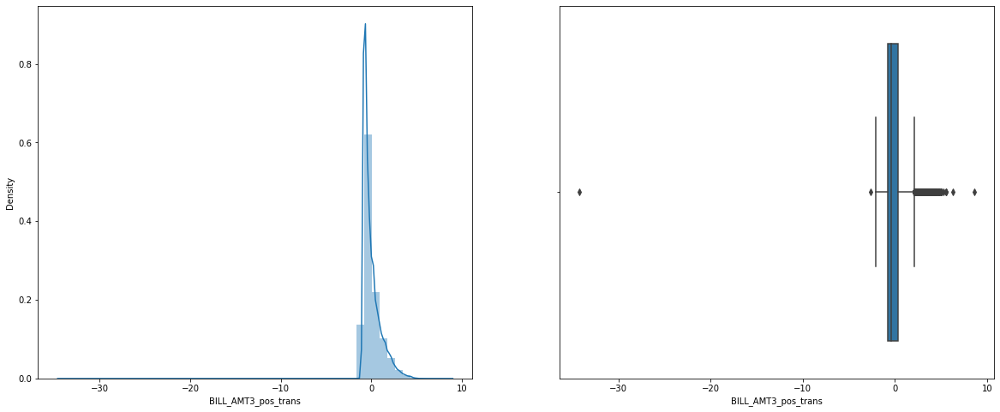

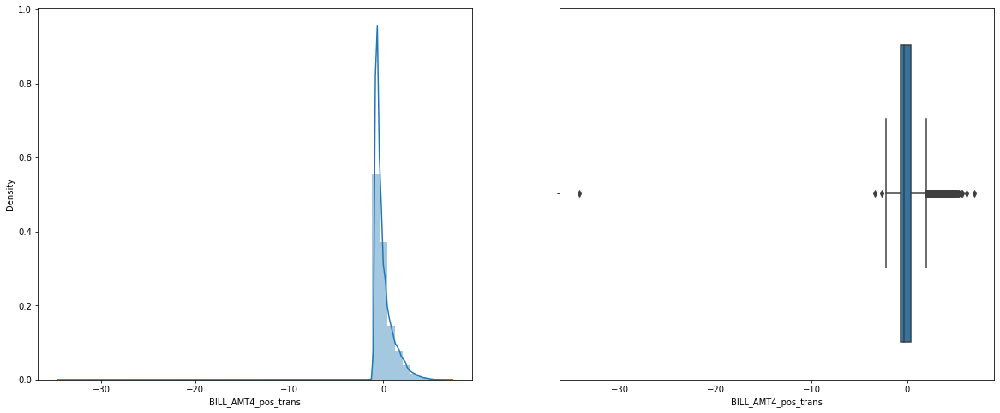

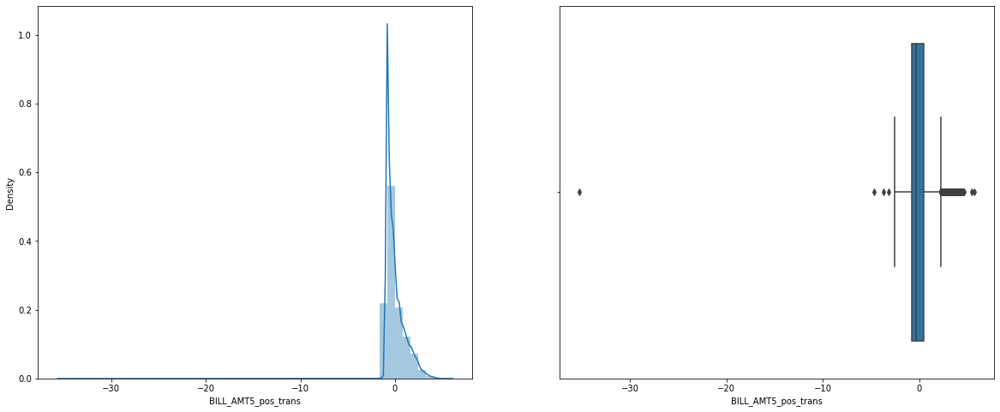

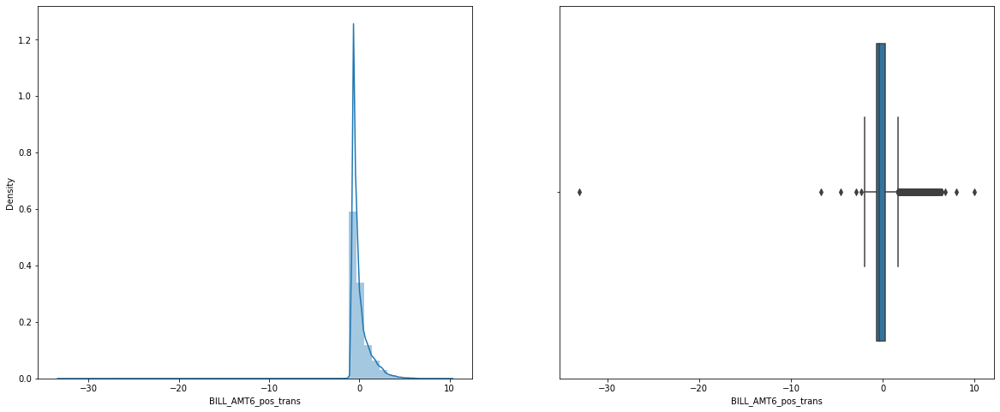

In [104]:
cols_pos = ["BILL_AMT1_pos_trans","BILL_AMT2_pos_trans","BILL_AMT3_pos_trans","BILL_AMT4_pos_trans","BILL_AMT5_pos_trans","BILL_AMT6_pos_trans"]
for i in cols_pos:
    plt.figure(figsize=[20,8])
    plt.subplot(1,2,1)
    sns.distplot(df[i])
    plt.subplot(1,2,2)
    sns.boxplot(df[i])
    plt.show()

### Statistical Analysis

In [105]:
from scipy import stats

H0: The variable is insignificant (no relationship between variable and target)
    
H1: The variable is significant (there is a relationship between variable and target)
    
We will carry out tests for each column w.r.t the target column

##### Categorical columns:

In [106]:
cat_cols = df.drop(['default.payment.next.month'],axis=1).select_dtypes(object).columns
cat_cols

Index(['SEX', 'EDUCATION', 'MARRIAGE', 'PAY_1', 'PAY_2', 'PAY_3', 'PAY_4',
       'PAY_5', 'PAY_6'],
      dtype='object')

When categorical columns need to be tested for significance when target is categorical, we will do a chi_square contingency test (for sex, education, marriage and PAY_X columns)

In [107]:
p_vals = {}
for i in cat_cols:
    table = pd.crosstab(df[i], df['default.payment.next.month'])
    observed_value = table.values
    chi2, p, dof, expected = stats.chi2_contingency(observed_value,correction=False)
    p_vals[i] = p
p_vals

{'SEX': 4.472804335813843e-12,
 'EDUCATION': 1.2332626245415605e-32,
 'MARRIAGE': 8.825862457577375e-08,
 'PAY_1': 0.0,
 'PAY_2': 0.0,
 'PAY_3': 0.0,
 'PAY_4': 0.0,
 'PAY_5': 0.0,
 'PAY_6': 0.0}

p_values for all these columns are less than 0.05. Hence, we reject the null hypothesis, concluding that all these columns are significant.

##### Numerical columns:

In [108]:
from statsmodels.stats import weightstats as stests

In [109]:
num_cols = df.drop(['default.payment.next.month'],axis=1).select_dtypes(np.number).columns
num_cols

Index(['LIMIT_BAL', 'AGE', 'BILL_AMT1', 'BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4',
       'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1', 'PAY_AMT2', 'PAY_AMT3',
       'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6', 'LIMIT_BAL_trans', 'AGE_trans',
       'BILL_AMT1_trans', 'BILL_AMT2_trans', 'BILL_AMT3_trans',
       'BILL_AMT4_trans', 'BILL_AMT5_trans', 'BILL_AMT6_trans',
       'PAY_AMT1_trans', 'PAY_AMT2_trans', 'PAY_AMT3_trans', 'PAY_AMT4_trans',
       'PAY_AMT5_trans', 'PAY_AMT6_trans', 'BILL_AMT1_pos', 'BILL_AMT2_pos',
       'BILL_AMT3_pos', 'BILL_AMT4_pos', 'BILL_AMT5_pos', 'BILL_AMT6_pos',
       'BILL_AMT1_pos_trans', 'BILL_AMT2_pos_trans', 'BILL_AMT3_pos_trans',
       'BILL_AMT4_pos_trans', 'BILL_AMT5_pos_trans', 'BILL_AMT6_pos_trans'],
      dtype='object')

In [110]:
num_cols = ['LIMIT_BAL', 'AGE', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6',]

When numerical columns need to be tested for significance when target is categorical, we will do a two sample mean test (for LIMIT_BAL, AGE, BILL_AMTX and PAY_AMTX columns) 

In [111]:
df['default.payment.next.month'].value_counts()

# The two categories of the target are large samples, hence we can do z test.

0    23364
1     6636
Name: default.payment.next.month, dtype: int64

In [112]:
p_val = {}
for i in num_cols:
    x1 = df[(df['default.payment.next.month'] == 0)][i]
    x2 = df[(df['default.payment.next.month'] == 1)][i]
    z_score, pval = stests.ztest(x1 = x1, x2 = x2 , value = 0, alternative = 'two-sided')
    p_val[i] = pval
p_val

{'LIMIT_BAL': 1.7456891860689276e-159,
 'AGE': 0.016130835407188793,
 'BILL_AMT1': 0.000666458894348233,
 'BILL_AMT2': 0.013951754044408744,
 'BILL_AMT3': 0.01476421905131808,
 'BILL_AMT4': 0.07854544833719244,
 'BILL_AMT5': 0.24162514177412497,
 'BILL_AMT6': 0.3521150333737273,
 'PAY_AMT1': 9.234672141977337e-37,
 'PAY_AMT2': 2.8928830381533725e-24,
 'PAY_AMT3': 1.705316820236147e-22,
 'PAY_AMT4': 6.304758938546825e-23,
 'PAY_AMT5': 1.1562201413814998e-21,
 'PAY_AMT6': 2.8522640944438073e-20}

The p_values for BILL_AMT4, BILL_AMT5 and BILL_AMT6 are greater than 0.05. Hence, we fail to reject the null hypothesis. Hence, these columns are statistically insignificant.

### Encoding

We will try two encoding methods - we will do dummy encoding and label encoding for the categorical columns.

##### Dummy encoding:

In [113]:
df1 = df.copy()

In [114]:
df1.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT3_pos,BILL_AMT4_pos,BILL_AMT5_pos,BILL_AMT6_pos,BILL_AMT1_pos_trans,BILL_AMT2_pos_trans,BILL_AMT3_pos_trans,BILL_AMT4_pos_trans,BILL_AMT5_pos_trans,BILL_AMT6_pos_trans
0,20000.0,2,2,1,24,2,2,-1,-1,-2,...,157954.0,170001.0,81335.0,339604.0,-0.744143,-0.830856,-0.797506,-0.787915,-0.852631,-0.701935
1,120000.0,2,2,2,26,-1,2,0,0,0,...,159947.0,173273.0,84790.0,342865.0,-0.770307,-0.874276,-0.751855,-0.711527,-0.741081,-0.635499
2,90000.0,2,2,2,34,0,0,0,0,0,...,170824.0,184332.0,96283.0,355153.0,-0.242513,-0.514044,-0.511889,-0.462964,-0.400862,-0.389629
3,50000.0,2,2,1,37,0,0,0,0,0,...,206556.0,198315.0,110294.0,369151.0,0.073326,0.253922,0.184992,-0.167920,-0.038284,-0.117727
4,50000.0,1,2,1,57,-1,0,-1,0,0,...,193100.0,190941.0,100481.0,358735.0,-0.645801,-0.752125,-0.062864,-0.320996,-0.286850,-0.319243


In [115]:
df1 = pd.get_dummies(df1, columns = ['SEX','EDUCATION','MARRIAGE','PAY_1','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6','default.payment.next.month'],drop_first = True)
df1.head()

,LIMIT_BAL,AGE,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,...,PAY_6_-1,PAY_6_0,PAY_6_2,PAY_6_3,PAY_6_4,PAY_6_5,PAY_6_6,PAY_6_7,PAY_6_8,default.payment.next.month_1
0,20000.0,24,3913.0,3102.0,689.0,0.0,0.0,0.0,0.0,689.0,...,0,0,0,0,0,0,0,0,0,1
1,120000.0,26,2682.0,1725.0,2682.0,3272.0,3455.0,3261.0,0.0,1000.0,...,0,0,1,0,0,0,0,0,0,1
2,90000.0,34,29239.0,14027.0,13559.0,14331.0,14948.0,15549.0,1518.0,1500.0,...,0,1,0,0,0,0,0,0,0,0
3,50000.0,37,46990.0,48233.0,49291.0,28314.0,28959.0,29547.0,2000.0,2019.0,...,0,1,0,0,0,0,0,0,0,0
4,50000.0,57,8617.0,5670.0,35835.0,20940.0,19146.0,19131.0,2000.0,36681.0,...,0,1,0,0,0,0,0,0,0,0


##### Label Encoding

For SEX, MARRIAGE and target column, we can just change the datatype to numerical as they are already labelled appropriately.
For other columns, we will carry out label encoding by using 'replace'.

In [116]:
df['SEX'] = df['SEX'].astype(int)

In [117]:
df['MARRIAGE'] = df['MARRIAGE'].astype(int)

In [118]:
df['default.payment.next.month'] = df['default.payment.next.month'].astype(int)

In [119]:
df['EDUCATION'].unique()

# In education column, 0,5 and 6 are all unknown. We can combine these into one category - 'unknown'
# 1 is graduate level, 2 is university level, 3 is high school level and 4 is others

array([2, 1, 3, 5, 4, 6, 0], dtype=object)

In [120]:
def encode_edu(x):
    if x in (0,5,6):
        return 0
    else:
        return int(x)

In [121]:
df['EDUCATION'] = df['EDUCATION'].apply(encode_edu)
df['EDUCATION'].unique()

array([2, 1, 3, 0, 4], dtype=int64)

In [122]:
df['PAY_1'].unique()

array([2, -1, 0, -2, 1, 3, 4, 8, 7, 5, 6], dtype=object)

In [123]:
def encode_pay(x):
    if x == -2:
        return 0
    if x == -1:
        return -2
    if x == 0:
        return -1
    else:
        return x
    
# For PAY columns, we are changing -2 to 0, so as to mark inactive customers as 0 
# Then we will change -1 to -2 which is Paid duly and 0 to -1 which is revolving credit.
# 1-8 will remain as is to indicate delay of payment by the number of months same as the number. 

In [124]:
pay_list = ['PAY_1','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6']

In [125]:
for i in pay_list:
    df[i] = df[i].apply(encode_pay)

In [126]:
df['PAY_1'].unique()

array([ 2, -2, -1,  0,  1,  3,  4,  8,  7,  5,  6], dtype=int64)

**We will make four dataframes - two with the original columns, out of which one is dummy encoded and one is label encoded and two containing the transformed columns, out of which one is dummy encoded and one is label encoded.**

In [127]:
df_orig_dummy = df1.drop(['LIMIT_BAL_trans', 'AGE_trans',
       'BILL_AMT1_trans', 'BILL_AMT2_trans', 'BILL_AMT3_trans',
       'BILL_AMT4_trans', 'BILL_AMT5_trans', 'BILL_AMT6_trans',
       'PAY_AMT1_trans', 'PAY_AMT2_trans', 'PAY_AMT3_trans', 'PAY_AMT4_trans',
       'PAY_AMT5_trans', 'PAY_AMT6_trans',"BILL_AMT1_pos_trans","BILL_AMT2_pos_trans",
        "BILL_AMT3_pos_trans","BILL_AMT4_pos_trans","BILL_AMT5_pos_trans","BILL_AMT6_pos_trans",
        "BILL_AMT1_pos","BILL_AMT2_pos","BILL_AMT3_pos","BILL_AMT4_pos","BILL_AMT5_pos","BILL_AMT6_pos"],axis=1)
df_orig_dummy.head()

,LIMIT_BAL,AGE,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,...,PAY_6_-1,PAY_6_0,PAY_6_2,PAY_6_3,PAY_6_4,PAY_6_5,PAY_6_6,PAY_6_7,PAY_6_8,default.payment.next.month_1
0,20000.0,24,3913.0,3102.0,689.0,0.0,0.0,0.0,0.0,689.0,...,0,0,0,0,0,0,0,0,0,1
1,120000.0,26,2682.0,1725.0,2682.0,3272.0,3455.0,3261.0,0.0,1000.0,...,0,0,1,0,0,0,0,0,0,1
2,90000.0,34,29239.0,14027.0,13559.0,14331.0,14948.0,15549.0,1518.0,1500.0,...,0,1,0,0,0,0,0,0,0,0
3,50000.0,37,46990.0,48233.0,49291.0,28314.0,28959.0,29547.0,2000.0,2019.0,...,0,1,0,0,0,0,0,0,0,0
4,50000.0,57,8617.0,5670.0,35835.0,20940.0,19146.0,19131.0,2000.0,36681.0,...,0,1,0,0,0,0,0,0,0,0


In [128]:
df_orig_label = df.drop(['LIMIT_BAL_trans', 'AGE_trans',
       'BILL_AMT1_trans', 'BILL_AMT2_trans', 'BILL_AMT3_trans',
       'BILL_AMT4_trans', 'BILL_AMT5_trans', 'BILL_AMT6_trans',
       'PAY_AMT1_trans', 'PAY_AMT2_trans', 'PAY_AMT3_trans', 'PAY_AMT4_trans',
       'PAY_AMT5_trans', 'PAY_AMT6_trans',"BILL_AMT1_pos_trans","BILL_AMT2_pos_trans",
        "BILL_AMT3_pos_trans","BILL_AMT4_pos_trans","BILL_AMT5_pos_trans","BILL_AMT6_pos_trans",
        "BILL_AMT1_pos","BILL_AMT2_pos","BILL_AMT3_pos","BILL_AMT4_pos","BILL_AMT5_pos","BILL_AMT6_pos"],axis=1)
df_orig_label.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,20000.0,2,2,1,24,2,2,-2,-2,0,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,120000.0,2,2,2,26,-2,2,-1,-1,-1,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,90000.0,2,2,2,34,-1,-1,-1,-1,-1,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,50000.0,2,2,1,37,-1,-1,-1,-1,-1,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,50000.0,1,2,1,57,-2,-1,-2,-1,-1,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


In [129]:
df_trans_dummy = df1.drop(['LIMIT_BAL', 'AGE', 'BILL_AMT1', 'BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4',
       'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1', 'PAY_AMT2', 'PAY_AMT3',
       'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6',"BILL_AMT1_pos_trans","BILL_AMT2_pos_trans",
        "BILL_AMT3_pos_trans","BILL_AMT4_pos_trans","BILL_AMT5_pos_trans","BILL_AMT6_pos_trans",
        "BILL_AMT1_pos","BILL_AMT2_pos","BILL_AMT3_pos","BILL_AMT4_pos","BILL_AMT5_pos","BILL_AMT6_pos"],axis=1)
df_trans_dummy.head()

,LIMIT_BAL_trans,AGE_trans,BILL_AMT1_trans,BILL_AMT2_trans,BILL_AMT3_trans,BILL_AMT4_trans,BILL_AMT5_trans,BILL_AMT6_trans,PAY_AMT1_trans,PAY_AMT2_trans,...,PAY_6_-1,PAY_6_0,PAY_6_2,PAY_6_3,PAY_6_4,PAY_6_5,PAY_6_6,PAY_6_7,PAY_6_8,default.payment.next.month_1
0,-1.665383,-1.505599,-0.654786,-0.666975,-0.703133,-0.708335,-0.705134,-0.656065,-1.724472,-0.347889,...,0,0,0,0,0,0,0,0,0,1
1,-0.090364,-1.134225,-0.679304,-0.700056,-0.655283,-0.624273,-0.604623,-0.580055,-1.724472,-0.202757,...,0,0,1,0,0,0,0,0,0,1
2,-0.396704,0.016042,-0.239392,-0.451718,-0.445706,-0.405640,-0.358103,-0.343748,-0.064485,-0.031718,...,0,1,0,0,0,0,0,0,0,0
3,-0.953920,0.349978,0.017236,0.089416,0.119568,-0.161996,-0.098021,-0.097838,0.063555,0.102920,...,0,1,0,0,0,0,0,0,0,0
4,-0.953920,1.862737,-0.568415,-0.611116,-0.082447,-0.287765,-0.277290,-0.279323,0.063555,1.948535,...,0,1,0,0,0,0,0,0,0,0


In [130]:
df_trans_label = df.drop(['LIMIT_BAL', 'AGE', 'BILL_AMT1', 'BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4',
       'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1', 'PAY_AMT2', 'PAY_AMT3',
       'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6',"BILL_AMT1_pos_trans","BILL_AMT2_pos_trans",
        "BILL_AMT3_pos_trans","BILL_AMT4_pos_trans","BILL_AMT5_pos_trans","BILL_AMT6_pos_trans",
        "BILL_AMT1_pos","BILL_AMT2_pos","BILL_AMT3_pos","BILL_AMT4_pos","BILL_AMT5_pos","BILL_AMT6_pos"],axis=1)
df_trans_label.head()

,SEX,EDUCATION,MARRIAGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,default.payment.next.month,...,BILL_AMT3_trans,BILL_AMT4_trans,BILL_AMT5_trans,BILL_AMT6_trans,PAY_AMT1_trans,PAY_AMT2_trans,PAY_AMT3_trans,PAY_AMT4_trans,PAY_AMT5_trans,PAY_AMT6_trans
0,2,2,1,2,2,-2,-2,0,0,1,...,-0.703133,-0.708335,-0.705134,-0.656065,-1.724472,-0.347889,-1.629996,-1.578070,-1.556978,-1.515825
1,2,2,2,-2,2,-1,-1,-1,2,1,...,-0.655283,-0.624273,-0.604623,-0.580055,-1.724472,-0.202757,-0.080144,0.009080,-1.556978,0.332020
2,2,2,2,-1,-1,-1,-1,-1,-1,0,...,-0.445706,-0.405640,-0.358103,-0.343748,-0.064485,-0.031718,-0.080144,0.009080,0.018806,0.741487
3,2,2,1,-1,-1,-1,-1,-1,-1,0,...,0.119568,-0.161996,-0.098021,-0.097838,0.063555,0.102920,-0.006222,0.046787,0.044891,0.059121
4,1,2,1,-2,-1,-2,-1,-1,-1,0,...,-0.082447,-0.287765,-0.277290,-0.279323,0.063555,1.948535,1.066641,1.057406,-0.121440,-0.080835


### Train-Test Split

##### For the dataframe with original columns and dummy encoding:

In [131]:
X_orig_dummy = df_orig_dummy.drop(['default.payment.next.month_1'],axis=1)
y_orig_dummy = df_orig_dummy['default.payment.next.month_1']

Xtrain_orig_dummy, Xtest_orig_dummy, ytrain_orig_dummy, ytest_orig_dummy = train_test_split(X_orig_dummy,y_orig_dummy,test_size=0.30,random_state=42)
print(Xtrain_orig_dummy.shape)
print(Xtest_orig_dummy.shape)
print(ytrain_orig_dummy.shape)
print(ytest_orig_dummy.shape)

(21000, 82)
(9000, 82)
(21000,)
(9000,)


##### For the dataframe with transformed columns and dummy encoding:

In [132]:
X_trans_dummy = df_trans_dummy.drop(['default.payment.next.month_1'],axis=1)
y_trans_dummy = df_trans_dummy['default.payment.next.month_1']

Xtrain_trans_dummy, Xtest_trans_dummy, ytrain_trans_dummy, ytest_trans_dummy = train_test_split(X_trans_dummy,y_trans_dummy,test_size=0.30,random_state=42)
print(Xtrain_trans_dummy.shape)
print(Xtest_trans_dummy.shape)
print(ytrain_trans_dummy.shape)
print(ytest_trans_dummy.shape)

(21000, 82)
(9000, 82)
(21000,)
(9000,)


##### For the dataframe with original columns and label encoding:

In [133]:
X_orig_label = df_orig_label.drop(['default.payment.next.month'],axis=1)
y_orig_label = df_orig_label['default.payment.next.month']

Xtrain_orig_label, Xtest_orig_label, ytrain_orig_label, ytest_orig_label = train_test_split(X_orig_label,y_orig_label,test_size=0.30,random_state=42)
print(Xtrain_orig_label.shape)
print(Xtest_orig_label.shape)
print(ytrain_orig_label.shape)
print(ytest_orig_label.shape)

(21000, 23)
(9000, 23)
(21000,)
(9000,)


##### For the dataframe with transformed columns and label encoding:

In [134]:
X_trans_label = df_trans_label.drop(['default.payment.next.month'],axis=1)
y_trans_label = df_trans_label['default.payment.next.month']

Xtrain_trans_label, Xtest_trans_label, ytrain_trans_label, ytest_trans_label = train_test_split(X_trans_label,y_trans_label,test_size=0.30,random_state=42)
print(Xtrain_trans_label.shape)
print(Xtest_trans_label.shape)
print(ytrain_trans_label.shape)
print(ytest_trans_label.shape)

(21000, 23)
(9000, 23)
(21000,)
(9000,)


### Scaling

In [135]:
Xtrain_orig_dummy.columns

Index(['LIMIT_BAL', 'AGE', 'BILL_AMT1', 'BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4',
       'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1', 'PAY_AMT2', 'PAY_AMT3',
       'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6', 'SEX_2', 'EDUCATION_1',
       'EDUCATION_2', 'EDUCATION_3', 'EDUCATION_4', 'EDUCATION_5',
       'EDUCATION_6', 'MARRIAGE_1', 'MARRIAGE_2', 'MARRIAGE_3', 'PAY_1_-1',
       'PAY_1_0', 'PAY_1_1', 'PAY_1_2', 'PAY_1_3', 'PAY_1_4', 'PAY_1_5',
       'PAY_1_6', 'PAY_1_7', 'PAY_1_8', 'PAY_2_-1', 'PAY_2_0', 'PAY_2_1',
       'PAY_2_2', 'PAY_2_3', 'PAY_2_4', 'PAY_2_5', 'PAY_2_6', 'PAY_2_7',
       'PAY_2_8', 'PAY_3_-1', 'PAY_3_0', 'PAY_3_1', 'PAY_3_2', 'PAY_3_3',
       'PAY_3_4', 'PAY_3_5', 'PAY_3_6', 'PAY_3_7', 'PAY_3_8', 'PAY_4_-1',
       'PAY_4_0', 'PAY_4_1', 'PAY_4_2', 'PAY_4_3', 'PAY_4_4', 'PAY_4_5',
       'PAY_4_6', 'PAY_4_7', 'PAY_4_8', 'PAY_5_-1', 'PAY_5_0', 'PAY_5_2',
       'PAY_5_3', 'PAY_5_4', 'PAY_5_5', 'PAY_5_6', 'PAY_5_7', 'PAY_5_8',
       'PAY_6_-1', 'PAY_6_0', 'PAY_6_2', 'PAY_6_3', 'P

In [136]:
sc=StandardScaler()
cols = ['LIMIT_BAL', 'AGE', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']
for i in cols:
    Xtrain_orig_dummy[i]=sc.fit_transform(Xtrain_orig_dummy[[i]])
    Xtest_orig_dummy[i]=sc.transform(Xtest_orig_dummy[[i]])

In [137]:
Xtrain_orig_dummy.head()

,LIMIT_BAL,AGE,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,...,PAY_5_8,PAY_6_-1,PAY_6_0,PAY_6_2,PAY_6_3,PAY_6_4,PAY_6_5,PAY_6_6,PAY_6_7,PAY_6_8
28465,0.563914,0.487684,-0.694979,-0.690691,-0.676308,-0.674219,-0.665072,-0.657278,-0.334158,-0.237820,...,0,0,0,0,0,0,0,0,0,0
27622,-0.906109,-1.354775,-0.648178,-0.655728,-0.643113,-0.599093,-0.502942,-0.646122,-0.183068,-0.145394,...,0,1,0,0,0,0,0,0,0,0
28376,-0.906109,0.054164,-0.064556,-0.053538,0.032999,0.076353,0.055141,-0.063506,-0.334158,-0.050658,...,0,0,1,0,0,0,0,0,0,0
10917,0.254436,2.005003,0.808454,0.828364,0.835234,0.930802,1.010764,-0.657278,-0.334158,-0.237820,...,0,0,0,1,0,0,0,0,0,0
27234,0.563914,-0.054216,-0.667362,-0.662374,-0.361686,-0.406551,-0.444155,-0.274249,-0.214555,0.630972,...,0,1,0,0,0,0,0,0,0,0


In [138]:
Xtest_orig_dummy.head()

,LIMIT_BAL,AGE,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,...,PAY_5_8,PAY_6_-1,PAY_6_0,PAY_6_2,PAY_6_3,PAY_6_4,PAY_6_5,PAY_6_6,PAY_6_7,PAY_6_8
2308,-1.060849,-1.138015,-0.574033,-0.548725,-0.509092,-0.477326,-0.438388,-0.406625,-0.245212,-0.158177,...,0,0,1,0,0,0,0,0,0,0
22404,-0.132413,-1.029635,1.170733,1.082130,1.008471,0.915652,0.619752,0.648798,-0.068150,-0.069175,...,0,0,1,0,0,0,0,0,0,0
23397,-0.751370,-0.379356,0.261810,0.283965,0.313184,0.417503,0.493651,0.529590,-0.190006,-0.113895,...,0,0,1,0,0,0,0,0,0,0
25058,-0.287152,1.463104,-0.412835,-0.423239,-0.442803,-0.409744,-0.479374,-0.539896,-0.238690,-0.165823,...,0,1,0,0,0,0,0,0,0,0
2664,-0.906109,0.054164,0.590727,-0.018604,-0.064665,-0.367861,-0.329657,-0.328680,-0.215563,-0.178088,...,0,0,0,1,0,0,0,0,0,0


In [139]:
sc=StandardScaler()
cols = ['LIMIT_BAL', 'AGE', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']
for i in cols:
    Xtrain_orig_label[i]=sc.fit_transform(Xtrain_orig_label[[i]])
    Xtest_orig_label[i]=sc.transform(Xtest_orig_label[[i]])

In [140]:
Xtrain_orig_label.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
28465,0.563914,2,1,1,0.487684,0,0,0,0,0,...,-0.676308,-0.674219,-0.665072,-0.657278,-0.334158,-0.237820,-0.286287,-0.303704,-0.306697,-0.295508
27622,-0.906109,2,1,2,-1.354775,-2,-2,-2,-2,-2,...,-0.643113,-0.599093,-0.502942,-0.646122,-0.183068,-0.145394,-0.022842,0.305068,-0.265029,-0.127272
28376,-0.906109,2,2,1,0.054164,2,2,2,2,-1,...,0.032999,0.076353,0.055141,-0.063506,-0.334158,-0.050658,-0.286287,-0.179343,-0.085730,-0.295508
10917,0.254436,2,3,1,2.005003,6,5,4,3,2,...,0.835234,0.930802,1.010764,-0.657278,-0.334158,-0.237820,-0.286287,-0.303704,-0.306697,-0.295508
27234,0.563914,1,1,1,-0.054216,-2,-2,-2,-1,-2,...,-0.361686,-0.406551,-0.444155,-0.274249,-0.214555,0.630972,-0.224816,0.529960,1.130978,0.992796


In [141]:
Xtest_orig_label.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
2308,-1.060849,1,2,2,-1.138015,-1,-1,-1,-1,-1,...,-0.509092,-0.477326,-0.438388,-0.406625,-0.245212,-0.158177,-0.203960,-0.210619,-0.211997,-0.182597
22404,-0.132413,2,1,2,-1.029635,-1,-1,-1,-1,-1,...,1.008471,0.915652,0.619752,0.648798,-0.068150,-0.069175,-0.112797,-0.139441,-0.138194,-0.144829
23397,-0.751370,2,3,1,-0.379356,-1,-1,-1,-1,-1,...,0.313184,0.417503,0.493651,0.529590,-0.190006,-0.113895,-0.121634,-0.152411,-0.148863,-0.151321
25058,-0.287152,1,3,2,1.463104,-1,-1,-1,-1,-1,...,-0.442803,-0.409744,-0.479374,-0.539896,-0.238690,-0.165823,0.098672,-0.302028,0.135931,-0.046654
2664,-0.906109,2,2,2,0.054164,-1,-1,-1,-1,-1,...,-0.064665,-0.367861,-0.329657,-0.328680,-0.215563,-0.178088,-0.231402,-0.192003,-0.306697,-0.239053


### Base Model

We will build four models - One with the original columns and dummy encoding, one with original columns and label encoding, one with transformed columns and dummy encoding and one with the transformed columns and label encoding.
We will use decision tree for our base model

#### Model with original columns and dummy encoding:

In [345]:
decision_tree = DecisionTreeClassifier(random_state = 42)

decision_tree = decision_tree.fit(Xtrain_orig_dummy, ytrain_orig_dummy)

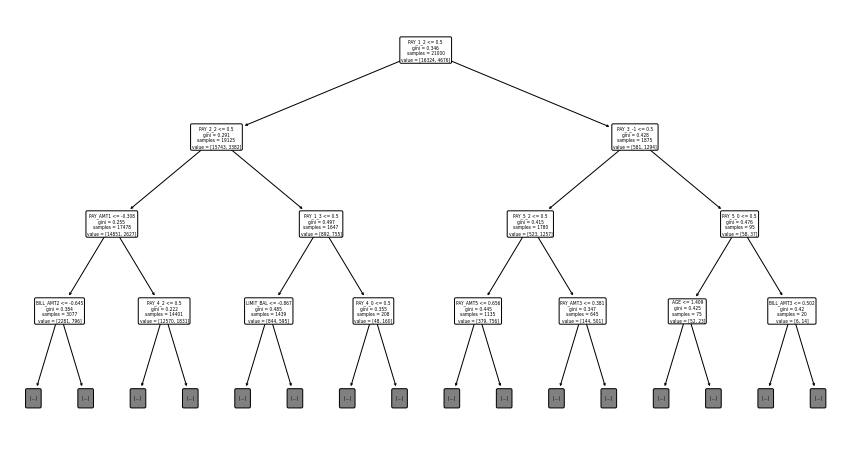

In [346]:
tree.plot_tree(decision_tree, max_depth=3, feature_names = Xtrain_orig_dummy.columns, rounded=True)
plt.show()

##### Metrics:

**Classification report**

In [144]:
ypred_orig_dummy = decision_tree.predict(Xtest_orig_dummy)
print(classification_report(ytest_orig_dummy, ypred_orig_dummy))

              precision    recall  f1-score   support

           0       0.83      0.82      0.82      7040
           1       0.38      0.41      0.39      1960

    accuracy                           0.73      9000
   macro avg       0.61      0.61      0.61      9000
weighted avg       0.73      0.73      0.73      9000



Recall for the positive class is 0.41. The model has low accuracy (0.73). The f1-score for the positive class (1) is low, indicating that majority of the positive class is not being correctly predicted. This performance can be improved by tuning the parameters for building the model or trying other algorithms.

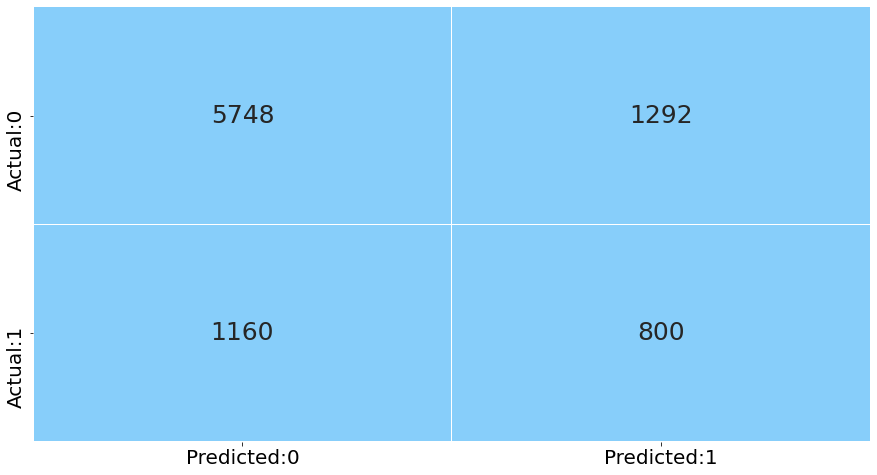

In [145]:
from matplotlib.colors import ListedColormap
cm = confusion_matrix(ytest_orig_dummy, ypred_orig_dummy)
conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])
sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

We can see in the above confusion matrix that the number of incorrect predictions is very high, especially for the positive class.

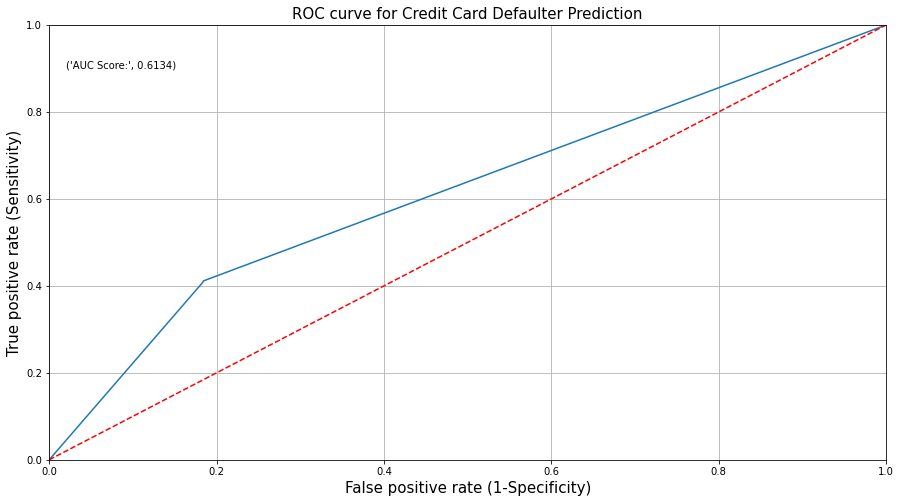

In [146]:
from sklearn import metrics
ypred_prob_orig_dummy = decision_tree.predict_proba(Xtest_orig_dummy)[:,1]
fpr, tpr, thresholds = roc_curve(ytest_orig_dummy, ypred_prob_orig_dummy)
plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.plot([0, 1], [0, 1],'r--')
plt.title('ROC curve for Credit Card Defaulter Prediction', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(ytest_orig_dummy, ypred_prob_orig_dummy),4)))
plt.grid(True)

The roc_auc_score for the base model is only 0.6234, which is significantly low. Hence, we will have to work on our data and use different algorithms to improve the performance.

#### Model with original columns and label encoding:

In [349]:
decision_tree = DecisionTreeClassifier(random_state = 42)

decision_tree = decision_tree.fit(Xtrain_orig_label, ytrain_orig_label)

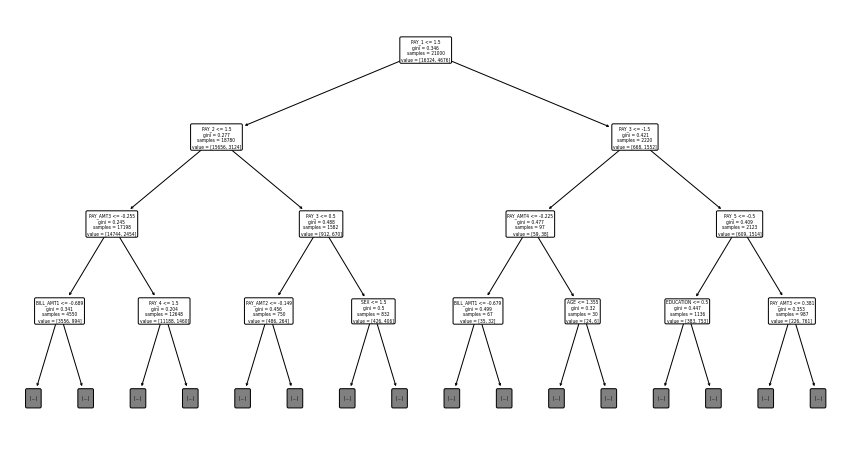

In [350]:
tree.plot_tree(decision_tree, max_depth=3, feature_names = Xtrain_orig_label.columns, rounded=True)
plt.show()

##### Metrics:

#### Classification report

In [149]:
ypred_orig_label = decision_tree.predict(Xtest_orig_label)
print(classification_report(ytest_orig_label, ypred_orig_label))

              precision    recall  f1-score   support

           0       0.83      0.81      0.82      7040
           1       0.38      0.41      0.39      1960

    accuracy                           0.73      9000
   macro avg       0.60      0.61      0.61      9000
weighted avg       0.73      0.72      0.73      9000



It is showing the same results as with dummy encoding.

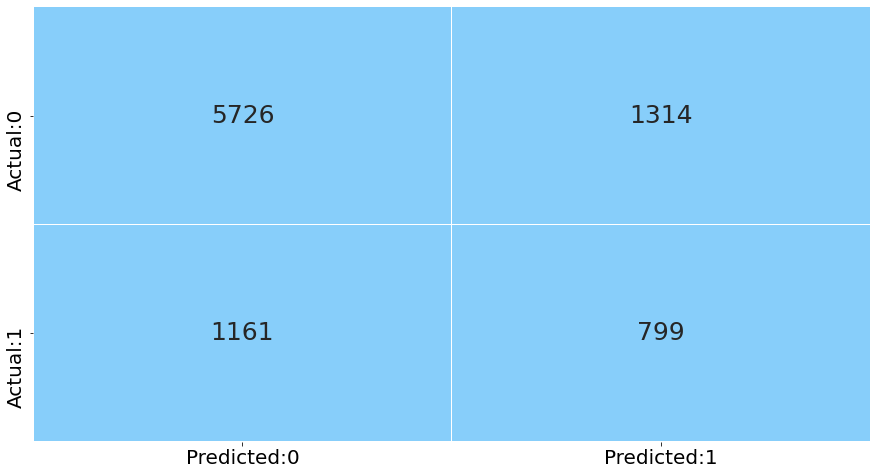

In [150]:
from matplotlib.colors import ListedColormap
cm = confusion_matrix(ytest_orig_label, ypred_orig_label)
conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])
sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

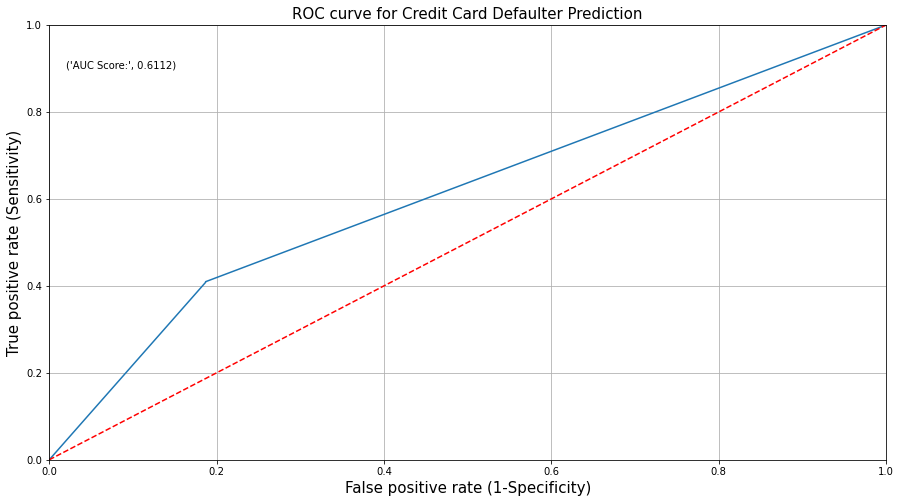

In [151]:
ypred_prob_orig_label = decision_tree.predict_proba(Xtest_orig_label)[:,1]
fpr, tpr, thresholds = roc_curve(ytest_orig_label, ypred_prob_orig_label)
plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.plot([0, 1], [0, 1],'r--')
plt.title('ROC curve for Credit Card Defaulter Prediction', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(ytest_orig_label, ypred_prob_orig_label),4)))
plt.grid(True)

We are getting the same results as dummy encoding. Hence, type of encoding is not influencing the model performance.

#### Model with transformed columns and dummy encoding:

In [152]:
decision_tree = DecisionTreeClassifier(random_state = 42)

decision_tree = decision_tree.fit(Xtrain_trans_dummy, ytrain_trans_dummy)

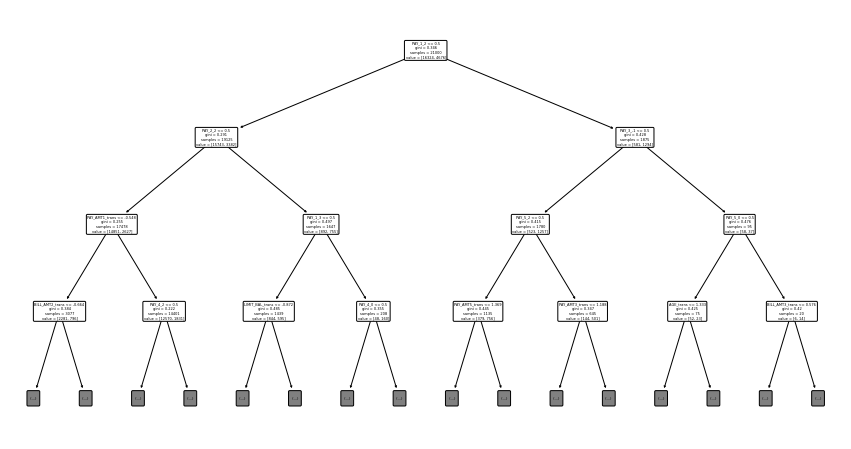

In [153]:
tree.plot_tree(decision_tree, max_depth=3, feature_names = Xtrain_trans_dummy.columns, rounded=True)
plt.show()

##### Metrics

**Classification report**

In [154]:
ypred_trans_dummy = decision_tree.predict(Xtest_trans_dummy)
print(classification_report(ytest_trans_dummy, ypred_trans_dummy))

              precision    recall  f1-score   support

           0       0.83      0.82      0.82      7040
           1       0.38      0.41      0.40      1960

    accuracy                           0.73      9000
   macro avg       0.61      0.61      0.61      9000
weighted avg       0.73      0.73      0.73      9000



This model is giving the same results as the previous models

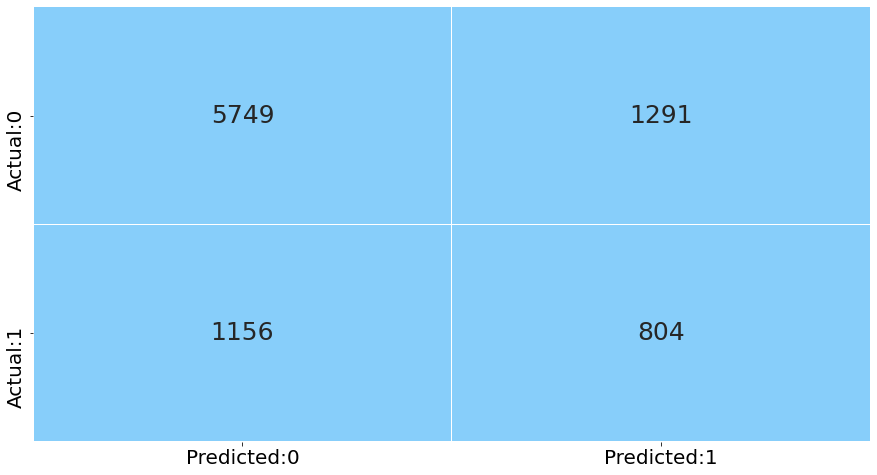

In [155]:
cm = confusion_matrix(ytest_trans_dummy, ypred_trans_dummy)
conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])
sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

We can see in the above confusion matrix that the number of incorrect predictions is very high, especially for the positive class.

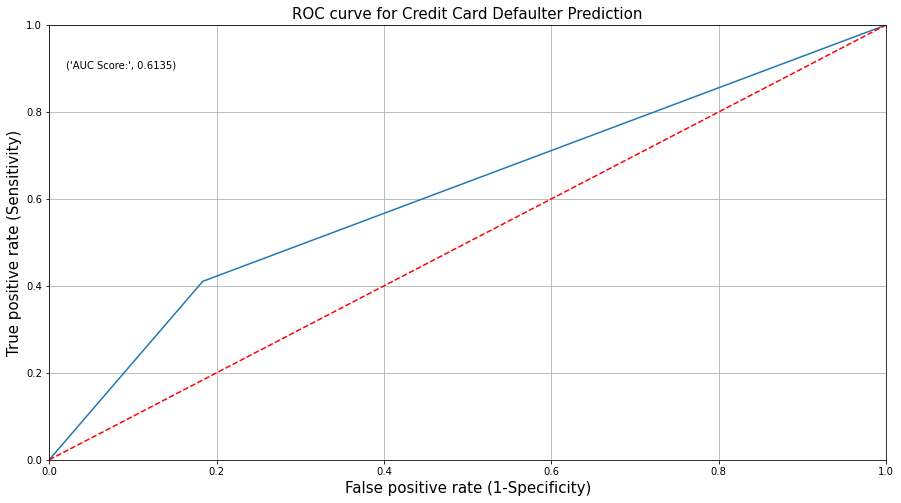

In [156]:
ypred_prob_trans_dummy = decision_tree.predict_proba(Xtest_trans_dummy)[:,1]
fpr, tpr, thresholds = roc_curve(ytest_trans_dummy, ypred_prob_trans_dummy)
plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.plot([0, 1], [0, 1],'r--')
plt.title('ROC curve for Credit Card Defaulter Prediction', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(ytest_trans_dummy, ypred_prob_trans_dummy),4)))
plt.grid(True)

The roc_auc_score for the base model is only 0.6233, which is significantly low. Hence, we will have to work on our data and use different algorithms to improve the performance.

#### Model with transformed columns and label encoding:

In [157]:
decision_tree = DecisionTreeClassifier(random_state = 42)

decision_tree = decision_tree.fit(Xtrain_trans_label, ytrain_trans_label)

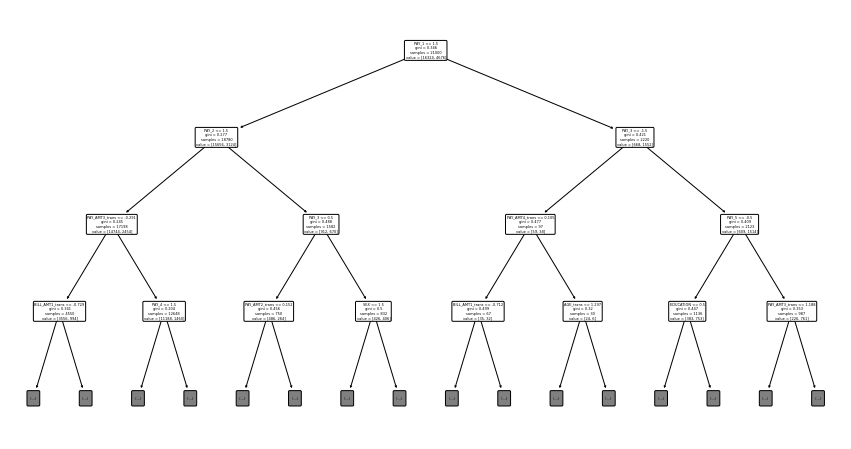

In [158]:
tree.plot_tree(decision_tree, max_depth=3, feature_names = Xtrain_trans_label.columns, rounded=True)
plt.show()

##### Metrics

#### Classification report

In [159]:
ypred_trans_label = decision_tree.predict(Xtest_trans_label)
print(classification_report(ytest_trans_label, ypred_trans_label))

              precision    recall  f1-score   support

           0       0.83      0.81      0.82      7040
           1       0.37      0.41      0.39      1960

    accuracy                           0.72      9000
   macro avg       0.60      0.61      0.61      9000
weighted avg       0.73      0.72      0.73      9000



This model is also giving the same results.

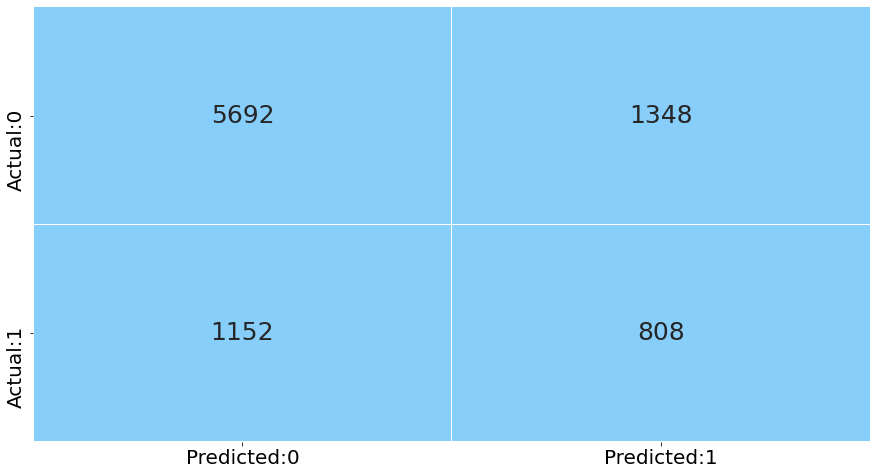

In [160]:
cm = confusion_matrix(ytest_trans_label, ypred_trans_label)
conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])
sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

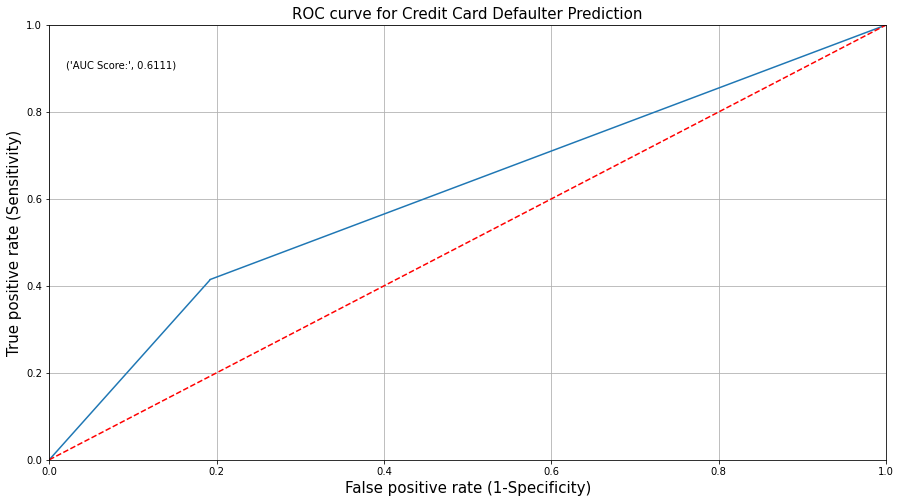

In [161]:
ypred_prob_trans_label = decision_tree.predict_proba(Xtest_trans_label)[:,1]
fpr, tpr, thresholds = roc_curve(ytest_trans_label, ypred_prob_trans_label)
plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.plot([0, 1], [0, 1],'r--')
plt.title('ROC curve for Credit Card Defaulter Prediction', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(ytest_trans_label, ypred_prob_trans_label),4)))
plt.grid(True)

The roc_auc_score for the base model is only 0.6209, which has decreased very slightly from the previous models.

As only one model performed very slightly poorly (model with transformed columns and label encoding), we can choose any of the other three models. So, we will use original columns with label encoding for simplicity and ease of drawing inferences.

### Feature Engineering

We will consider the dataframe df_orig_label.

In [162]:
df_orig_label.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,20000.0,2,2,1,24,2,2,-2,-2,0,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,120000.0,2,2,2,26,-2,2,-1,-1,-1,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,90000.0,2,2,2,34,-1,-1,-1,-1,-1,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,50000.0,2,2,1,37,-1,-1,-1,-1,-1,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,50000.0,1,2,1,57,-2,-1,-2,-1,-1,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


The first feature we will form is 'PAY_FLAG' which will be the sum of all the pay flags of the different PAY_X columns for a customer

In [163]:
df_orig_label['PAY_FLAG'] = df_orig_label['PAY_1'] + df_orig_label['PAY_2'] + df_orig_label['PAY_3'] + df_orig_label['PAY_4'] + df_orig_label['PAY_5'] + df_orig_label['PAY_6']
df_orig_label.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month,PAY_FLAG
0,20000.0,2,2,1,24,2,2,-2,-2,0,...,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1,0
1,120000.0,2,2,2,26,-2,2,-1,-1,-1,...,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1,-1
2,90000.0,2,2,2,34,-1,-1,-1,-1,-1,...,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0,-6
3,50000.0,2,2,1,37,-1,-1,-1,-1,-1,...,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0,-6
4,50000.0,1,2,1,57,-2,-1,-2,-1,-1,...,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0,-8


Now, we need to drop any of the PAY_X columns as the new feature PAY_FLAG is highly dependent on the PAY_X columns, dropping one of them will reduce this dependency.

In [164]:
df_orig_label.drop('PAY_1', axis=1,inplace=True)

The columns BILL_AMT4, BILL_AMT5, BILL_AMT6 are insignificant according to the statistical test we performed. Hence, we can form new features based on these to check if the new features would help in improving the model performance.

We can find a ratio between BILL_AMT and PAY_AMT columns. BILL_AMT6 is the bill for the month of April, and PAY_AMT5 is the amount paid for this bill in May. Hence, we can find a ratio between these two columns. Similarly, we can find the ratio between BILL_AMT5 and PAY_AMT4, BILL_AMT4 and PAY_AMT3.

In [165]:
df_orig_label.head(15)

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month,PAY_FLAG
0,20000.0,2,2,1,24,2,-2,-2,0,0,...,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1,0
1,120000.0,2,2,2,26,2,-1,-1,-1,2,...,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1,-1
2,90000.0,2,2,2,34,-1,-1,-1,-1,-1,...,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0,-6
3,50000.0,2,2,1,37,-1,-1,-1,-1,-1,...,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0,-6
4,50000.0,1,2,1,57,-1,-2,-1,-1,-1,...,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0,-8
5,50000.0,1,1,2,37,-1,-1,-1,-1,-1,...,19619.0,20024.0,2500.0,1815.0,657.0,1000.0,1000.0,800.0,0,-6
6,500000.0,1,1,2,29,-1,-1,-1,-1,-1,...,483003.0,473944.0,55000.0,40000.0,38000.0,20239.0,13750.0,13770.0,0,-6
7,100000.0,2,2,2,23,-2,-2,-1,-1,-2,...,-159.0,567.0,380.0,601.0,0.0,581.0,1687.0,1542.0,0,-9
8,140000.0,2,3,1,28,-1,2,-1,-1,-1,...,11793.0,3719.0,3329.0,0.0,432.0,1000.0,1000.0,1000.0,0,-3
9,20000.0,1,3,2,35,0,0,0,-2,-2,...,13007.0,13912.0,0.0,0.0,0.0,13007.0,1122.0,0.0,0,-4


In [166]:
cols=['BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']

In [167]:
for i in cols:
    df_orig_label[i]=df[i]+0.001
    df_orig_label[i]

In [168]:
df_orig_label['PAY_AMT2'].head(3)

0     689.001
1    1000.001
2    1500.001
Name: PAY_AMT2, dtype: float64

In [169]:
df_orig_label['BILL_AMT1'].head(3)

0     3913.001
1     2682.001
2    29239.001
Name: BILL_AMT1, dtype: float64

In [170]:
df_orig_label['PAID_RATIO_APRIL'] = df_orig_label['BILL_AMT6']/df_orig_label['PAY_AMT5']
df_orig_label['PAID_RATIO_MAY'] = df_orig_label['BILL_AMT5']/df_orig_label['PAY_AMT4']
df_orig_label['PAID_RATIO_JUNE'] = df_orig_label['BILL_AMT4']/df_orig_label['PAY_AMT3']

In [171]:
df_orig_label.head(5)

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,...,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month,PAY_FLAG,PAID_RATIO_APRIL,PAID_RATIO_MAY,PAID_RATIO_JUNE
0,20000.0,2,2,1,24,2,-2,-2,0,0,...,689.001,0.001,0.001,0.001,0.001,1,0,1.000000e+00,1.000000,1.000000
1,120000.0,2,2,2,26,2,-1,-1,-1,2,...,1000.001,1000.001,1000.001,0.001,2000.001,1,-1,3.261001e+06,3.454998,3.271998
2,90000.0,2,2,2,34,-1,-1,-1,-1,-1,...,1500.001,1000.001,1000.001,1000.001,5000.001,0,-6,1.554899e+01,14.947986,14.330987
3,50000.0,2,2,1,37,-1,-1,-1,-1,-1,...,2019.001,1200.001,1100.001,1069.001,1000.001,0,-6,2.763983e+01,26.326341,23.594981
4,50000.0,1,2,1,57,-1,-2,-1,-1,-1,...,36681.001,10000.001,9000.001,689.001,679.001,0,-8,2.776629e+01,2.127333,2.094000


In [172]:
df_orig_label.drop(['BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6'], axis=1, inplace = True)

### Building Initial Model on Feature Engineered Dataframe:-

In [173]:
X_fe=df_orig_label.drop('default.payment.next.month',axis=1)
y_fe=df_orig_label['default.payment.next.month']

In [174]:
# Splitting of data:-

X_train_fe,X_test_fe,y_train_fe,y_test_fe=train_test_split(X_fe,y_fe,test_size=0.30,random_state=42)
print(X_train_fe.shape)
print(X_test_fe.shape)
print(y_train_fe.shape)
print(y_test_fe.shape)

(21000, 23)
(9000, 23)
(21000,)
(9000,)


### Scaling Dataframe

In [175]:
sc=StandardScaler()
cols = ['LIMIT_BAL', 'AGE', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'PAID_RATIO_APRIL', 'PAID_RATIO_MAY', 'PAID_RATIO_JUNE', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']
for i in cols:
    X_train_fe[i]=sc.fit_transform(X_train_fe[[i]])
    X_test_fe[i]=sc.transform(X_test_fe[[i]])

In [352]:
decision_tree = DecisionTreeClassifier(random_state = 42)

decision_tree = decision_tree.fit(X_train_fe, y_train_fe)

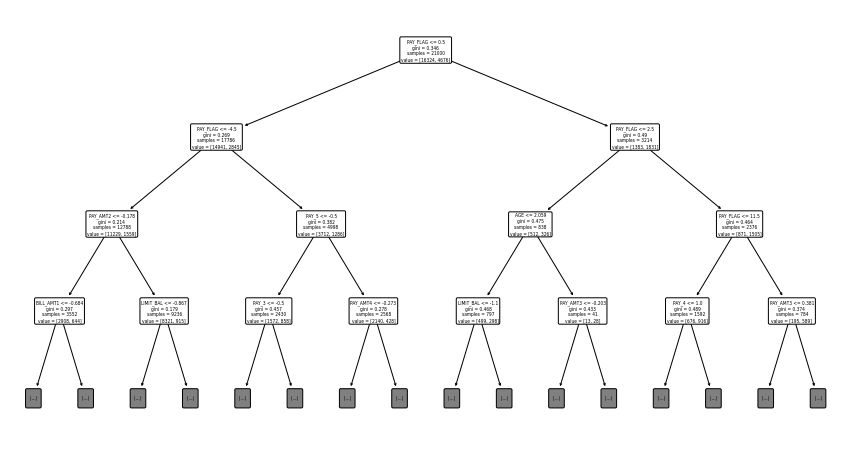

In [353]:
tree.plot_tree(decision_tree, max_depth=3, feature_names = X_train_fe.columns, rounded=True)
plt.show()

In [178]:
ypred_fe = decision_tree.predict(X_test_fe)
print(classification_report(y_test_fe, ypred_fe))

              precision    recall  f1-score   support

           0       0.83      0.80      0.82      7040
           1       0.37      0.41      0.39      1960

    accuracy                           0.72      9000
   macro avg       0.60      0.61      0.60      9000
weighted avg       0.73      0.72      0.72      9000



Recall for positive class is 0.41, precision for positive class is 0.37. Accuracy of model is 0.72 and F1-Score is 0.60.

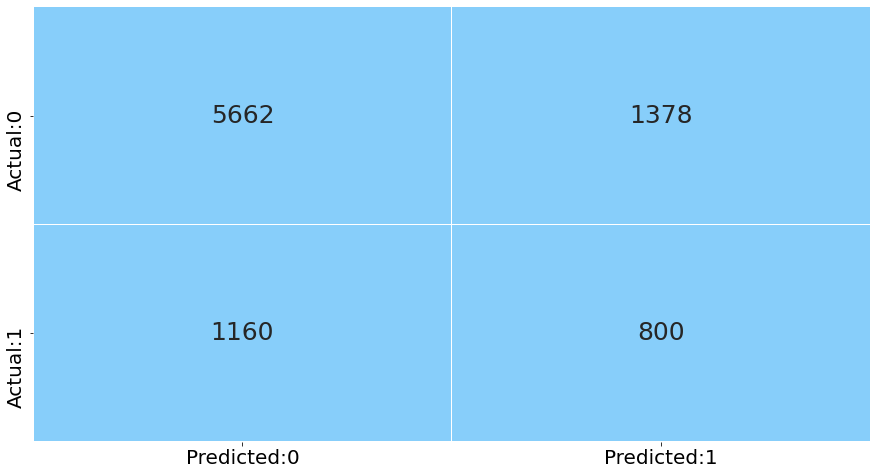

In [179]:
cm = confusion_matrix(y_test_fe, ypred_fe)
conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])
sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

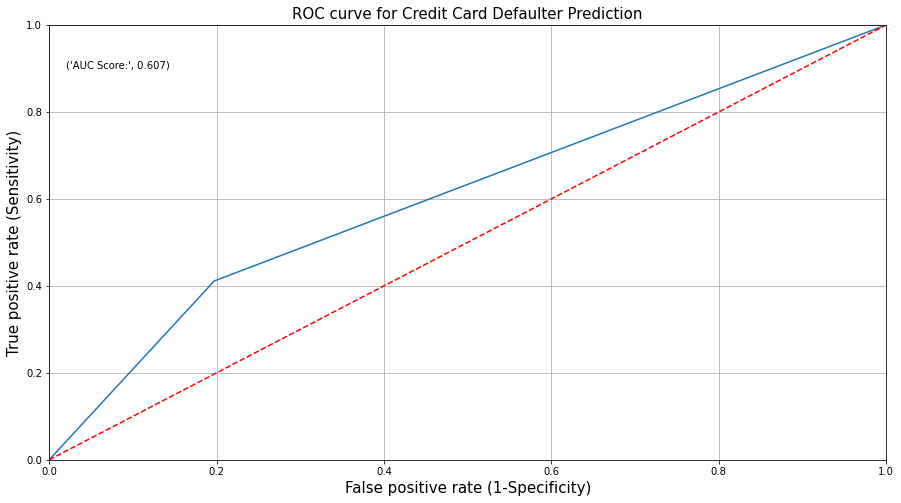

In [180]:
ypred_prob_fe= decision_tree.predict_proba(X_test_fe)[:,1]
fpr, tpr, thresholds = roc_curve(y_test_fe, ypred_prob_fe)
plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.plot([0, 1], [0, 1],'r--')
plt.title('ROC curve for Credit Card Defaulter Prediction', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(y_test_fe, ypred_prob_fe),4)))
plt.grid(True)

### Hyperparameter Tuning Decision Tree Feature Engineered Model:-

In [181]:
tuned_paramaters = [{'criterion': ['entropy', 'gini'], 
                     'max_depth': range(2, 10),
                     'max_features': ["sqrt", "log2"],
                     'min_samples_split': range(2,10),
                     'min_samples_leaf': range(2,10),
                     'max_leaf_nodes': range(2,10)}]

In [182]:
decision_tree_classification = DecisionTreeClassifier(random_state = 42)

In [183]:
from sklearn.model_selection import GridSearchCV

In [184]:
tree_grid = GridSearchCV(estimator = decision_tree, 
                         param_grid = tuned_paramaters, 
                         cv = 3,n_jobs=-1)

In [185]:
tree_grid_model = tree_grid.fit(X_train_fe, y_train_fe)

In [186]:
print('Best parameters for decision tree classifier: ', tree_grid_model.best_params_, '\n')

Best parameters for decision tree classifier:  {'criterion': 'entropy', 'max_depth': 3, 'max_features': 'sqrt', 'max_leaf_nodes': 7, 'min_samples_leaf': 2, 'min_samples_split': 2} 



In [187]:
tuned_dt=DecisionTreeClassifier(criterion = tree_grid_model.best_params_.get('criterion'),
                                  max_depth = tree_grid_model.best_params_.get('max_depth'),
                                  max_features = tree_grid_model.best_params_.get('max_features'),
                                  max_leaf_nodes = tree_grid_model.best_params_.get('max_leaf_nodes'),
                                  min_samples_leaf = tree_grid_model.best_params_.get('min_samples_leaf'),
                                  min_samples_split = tree_grid_model.best_params_.get('min_samples_split'),
                                  random_state = 42)

In [188]:
tuned_dt = tuned_dt.fit(X_train_fe, y_train_fe)

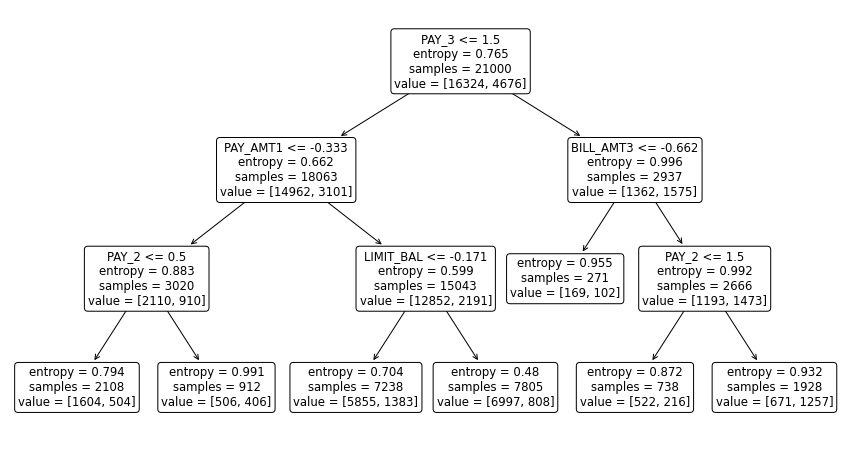

In [189]:
tree.plot_tree(tuned_dt,feature_names=X_train_fe.columns,rounded=True)
plt.show()

In [190]:
ypred_tuned = tuned_dt.predict(X_test_fe)
print(classification_report(y_test_fe, ypred_tuned))

              precision    recall  f1-score   support

           0       0.82      0.96      0.88      7040
           1       0.60      0.24      0.34      1960

    accuracy                           0.80      9000
   macro avg       0.71      0.60      0.61      9000
weighted avg       0.77      0.80      0.76      9000



Recall for positive class is 0.24, Precision for positive class is 0.60. Accuracy of model is 0.80 and F1-Score is 0.61.

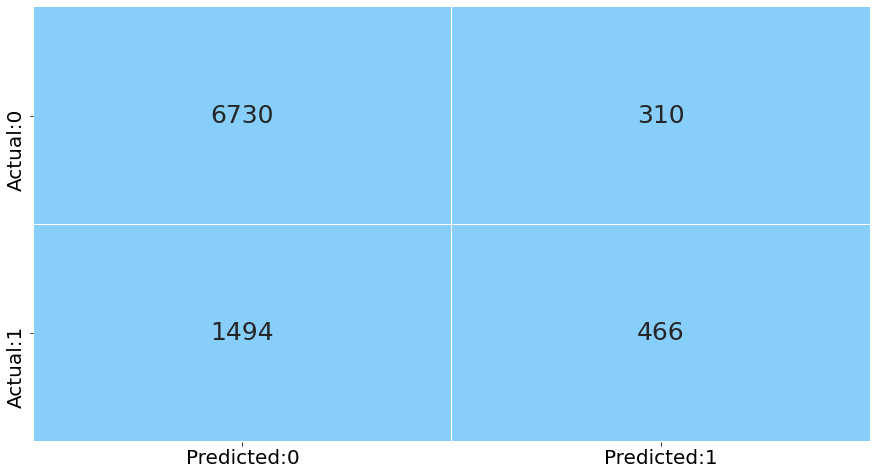

In [191]:
cm = confusion_matrix(y_test_fe, ypred_tuned)
conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])
sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

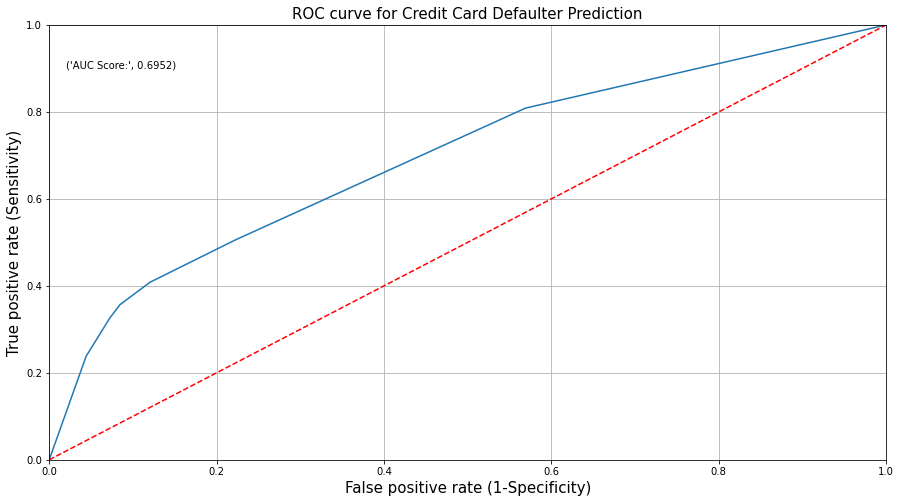

In [192]:
ypred_prob_tuned= tuned_dt.predict_proba(X_test_fe)[:,1]
fpr, tpr, thresholds = roc_curve(y_test_fe, ypred_prob_tuned)
plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.plot([0, 1], [0, 1],'r--')
plt.title('ROC curve for Credit Card Defaulter Prediction', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(y_test_fe, ypred_prob_tuned),4)))
plt.grid(True)

## Building Boosting models - 

### ADA Boost 

In [193]:
# Importing libraries:-

from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier

In [194]:
ada_model = AdaBoostClassifier(n_estimators = 100, random_state = 42)

ada_model.fit(X_train_fe, y_train_fe)

AdaBoostClassifier(n_estimators=100, random_state=42)

In [195]:
ypred_fe = ada_model.predict(X_test_fe)
print(classification_report(y_test_fe, ypred_fe))

              precision    recall  f1-score   support

           0       0.83      0.95      0.88      7040
           1       0.61      0.30      0.41      1960

    accuracy                           0.81      9000
   macro avg       0.72      0.63      0.65      9000
weighted avg       0.78      0.81      0.78      9000



Recall for positive class is 0.30, Precision for positive class is 0.61. Accuracy of model is 0.81 and F1-Score is 0.65.

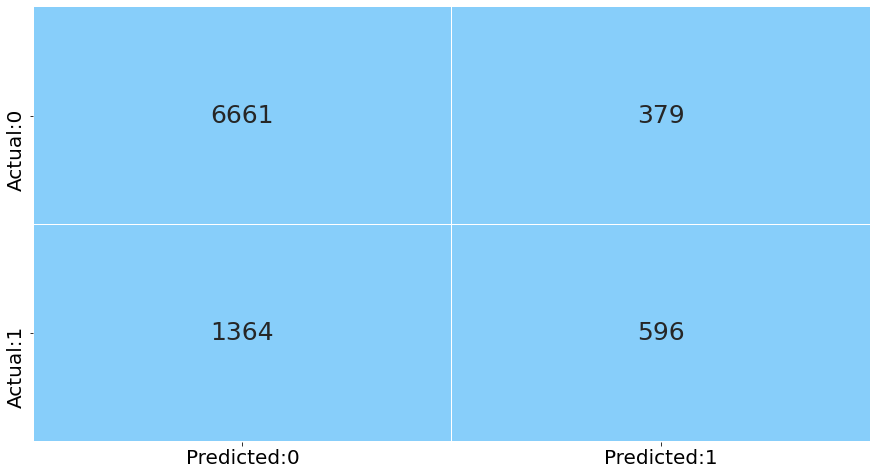

In [196]:
cm = confusion_matrix(y_test_fe, ypred_fe)
conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])
sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

The confusion matrix shows that maximum of the positive classes are being predicted incorrectly.

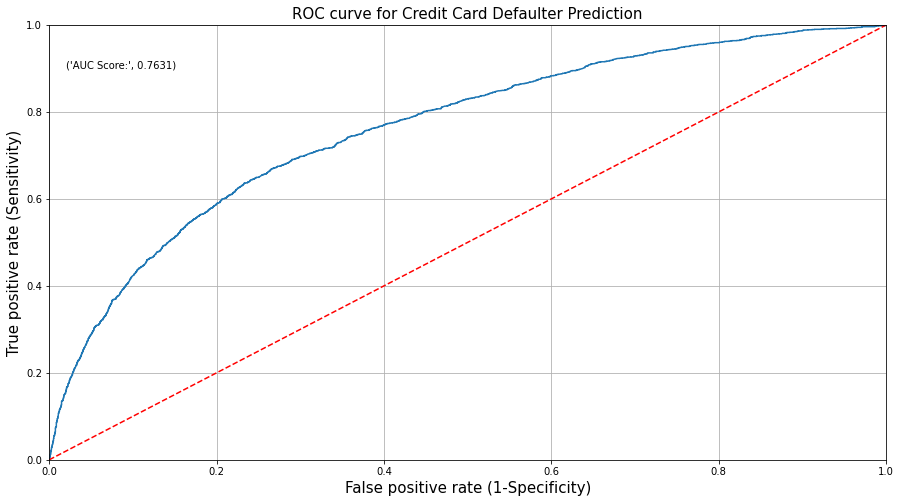

In [197]:
ypred_prob_fe= ada_model.predict_proba(X_test_fe)[:,1]
fpr, tpr, thresholds = roc_curve(y_test_fe, ypred_prob_fe)
plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.plot([0, 1], [0, 1],'r--')
plt.title('ROC curve for Credit Card Defaulter Prediction', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(y_test_fe, ypred_prob_fe),4)))
plt.grid(True)

The AUC score has increased as compared to the previous models.

### Hyperparameter tuning ADA Boost Model:-

In [198]:
tuned_paramaters = [{'n_estimators': [100, 120, 150, 200, 250, 300, 350],
                     'learning_rate': [0.01,0.02,0.03,0.04,0.05,0.06,0.001,0.002,0.003,0.004,0.005,0.006]}]
ada_model = AdaBoostClassifier(random_state = 42)
ada_grid = GridSearchCV(estimator = ada_model, 
                         param_grid = tuned_paramaters, 
                         cv = 3,
                         n_jobs=-1)
ada_grid.fit(X_train_fe, y_train_fe)
print('Best parameters for AdaBoost Classifier: ', ada_grid.best_params_, '\n')

Best parameters for AdaBoost Classifier:  {'learning_rate': 0.01, 'n_estimators': 120} 



In [199]:
from sklearn.model_selection import cross_val_score

In [200]:
ada_model = AdaBoostClassifier(learning_rate = ada_grid.best_params_['learning_rate'], 
                               n_estimators = ada_grid.best_params_['n_estimators'], 
                               random_state = 42)

In [201]:
tuned_ada = ada_model.fit(X_train_fe, y_train_fe)

In [202]:
ypred_tuned = tuned_ada.predict(X_test_fe)
print(classification_report(y_test_fe, ypred_tuned))

              precision    recall  f1-score   support

           0       0.82      0.96      0.89      7040
           1       0.63      0.26      0.36      1960

    accuracy                           0.81      9000
   macro avg       0.73      0.61      0.62      9000
weighted avg       0.78      0.81      0.77      9000



Recall for positive class is 0.26, Precision for positive class is 0.63. Accuracy of model is 0.81 and F1-Score is 0.62.

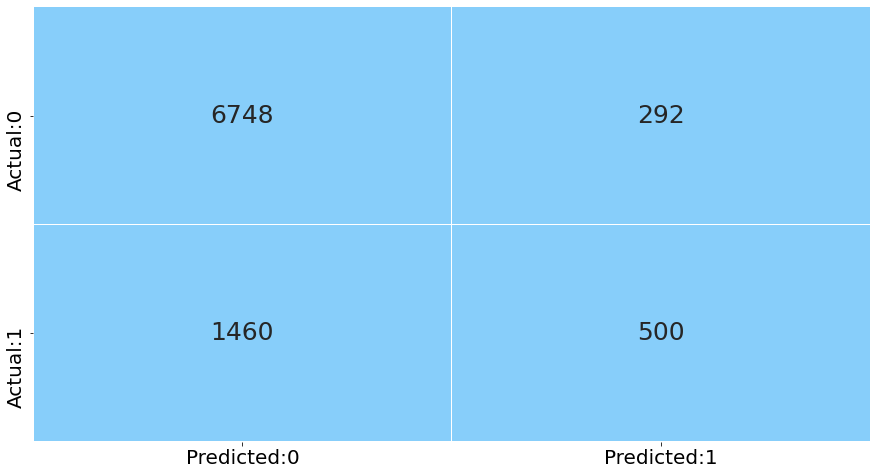

In [203]:
cm = confusion_matrix(y_test_fe, ypred_tuned)
conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])
sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

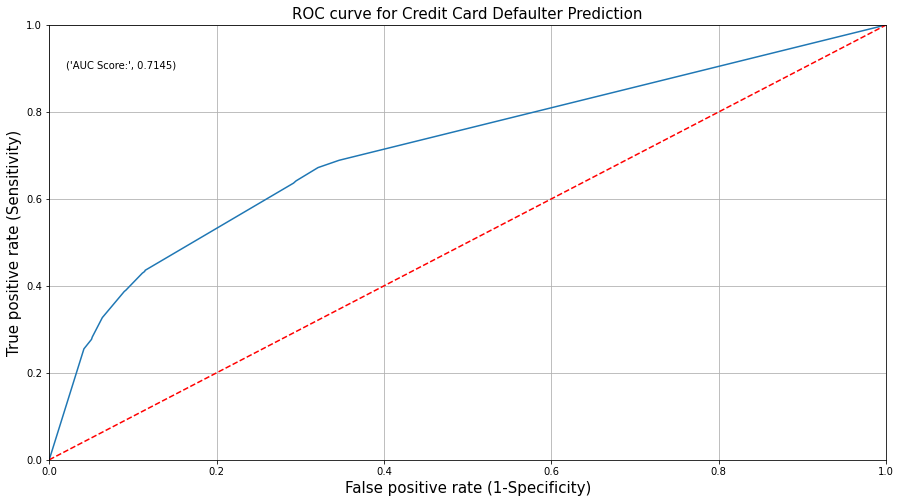

In [204]:
ypred_prob_tuned= tuned_ada.predict_proba(X_test_fe)[:,1]
fpr, tpr, thresholds = roc_curve(y_test_fe, ypred_prob_tuned)
plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.plot([0, 1], [0, 1],'r--')
plt.title('ROC curve for Credit Card Defaulter Prediction', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(y_test_fe, ypred_prob_tuned),4)))
plt.grid(True)

### Gradient Boosting

In [205]:
gboost_model = GradientBoostingClassifier(n_estimators = 100, max_depth = 10, random_state = 42)

gboost_model.fit(X_train_fe, y_train_fe)

GradientBoostingClassifier(max_depth=10, random_state=42)

In [206]:
ypred_fe = gboost_model.predict(X_test_fe)
print(classification_report(y_test_fe, ypred_fe))

              precision    recall  f1-score   support

           0       0.84      0.93      0.88      7040
           1       0.59      0.35      0.44      1960

    accuracy                           0.81      9000
   macro avg       0.71      0.64      0.66      9000
weighted avg       0.78      0.81      0.79      9000



Recall for positive class is 0.35, Precision for positive class is 0.59. Accuracy of model is 0.81 and F1-Score is 0.66.

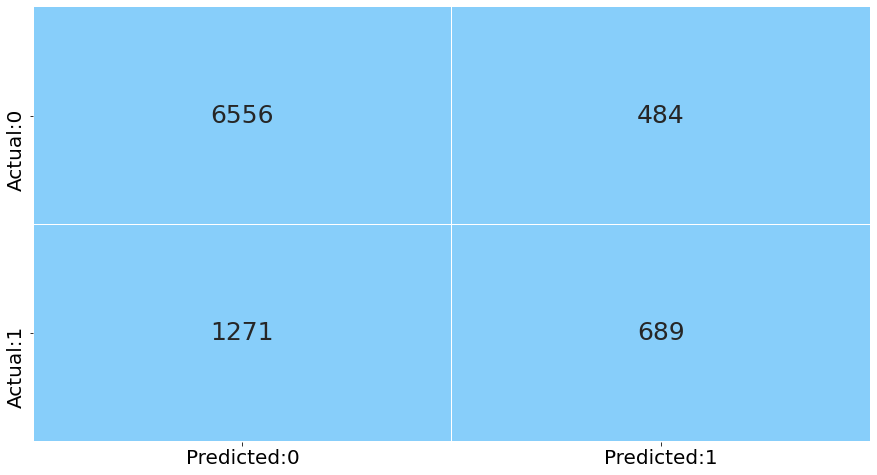

In [207]:
cm = confusion_matrix(y_test_fe, ypred_fe)
conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])
sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

Maximum of the positive class is still incorrectly predicted

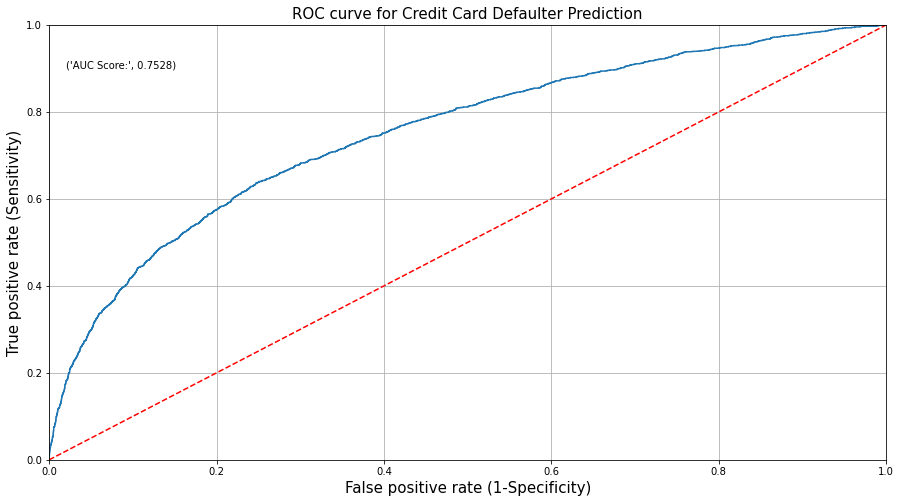

In [208]:
ypred_prob_fe= gboost_model.predict_proba(X_test_fe)[:,1]
fpr, tpr, thresholds = roc_curve(y_test_fe, ypred_prob_fe)
plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.plot([0, 1], [0, 1],'r--')
plt.title('ROC curve for Credit Card Defaulter Prediction', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(y_test_fe, ypred_prob_fe),4)))
plt.grid(True)

The AUC score is similar to that of the last model

### Hyperparameter tuning Gradient Boost Model:-

In [209]:
tuned_paramaters = [{'n_estimators': [100, 120, 150],
                     'learning_rate': [0.01,0.02,0.03,0.04,0.05,0.06,0.001,0.002,0.003,0.004,0.005,0.006], 
                     'max_depth': [2, 3, 4, 5, 6]}]
gboost_model = GradientBoostingClassifier(random_state = 42)
gb_grid = GridSearchCV(estimator = gboost_model, 
                         param_grid = tuned_paramaters, 
                         cv = 3, 
                         n_jobs=-1)
gb_grid.fit(X_train_fe, y_train_fe)
print('Best parameters for Gradient Boositng Classifier: ', gb_grid.best_params_, '\n')

Best parameters for Gradient Boositng Classifier:  {'learning_rate': 0.05, 'max_depth': 6, 'n_estimators': 150} 



In [210]:
tuned_gboost = GradientBoostingClassifier(n_estimators = gb_grid.best_params_['n_estimators'], 
                                          max_depth = gb_grid.best_params_['max_depth'], 
                                          learning_rate = gb_grid.best_params_['learning_rate'],
                                          random_state = 42)
tuned_gboost.fit(X_train_fe, y_train_fe)

GradientBoostingClassifier(learning_rate=0.05, max_depth=6, n_estimators=150,
                           random_state=42)

In [211]:
y_pred_tuned = tuned_gboost.predict(X_test_fe)
print(classification_report(y_test_fe, y_pred_tuned))

              precision    recall  f1-score   support

           0       0.83      0.94      0.89      7040
           1       0.61      0.32      0.42      1960

    accuracy                           0.81      9000
   macro avg       0.72      0.63      0.65      9000
weighted avg       0.79      0.81      0.78      9000



Recall for positive class is 0.32, Precision for positive class is 0.61. Accuracy of model is 0.81 and F1-Score is 0.65.

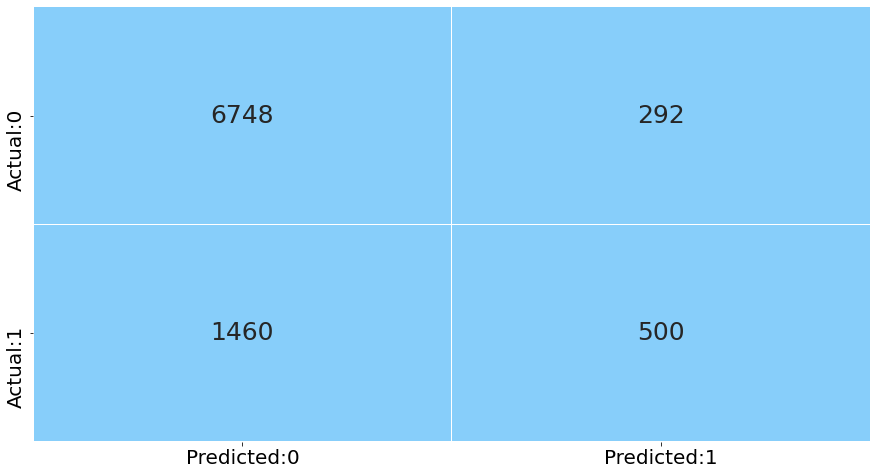

In [212]:
cm = confusion_matrix(y_test_fe, ypred_tuned)
conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])
sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

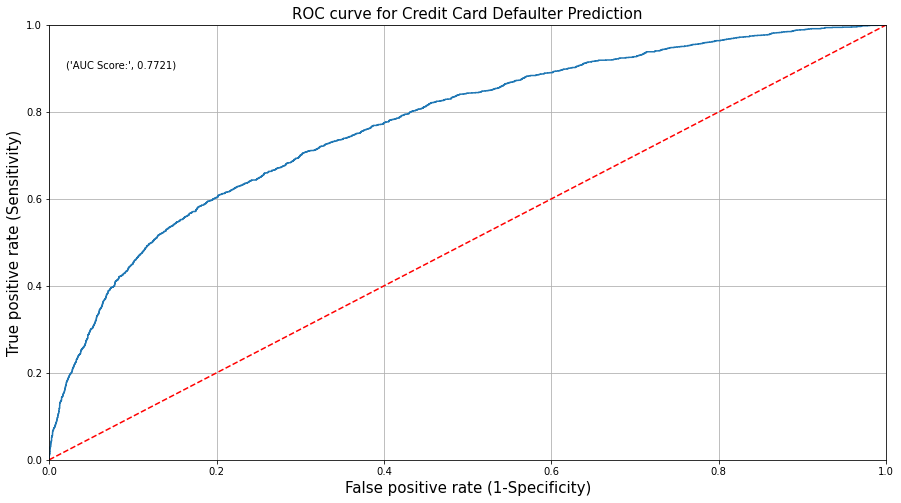

In [213]:
ypred_prob_tuned= tuned_gboost.predict_proba(X_test_fe)[:,1]
fpr, tpr, thresholds = roc_curve(y_test_fe, ypred_prob_tuned)
plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.plot([0, 1], [0, 1],'r--')
plt.title('ROC curve for Credit Card Defaulter Prediction', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(y_test_fe, ypred_prob_tuned),4)))
plt.grid(True)

### XGBoost Model

In [214]:
from xgboost import XGBClassifier

In [215]:
xgb_model = XGBClassifier(max_depth = 10, gamma = 1,eval_metric='mlogloss')

xgb_model.fit(X_train_fe, y_train_fe)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, eval_metric='mlogloss',
              gamma=1, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=0.300000012,
              max_delta_step=0, max_depth=10, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=12,
              num_parallel_tree=1, random_state=0, reg_alpha=0, reg_lambda=1,
              scale_pos_weight=1, subsample=1, tree_method='exact',
              validate_parameters=1, verbosity=None)

In [216]:
ypred_fe = xgb_model.predict(X_test_fe)
print(classification_report(y_test_fe, ypred_fe))

              precision    recall  f1-score   support

           0       0.84      0.93      0.88      7040
           1       0.59      0.36      0.44      1960

    accuracy                           0.81      9000
   macro avg       0.72      0.64      0.66      9000
weighted avg       0.78      0.81      0.79      9000



Recall for positive class is 0.36, Precision for positive class is 0.59. Accuracy of model is 0.81 and F1-Score is 0.66.

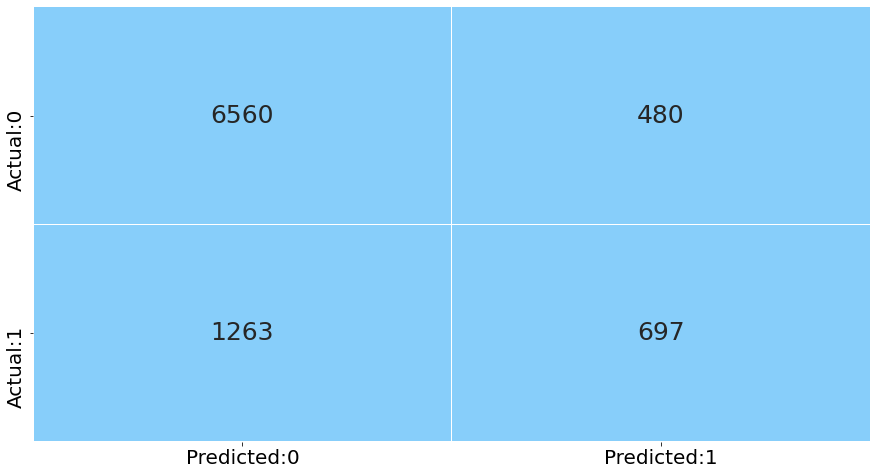

In [217]:
cm = confusion_matrix(y_test_fe, ypred_fe)
conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])
sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

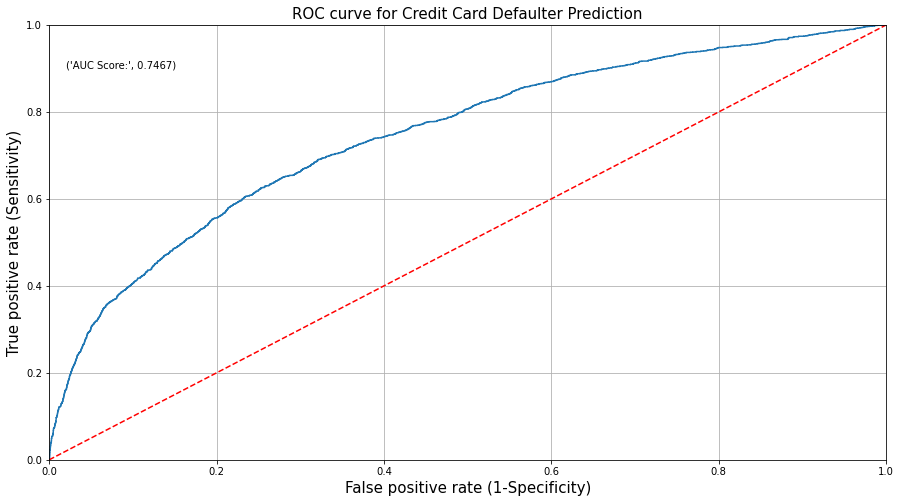

In [218]:
ypred_prob_fe= xgb_model.predict_proba(X_test_fe)[:,1]
fpr, tpr, thresholds = roc_curve(y_test_fe, ypred_prob_fe)
plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.plot([0, 1], [0, 1],'r--')
plt.title('ROC curve for Credit Card Defaulter Prediction', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(y_test_fe, ypred_prob_fe),4)))
plt.grid(True)

The AUC score for this model has reduced compared to the previous models.

### Hyperparameter Tuning XGBoost Model:-

In [219]:
tuning_parameters = {'learning_rate': [0.01,0.02,0.03,0.04,0.05,0.06,0.001,0.002,0.003,0.004,0.005,0.006],
                     'max_depth': range(3,10),
                     'gamma': [0, 1, 2, 3, 4]}

In [220]:
xgb_model = XGBClassifier(eval_metric='mlogloss')

In [221]:
xgb_grid = GridSearchCV(estimator = xgb_model, param_grid = tuning_parameters, cv = 3, scoring = 'roc_auc')

In [222]:
xgb_grid.fit(X_train_fe, y_train_fe)

GridSearchCV(cv=3,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None,
                                     eval_metric='mlogloss', gamma=None,
                                     gpu_id=None, importance_type='gain',
                                     interaction_constraints=None,
                                     learning_rate=None, max_delta_step=None,
                                     max_depth=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     n_estimators=100, n_jobs=None,
                                     num_parallel_tree=None, random_state=None,
                                     reg_alpha=None, reg_lambda=None,
                                     scale_pos_weight=None, subsample=None,
                                     tree_method=None, validate_parameters=None,
                                     verbosity=None),
             param_grid={'gamma': [0, 1, 2, 3, 4],
                         'learning_rate': [0.01, 0.02, 0.03, 0.04, 0.05, 0.06,
                                           0.001, 0.002, 0.003, 0.004, 0.005,
                                           0.006],
                         'max_depth': range(3, 10)},
             scoring='roc_auc')

In [223]:
print('Best parameters for XGBoost classifier: ', xgb_grid.best_params_, '\n')

Best parameters for XGBoost classifier:  {'gamma': 4, 'learning_rate': 0.03, 'max_depth': 7} 



In [224]:
xgb_grid_model = XGBClassifier(learning_rate = xgb_grid.best_params_.get('learning_rate'),
                               max_depth = xgb_grid.best_params_.get('max_depth'),
                              gamma = xgb_grid.best_params_.get('gamma'),
                              random_state = 42)


In [225]:
tuned_xgb = xgb_grid_model.fit(X_train_fe, y_train_fe)

[13:45:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.3.0/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


In [226]:
ypred_tuned = tuned_xgb.predict(X_test_fe)
print(classification_report(y_test_fe, ypred_tuned))

              precision    recall  f1-score   support

           0       0.84      0.94      0.89      7040
           1       0.62      0.35      0.45      1960

    accuracy                           0.81      9000
   macro avg       0.73      0.65      0.67      9000
weighted avg       0.79      0.81      0.79      9000



Recall for positive class is 0.35, Precision for positive class is 0.62. Accuracy of model is 0.81 and F1-Score is 0.67.

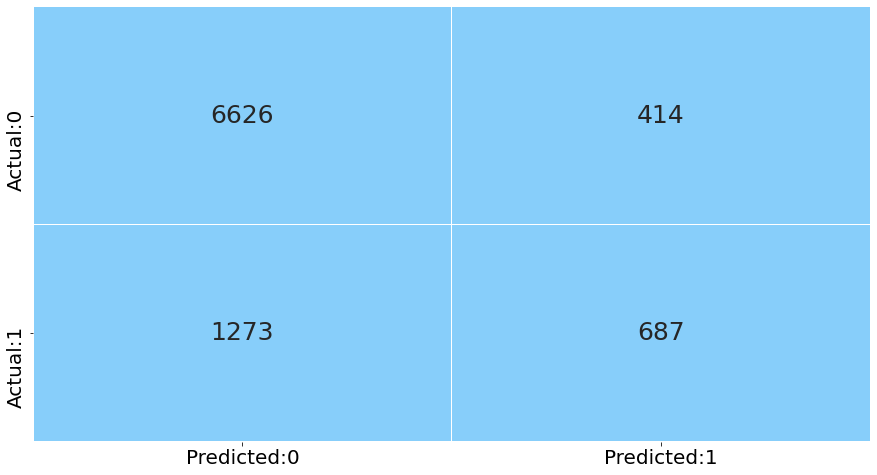

In [227]:
cm = confusion_matrix(y_test_fe, ypred_tuned)
conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])
sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

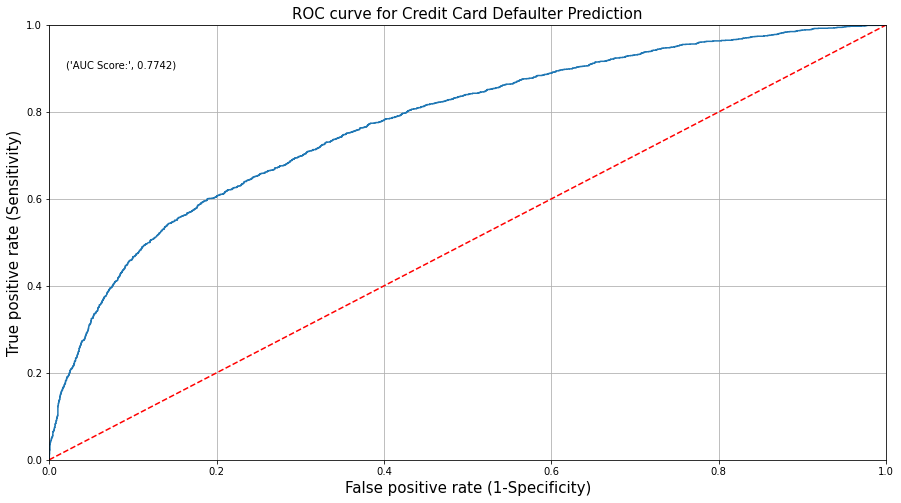

In [272]:
ypred_prob_tuned= tuned_xgb.predict_proba(X_test_fe)[:,1]
fpr, tpr, thresholds = roc_curve(y_test_fe, ypred_prob_tuned)
plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.plot([0, 1], [0, 1],'r--')
plt.title('ROC curve for Credit Card Defaulter Prediction', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(y_test_fe, ypred_prob_tuned),4)))
plt.grid(True)

### KNN Model:-

In [273]:
knn_model=KNeighborsClassifier(n_neighbors=7,metric='euclidean')
knn_model.fit(X_train_fe,y_train_fe)

KNeighborsClassifier(metric='euclidean', n_neighbors=7)

In [274]:
ypred_fe = knn_model.predict(X_test_fe)
print(classification_report(y_test_fe, ypred_fe))

              precision    recall  f1-score   support

           0       0.84      0.93      0.88      7040
           1       0.57      0.35      0.43      1960

    accuracy                           0.80      9000
   macro avg       0.71      0.64      0.66      9000
weighted avg       0.78      0.80      0.78      9000



Recall for positive class is 0.35, Precision for positive class is 0.57. Accuracy of model is 0.80 and F1-Score is 0.66.

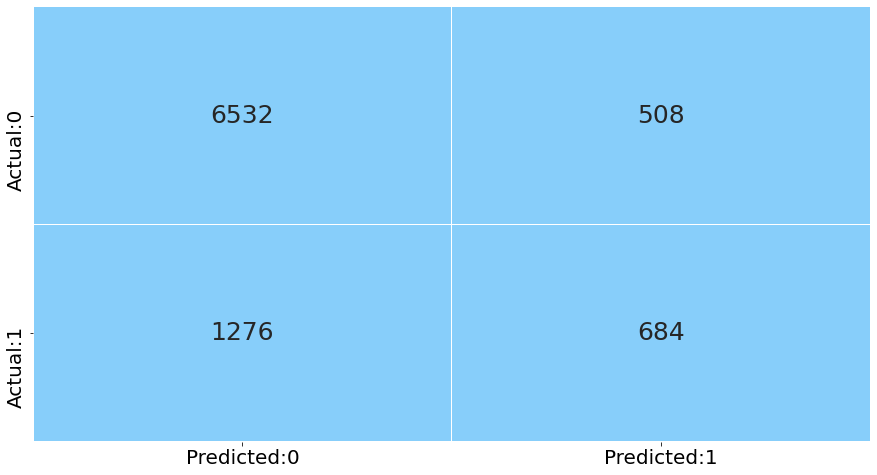

In [275]:
cm = confusion_matrix(y_test_fe, ypred_fe)
conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])
sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

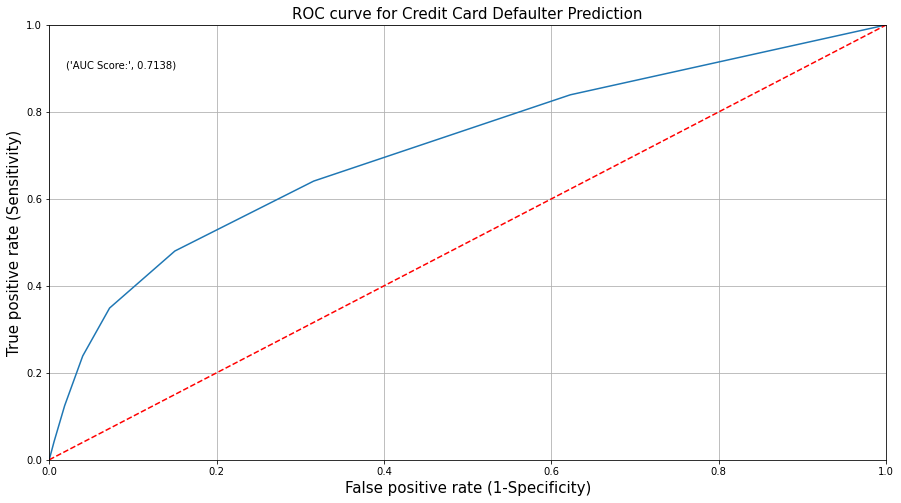

In [276]:
ypred_prob_fe= knn_model.predict_proba(X_test_fe)[:,1]
fpr, tpr, thresholds = roc_curve(y_test_fe, ypred_prob_fe)
plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.plot([0, 1], [0, 1],'r--')
plt.title('ROC curve for Credit Card Defaulter Prediction', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(y_test_fe, ypred_prob_fe),4)))
plt.grid(True)

### Hyperparameter Tuning KNN Model:-

In [279]:
tuned_paramaters = {'n_neighbors': np.arange(1, 25, 2),
                   'metric': ['hamming','euclidean','manhattan','Chebyshev']}
 
knn_classification = KNeighborsClassifier(n_jobs=-1)

knn_grid = GridSearchCV(estimator = knn_classification, 
                        param_grid = tuned_paramaters, 
                        cv = 3, 
                        scoring = 'accuracy', 
                        n_jobs=-1)

knn_grid.fit(X_train_fe, y_train_fe)

print('Best parameters for KNN Classifier: ', knn_grid.best_params_, '\n')

Best parameters for KNN Classifier:  {'metric': 'euclidean', 'n_neighbors': 23} 



In [280]:
knn_grid_model = KNeighborsClassifier(n_neighbors = knn_grid.best_params_['n_neighbors'], 
                                      metric=knn_grid.best_params_['metric'])

In [281]:
tuned_knn = knn_grid_model.fit(X_train_fe, y_train_fe)

In [282]:
ypred_tuned = tuned_knn.predict(X_test_fe)
print(classification_report(y_test_fe, ypred_tuned))

              precision    recall  f1-score   support

           0       0.84      0.94      0.88      7040
           1       0.61      0.35      0.45      1960

    accuracy                           0.81      9000
   macro avg       0.72      0.64      0.66      9000
weighted avg       0.79      0.81      0.79      9000



Recall for positive class is 0.35, Precision for positive class is 0.61. Accuracy of model is 0.81 and F1-Score is 0.66.

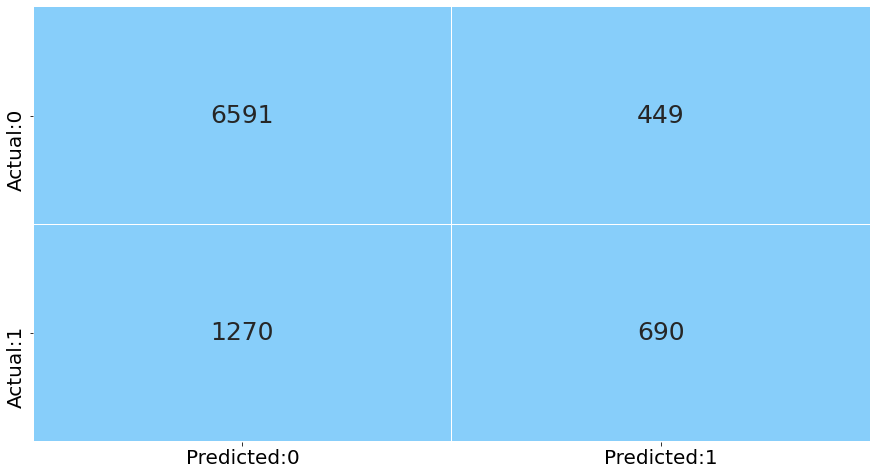

In [283]:
cm = confusion_matrix(y_test_fe, ypred_tuned)
conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])
sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

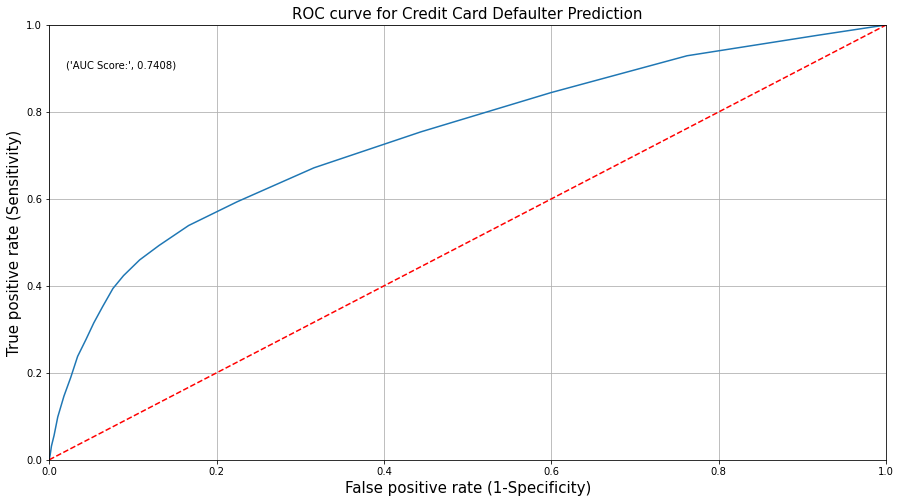

In [284]:
ypred_prob_tuned= tuned_knn.predict_proba(X_test_fe)[:,1]
fpr, tpr, thresholds = roc_curve(y_test_fe, ypred_prob_tuned)
plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.plot([0, 1], [0, 1],'r--')
plt.title('ROC curve for Credit Card Defaulter Prediction', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(y_test_fe, ypred_prob_tuned),4)))
plt.grid(True)

# Building Gaussian Naive Bais Model:-

In [285]:
from sklearn.naive_bayes import GaussianNB

In [286]:
gnb = GaussianNB()

In [287]:
gnb_model = gnb.fit(X_train_fe, y_train_fe)

In [288]:
ypred_fe = gnb_model.predict(X_test_fe)
print(classification_report(y_test_fe, ypred_fe))

              precision    recall  f1-score   support

           0       0.85      0.88      0.86      7040
           1       0.49      0.43      0.46      1960

    accuracy                           0.78      9000
   macro avg       0.67      0.65      0.66      9000
weighted avg       0.77      0.78      0.77      9000



Recall for positive class is 0.43, Precision for positive class is 0.49. Accuracy of model is 0.78 and F1-Score is 0.66.

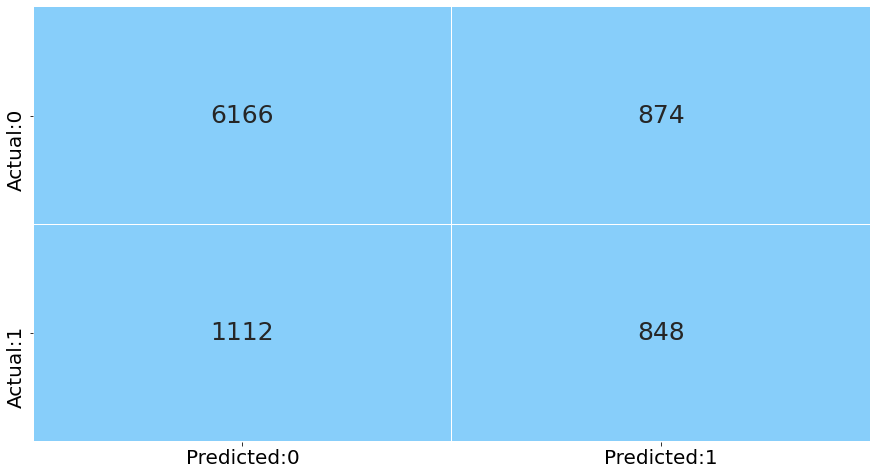

In [289]:
cm = confusion_matrix(y_test_fe, ypred_fe)
conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])
sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

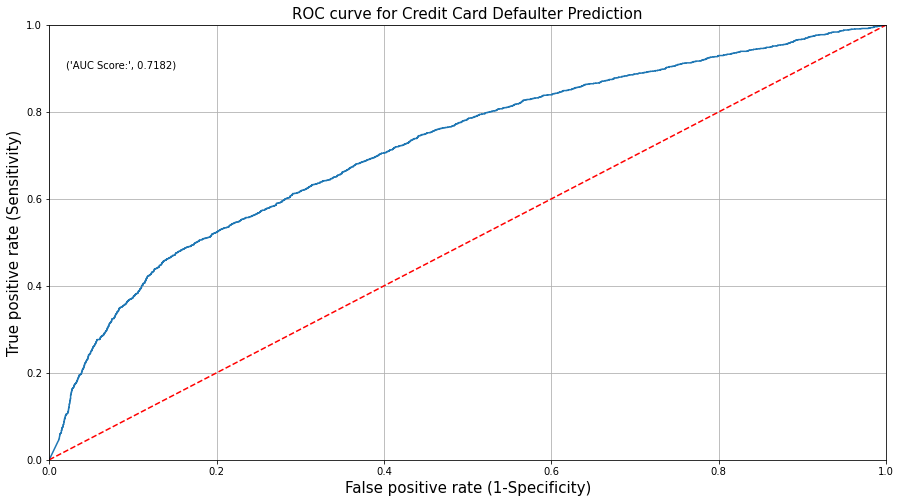

In [290]:
ypred_prob_fe= gnb_model.predict_proba(X_test_fe)[:,1]
fpr, tpr, thresholds = roc_curve(y_test_fe, ypred_prob_fe)
plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.plot([0, 1], [0, 1],'r--')
plt.title('ROC curve for Credit Card Defaulter Prediction', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(y_test_fe, ypred_prob_fe),4)))
plt.grid(True)

### Hyperparameter tuning for Gaussian Naive Bais Model:-

In [291]:
nb_classifier = GaussianNB()

In [292]:
tuned_parameters = {'var_smoothing': np.logspace(0,-9, num=100)}

gnb_grid = GridSearchCV(estimator=nb_classifier, 
                 param_grid=tuned_parameters,
                 cv=3,
                 verbose=1, 
                 scoring='accuracy',
                 n_jobs=-1) 

gnb_grid.fit(X_train_fe, y_train_fe)

print('Best parameters for KNN Classifier: ', gnb_grid.best_params_, '\n')

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Best parameters for KNN Classifier:  {'var_smoothing': 0.3511191734215131} 



In [293]:
gnb_grid_model = GaussianNB(var_smoothing = gnb_grid.best_params_['var_smoothing'])

In [294]:
tuned_gnb = gnb_grid_model.fit(X_train_fe, y_train_fe)

In [295]:
ypred_tuned = tuned_gnb.predict(X_test_fe)
print(classification_report(y_test_fe, ypred_tuned))

              precision    recall  f1-score   support

           0       0.82      0.96      0.88      7040
           1       0.63      0.22      0.32      1960

    accuracy                           0.80      9000
   macro avg       0.73      0.59      0.60      9000
weighted avg       0.78      0.80      0.76      9000



Recall for positive class is 0.22, Precision for positive class is 0.63. Accuracy of model is 0.80 and F1-Score is 0.60.

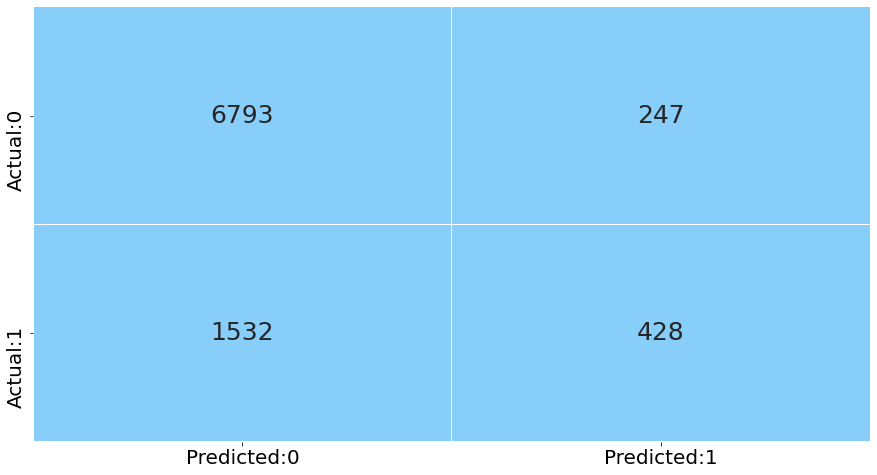

In [296]:
cm = confusion_matrix(y_test_fe, ypred_tuned)
conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])
sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

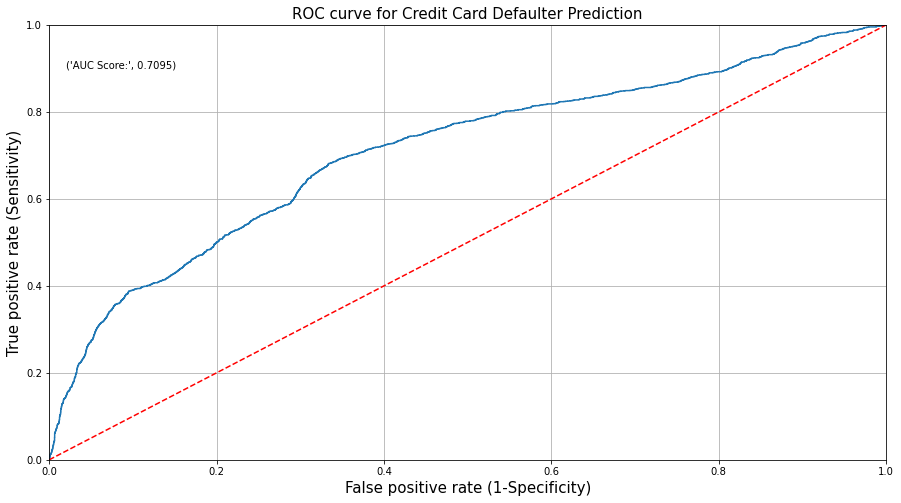

In [297]:
ypred_prob_fe= tuned_gnb.predict_proba(X_test_fe)[:,1]
fpr, tpr, thresholds = roc_curve(y_test_fe, ypred_prob_fe)
plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.plot([0, 1], [0, 1],'r--')
plt.title('ROC curve for Credit Card Defaulter Prediction', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(y_test_fe, ypred_prob_fe),4)))
plt.grid(True)

### Random Forest Model

In [298]:
rf_classification = RandomForestClassifier(n_estimators = 23, random_state = 42)

rf_model = rf_classification.fit(X_train_fe, y_train_fe)

In [299]:
ypred_fe = rf_model.predict(X_test_fe)
print(classification_report(y_test_fe, ypred_fe))

              precision    recall  f1-score   support

           0       0.83      0.93      0.88      7040
           1       0.58      0.34      0.42      1960

    accuracy                           0.80      9000
   macro avg       0.71      0.63      0.65      9000
weighted avg       0.78      0.80      0.78      9000



Recall for positive class is 0.34, Precision for positive class is 0.58. Accuracy of model is 0.80 and F1-Score is 0.65.

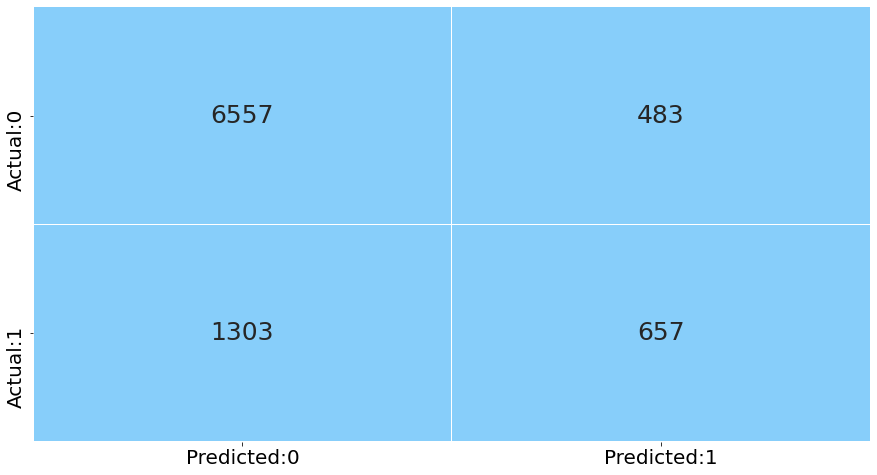

In [300]:
cm = confusion_matrix(y_test_fe, ypred_fe)
conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])
sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

Random forest is performing poorly as compared to the boosted models

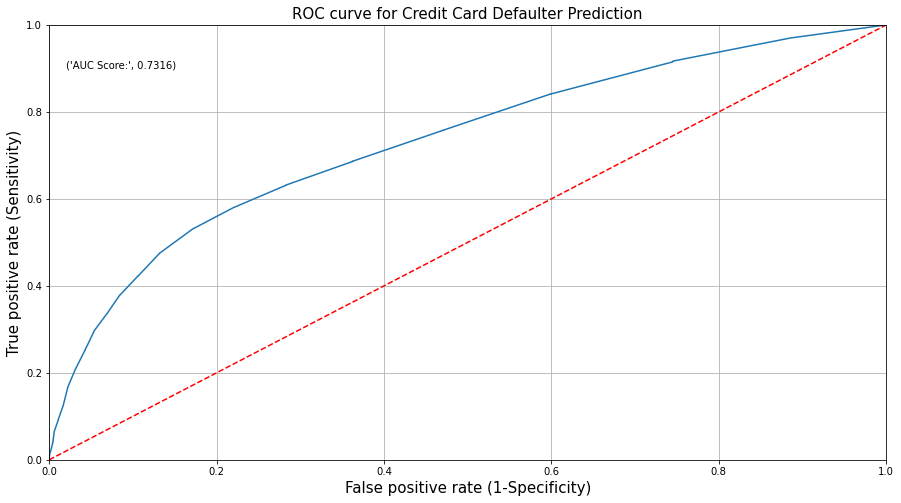

In [301]:
ypred_prob_fe= rf_model.predict_proba(X_test_fe)[:,1]
fpr, tpr, thresholds = roc_curve(y_test_fe, ypred_prob_fe)
plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.plot([0, 1], [0, 1],'r--')
plt.title('ROC curve for Credit Card Defaulter Prediction', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(y_test_fe, ypred_prob_fe),4)))
plt.grid(True)

The AUC score for this model has reduced compared to the previous model

### Hyperparameter Tuning Random Forest Model:-

In [302]:
tuned_paramaters = [{ # 'criterion': ['entropy', 'gini'], #***
                     'n_estimators': [10, 30, 50], #** 70, 90],
                     'max_depth': [10, 15, 20],
                     'max_features': ['sqrt', 'log2'],
                     'min_samples_split': [2, 5, 8, 11],
                     # 'min_samples_leaf': [1, 5, 9], # ***
                     # 'max_leaf_nodes': [2, 5, 8, 11] # *** 
                    }] 

In [303]:
random_forest_classification = RandomForestClassifier(random_state = 42)

In [304]:
rf_grid = GridSearchCV(estimator = random_forest_classification, 
                       param_grid = tuned_paramaters, 
                       cv = 3,n_jobs=-1)

In [305]:
rf_grid_model = rf_grid.fit(X_train_fe, y_train_fe)

In [306]:
print('Best parameters for random forest classifier: ', rf_grid_model.best_params_, '\n')

Best parameters for random forest classifier:  {'max_depth': 20, 'max_features': 'sqrt', 'min_samples_split': 11, 'n_estimators': 50} 



In [307]:
rf_model = RandomForestClassifier(# criterion = rf_grid_model.best_params_.get('criterion'), 
                                  n_estimators = rf_grid_model.best_params_.get('n_estimators'),
                                  max_depth = rf_grid_model.best_params_.get('max_depth'),
                                  max_features = rf_grid_model.best_params_.get('max_features'),
                                  # max_leaf_nodes = rf_grid_model.best_params_.get('max_leaf_nodes'),
                                  # min_samples_leaf = rf_grid_model.best_params_.get('min_samples_leaf'),
                                  min_samples_split = rf_grid_model.best_params_.get('min_samples_split'),
                                  random_state = 42)

In [308]:
tuned_rf = rf_model.fit(X_train_fe, y_train_fe)

In [309]:
ypred_tuned = tuned_rf.predict(X_test_fe)
print(classification_report(y_test_fe, ypred_tuned))

              precision    recall  f1-score   support

           0       0.84      0.94      0.89      7040
           1       0.61      0.34      0.44      1960

    accuracy                           0.81      9000
   macro avg       0.72      0.64      0.66      9000
weighted avg       0.79      0.81      0.79      9000



Recall for positive class is 0.34, Precision for positive class is 0.61. Accuracy of model is 0.81 and F1-Score is 0.66.

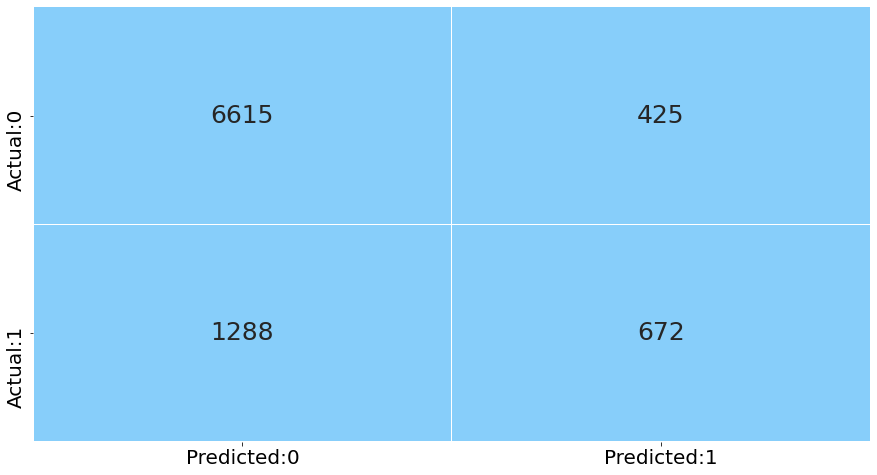

In [310]:
cm = confusion_matrix(y_test_fe, ypred_tuned)
conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])
sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

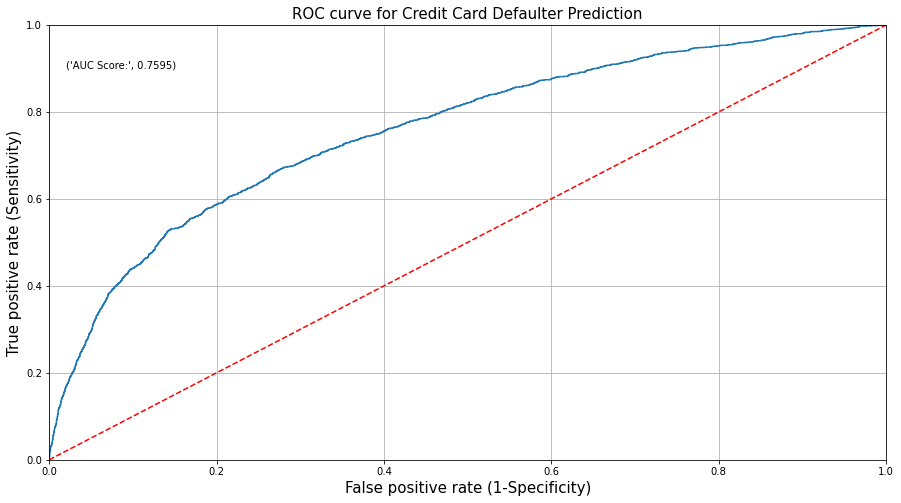

In [311]:
ypred_prob_tuned= tuned_rf.predict_proba(X_test_fe)[:,1]
fpr, tpr, thresholds = roc_curve(y_test_fe, ypred_prob_tuned)
plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.plot([0, 1], [0, 1],'r--')
plt.title('ROC curve for Credit Card Defaulter Prediction', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(y_test_fe, ypred_prob_tuned),4)))
plt.grid(True)

### Data Showing All Models with their Scores for selection of best Model:-

In [331]:
values=[[0.41,0.38,0.73,0.61,0.611],[0.41,0.37,0.72,0.60,0.607],[0.24,0.60,0.80,0.61,0.6952],[0.30,0.61,0.81,0.65,0.7631],[0.26,0.63,0.81,0.62,0.7145],[0.35,0.59,0.81,0.66,0.7528],[0.32,0.61,0.81,0.65,0.7721],[0.36,0.59,0.81,0.66,0.7467],[0.35,0.62,0.81,0.67,0.7742],[0.35,0.57,0.80,0.66,0.7138],[0.35,0.61,0.81,0.66,0.7408],[0.43,0.49,0.78,0.66,0.7182],[0.22,0.63,0.80,0.60,0.7095],[0.34,0.58,0.80,0.65,0.7316],[0.34,0.61,0.81,0.66,0.7595]]

In [332]:
a=np.array(values)
a

array([[0.41  , 0.38  , 0.73  , 0.61  , 0.611 ],
       [0.41  , 0.37  , 0.72  , 0.6   , 0.607 ],
       [0.24  , 0.6   , 0.8   , 0.61  , 0.6952],
       [0.3   , 0.61  , 0.81  , 0.65  , 0.7631],
       [0.26  , 0.63  , 0.81  , 0.62  , 0.7145],
       [0.35  , 0.59  , 0.81  , 0.66  , 0.7528],
       [0.32  , 0.61  , 0.81  , 0.65  , 0.7721],
       [0.36  , 0.59  , 0.81  , 0.66  , 0.7467],
       [0.35  , 0.62  , 0.81  , 0.67  , 0.7742],
       [0.35  , 0.57  , 0.8   , 0.66  , 0.7138],
       [0.35  , 0.61  , 0.81  , 0.66  , 0.7408],
       [0.43  , 0.49  , 0.78  , 0.66  , 0.7182],
       [0.22  , 0.63  , 0.8   , 0.6   , 0.7095],
       [0.34  , 0.58  , 0.8   , 0.65  , 0.7316],
       [0.34  , 0.61  , 0.81  , 0.66  , 0.7595]])

In [333]:
models=pd.DataFrame(a,columns=['+ve Class Recall','+ve Class Precision','Accuracy','F-1 Score','ROC-AUC Score'])
models

,+ve Class Recall,+ve Class Precision,Accuracy,F-1 Score,ROC-AUC Score
0,0.41,0.38,0.73,0.61,0.6110
1,0.41,0.37,0.72,0.60,0.6070
2,0.24,0.60,0.80,0.61,0.6952
3,0.30,0.61,0.81,0.65,0.7631
4,0.26,0.63,0.81,0.62,0.7145
5,0.35,0.59,0.81,0.66,0.7528
6,0.32,0.61,0.81,0.65,0.7721
7,0.36,0.59,0.81,0.66,0.7467
8,0.35,0.62,0.81,0.67,0.7742
9,0.35,0.57,0.80,0.66,0.7138


In [334]:
models=models.rename(index={0:'Decision Tree Base Model',1:'Decision Tree Feature Engineered',2:'Decision Tree Tuned',3:'ADA Boost',4:'ADA Boost Tuned',5:'Gradient Boost',6:'Gradient Boost Tuned',7:'XG Boost',8:'XG Boost Tuned',9:'KNN Model',10:'KNN Tuned Model',11:'Guassian Naive Bais Model',12:'Guassian Naive Bais Tuned Model',13:'Random Forest',14:'Random Forest Tuned'})
models

,+ve Class Recall,+ve Class Precision,Accuracy,F-1 Score,ROC-AUC Score
Decision Tree Base Model,0.41,0.38,0.73,0.61,0.6110
Decision Tree Feature Engineered,0.41,0.37,0.72,0.60,0.6070
Decision Tree Tuned,0.24,0.60,0.80,0.61,0.6952
ADA Boost,0.30,0.61,0.81,0.65,0.7631
ADA Boost Tuned,0.26,0.63,0.81,0.62,0.7145
Gradient Boost,0.35,0.59,0.81,0.66,0.7528
Gradient Boost Tuned,0.32,0.61,0.81,0.65,0.7721
XG Boost,0.36,0.59,0.81,0.66,0.7467
XG Boost Tuned,0.35,0.62,0.81,0.67,0.7742
KNN Model,0.35,0.57,0.80,0.66,0.7138


In [335]:
best_models=models.sort_values(by=['+ve Class Recall','+ve Class Precision'],ascending=[False,False])
best_models

,+ve Class Recall,+ve Class Precision,Accuracy,F-1 Score,ROC-AUC Score
Guassian Naive Bais Model,0.43,0.49,0.78,0.66,0.7182
Decision Tree Base Model,0.41,0.38,0.73,0.61,0.6110
Decision Tree Feature Engineered,0.41,0.37,0.72,0.60,0.6070
XG Boost,0.36,0.59,0.81,0.66,0.7467
XG Boost Tuned,0.35,0.62,0.81,0.67,0.7742
KNN Tuned Model,0.35,0.61,0.81,0.66,0.7408
Gradient Boost,0.35,0.59,0.81,0.66,0.7528
KNN Model,0.35,0.57,0.80,0.66,0.7138
Random Forest Tuned,0.34,0.61,0.81,0.66,0.7595
Random Forest,0.34,0.58,0.80,0.65,0.7316


In [355]:
# Best Models

best_model=best_models.head(4)
best_model

,+ve Class Recall,+ve Class Precision,Accuracy,F-1 Score,ROC-AUC Score
Guassian Naive Bais Model,0.43,0.49,0.78,0.66,0.7182
Decision Tree Base Model,0.41,0.38,0.73,0.61,0.6110
Decision Tree Feature Engineered,0.41,0.37,0.72,0.60,0.6070
XG Boost,0.36,0.59,0.81,0.66,0.7467


1. We built a total of 15 models using algorithms KNN, Gaussian Naive Bayes, Decision Tree, Random Forest, and boosting algorithms like XGBoost, ADABoost and Gradient Boosting.
2. We used techniques like transformation, hyperparameter tuning, Feature engineering, scaling, and advanced algorithms like boosting for enhancing model performance.
3. After observing all the models built after these techniques, we came to a conclusion that these techniques did not show any significant changes in terms of the chosen metric.
4. The primary metric for our project was chosen to be Recall for the positive class as it gives the ratio of the number of correct predictions for the positive class to the total number of observations in the positive class. 
5. It is important for the bank to correctly identify the customers who are more likely to default. If they are unable to correctly predict the defaulters, they are at a risk of losing money. Thus, Recall is an appropriate metric to look at for this dataset. 
6. According to this metric, the best performing model is Gaussian Naive Bayes Model. The recall score for this model is 0.43. The next best model is Decision Tree Base model (0.41), followed by Decision tree with Feature engineering (0.41) and XGBoost (0.36).

### Feature Importance for Decision Tree Model

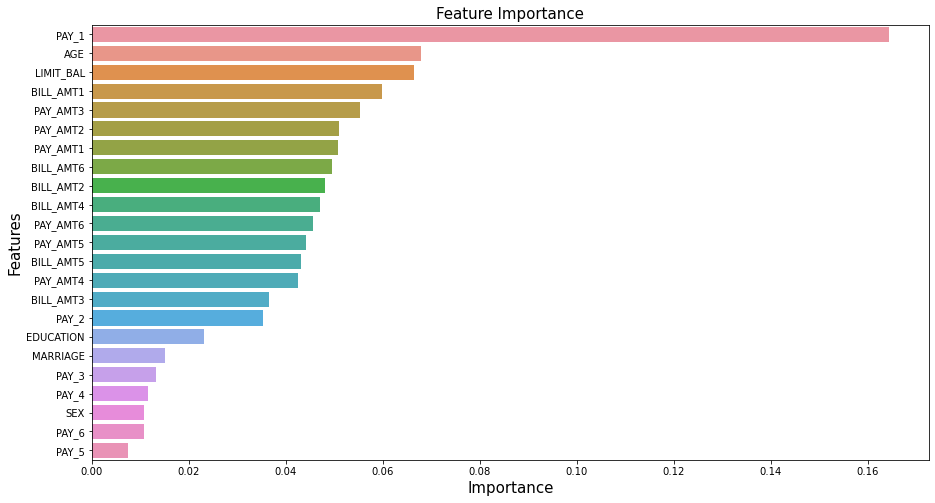

In [351]:
important_features = pd.DataFrame({'Features': Xtrain_orig_label.columns, 
                                   'Importance': decision_tree.feature_importances_})

# sort the dataframe in the descending order according to the feature importance
important_features = important_features.sort_values('Importance', ascending = False)

# create a barplot to visualize the features based on their importance
sns.barplot(x = 'Importance', y = 'Features', data = important_features)

# add plot and axes labels
# set text size using 'fontsize'
plt.title('Feature Importance', fontsize = 15)
plt.xlabel('Importance', fontsize = 15)
plt.ylabel('Features', fontsize = 15)

# display the plot
plt.show()

PAY_1, AGE, LIMIT_BAL, BILL_AMT1, PAY_AMT3, PAY_AMT2 are the top 6 features according to this model

### Feature Importance for Decision Tree Model Feature Engineered Dataframe:-

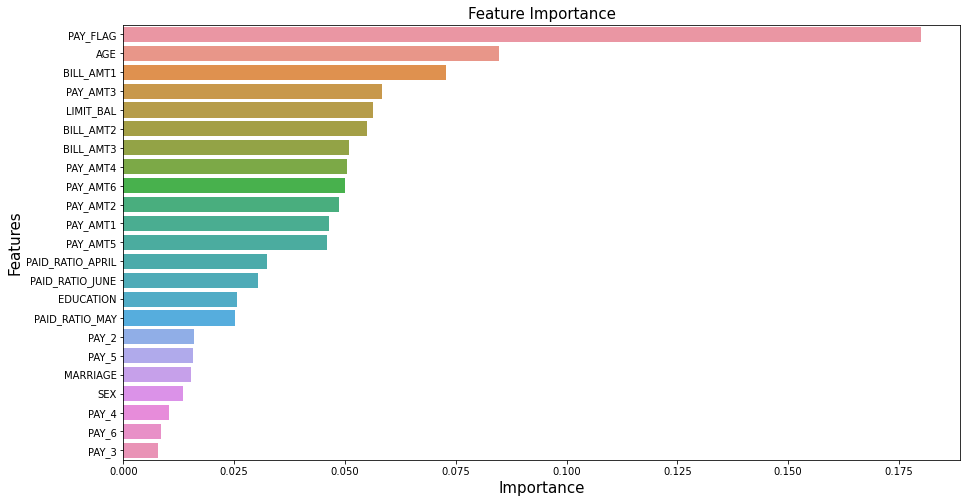

In [354]:
important_features = pd.DataFrame({'Features': X_train_fe.columns, 
                                   'Importance': decision_tree.feature_importances_})

# sort the dataframe in the descending order according to the feature importance
important_features = important_features.sort_values('Importance', ascending = False)

# create a barplot to visualize the features based on their importance
sns.barplot(x = 'Importance', y = 'Features', data = important_features)

# add plot and axes labels
# set text size using 'fontsize'
plt.title('Feature Importance', fontsize = 15)
plt.xlabel('Importance', fontsize = 15)
plt.ylabel('Features', fontsize = 15)

# display the plot
plt.show()

PAY_FLAG (new feature created from all PAY_X features), AGE, BILL_AMT1, PAY_AMT3, LIMIT_BAL, and BILL_AMT2 are the top 6 features according to this model.

### Feature Importance for XGBoost Model:-

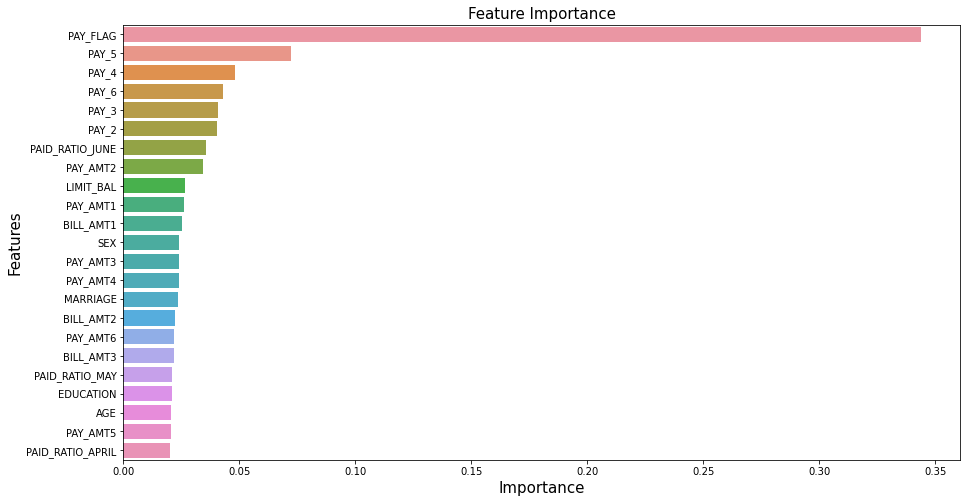

In [361]:
important_features = pd.DataFrame({'Features': X_train_fe.columns, 
                                   'Importance': xgb_grid_model.feature_importances_})

# sort the dataframe in the descending order according to the feature importance
important_features = important_features.sort_values('Importance', ascending = False)

# create a barplot to visualize the features based on their importance
sns.barplot(x = 'Importance', y = 'Features', data = important_features)

# add plot and axes labels
# set text size using 'fontsize'
plt.title('Feature Importance', fontsize = 15)
plt.xlabel('Importance', fontsize = 15)
plt.ylabel('Features', fontsize = 15)

# display the plot
plt.show()

PAY_FLAG, PAY_5, PAY_4, PAY_6, PAY_3, PAY_2 are the top 6 features according to this model.

**Business Insights:-**

1. When taking into consideration the above outcomes, we can see that the common top features for these models are PAY_X columns, LIMIT_BAL, AGE, BILL_AMT1, PAY_AMT3. 
2. Hence, these features are the ones that should be focused on to make business decisions, as these are the features that affect the probability of defaulting.

**Insights based on EDA:-** 

1. People with higher educational qualifications are less likely to default.
2. People with higher educational qualifications have a higher limit balance as they are less likely to default.
3. Married customers are also allowed higher limit balance.
4. Single customers are the largest users of revolving credits.
5. Female customers pay their bills on time compared to males.

**Conclusion:-**

From the above, we can conclude that married customers with higher educational qualifications are the safest customers, as they are less likely to default and they make their full payments on time.

### Building Model after handling target class imbalance

In [393]:
from imblearn.over_sampling import SMOTE

In [394]:
X = df.drop(['default.payment.next.month'],axis=1)
y= df['default.payment.next.month']
sm = SMOTE()
X,y = sm.fit_resample(X,y)
Xtrain, Xtest, ytrain, ytest= train_test_split(X,y,test_size=0.30,random_state=42)

In [395]:
decision_best = DecisionTreeClassifier()

decision_best = decision_best.fit(Xtrain, ytrain)

In [396]:
ypred = decision_best.predict(Xtest)
print(classification_report(ytest, ypred))

              precision    recall  f1-score   support

           0       0.78      0.76      0.77      7005
           1       0.77      0.79      0.78      7014

    accuracy                           0.77     14019
   macro avg       0.77      0.77      0.77     14019
weighted avg       0.77      0.77      0.77     14019



1. Recall for positive class is 0.79, Precision for positive class is 0.77. Accuracy of model is 0.77 and F1-Score is 0.77.
2. However, SMOTE is not idealistic in real world scenario as it is hard to find sample with balanced target classes.
3. We would essentially require more data from population to have more accurate results, as shown by the SMOTE.

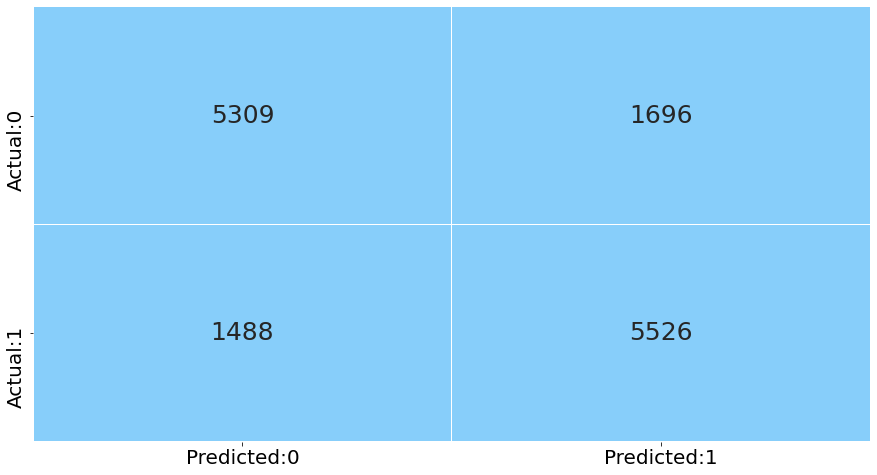

In [397]:
cm = confusion_matrix(ytest, ypred)
conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])
sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

**Limitations:-**

Data contains a lot of anomalies like outliers. However, we could not drop them as they are representative of real world scenarios and the model should be able to make predictions for such “outliers” as well.
The recall for our final model is on the lower end, indicating that our model has potential for improvement.
The techniques used for improving model performance did not have a significant impact on model performance.
